In [1]:
import pandas as pd
import numpy as np
import lightgbm as lgb
import numpy as np
import matplotlib.pyplot as plt
import torchvision
import torch
import pandas as pd
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.optim as optim
import time
import csv
import numpy as np
import math

In [20]:
is_cuda = True if torch.cuda.is_available() else False

In [48]:
df_train = pd.read_csv("df_train.csv")
df_test = pd.read_csv("df_test.csv")
print(df_train.dtypes)

Unnamed: 0                    int64
uid                           int64
age_group                     int64
gender                        int64
city                          int64
prodName                      int64
ramCapacity                 float64
ramLeftRation               float64
romCapacity                 float64
romLeftRation               float64
color                         int64
fontSize                    float64
ct                            int64
carrier                       int64
os                            int64
bootTimes                     int64
AFuncTimes                  float64
BFuncTimes                  float64
CFuncTimes                  float64
DFuncTimes                  float64
EFuncTimes                  float64
FFuncTimes                  float64
FFuncSum                      int64
appId                         int64
usage_cnt                   float64
usage_appid_cnt             float64
usage_date_cnt              float64
duration_mean               

In [49]:
print(df_test.dtypes)

Unnamed: 0                    int64
uid                           int64
gender                        int64
city                          int64
prodName                      int64
ramCapacity                 float64
ramLeftRation               float64
romCapacity                 float64
romLeftRation               float64
color                         int64
fontSize                    float64
ct                            int64
carrier                       int64
os                            int64
bootTimes                     int64
AFuncTimes                  float64
BFuncTimes                  float64
CFuncTimes                  float64
DFuncTimes                  float64
EFuncTimes                  float64
FFuncTimes                  float64
FFuncSum                      int64
appId                         int64
usage_cnt                   float64
usage_appid_cnt             float64
usage_date_cnt              float64
duration_mean               float64
duration_max                

In [4]:
class PointDataset(Dataset):
    def __init__(self, df, transform=None, train=True):
        '''
        Args:
            csv_file(string): path of label file
            transform (callable, optional): Optional transform to be applied
                on a sample.
        '''
        self.dataframe = df
        print(self.dataframe.dtypes)
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        x = self.dataframe.iloc[idx, 3:35]
        x = x.astype('float')
        x = (x - x.mean()) / (x.std())
        #print(x)
        point = np.array(x)
        label = int(self.dataframe.iloc[idx, 2])
        label = label - 1
        if self.transform is not None:
            point = self.transform(point)
        sample = {'point': point, 'label': label}
        return sample

In [5]:
class BaseRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(BaseRNN, self).__init__()

        self.hidden_size = hidden_size

        # input to hidden
        self.i2h = nn.Linear(input_size,  hidden_size)
        # hidden to hidden
        self.h2h = nn.Linear(hidden_size, hidden_size)
        #############################################
        #
        #  Change your activation function here
        #
        #############################################
        self.activation = nn.ReLU()
        # hidden to output
        self.h2o = nn.Linear(hidden_size, output_size)
        
    def step(self, letter, hidden):
        i2h = self.i2h(letter)
        h2h = self.h2h(hidden)
        hidden = self.activation( h2h+i2h )
        
        output = self.h2o(hidden)
        return output, hidden
    
    def forward(self, word):
        hidden = self.initHidden(is_cuda)
        for i in range(word.size()[0]):
            # Only the last output will be used to predict
            output, hidden = self.step(word[i], hidden)
        return output
    
    def initHidden(self, is_cuda=True):
        if is_cuda:
            return torch.zeros(1, self.hidden_size).cuda()
        else:
            return torch.zeros(1, self.hidden_size)

In [6]:
class DeeperRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(DeeperRNN, self).__init__()
        self.hidden1_size = hidden_size
        self.hidden2_size = hidden_size
        self.layer1 = BaseRNN(input_size, hidden_size, hidden_size)
        self.layer2 = BaseRNN(hidden_size, hidden_size, output_size)
        
    def step(self, letter, hidden1, hidden2):
        ############################################################
        
        # complete this function
        
        ############################################################
        hidden1 = self.layer1(letter)
        hidden2 = self.layer2(hidden1)
        output2 = hidden2
        return output2, hidden1, hidden2
    
    def forward(self, word):
        ############################################################
        
        # complete this function
        
        ############################################################
        hidden1 = self.initHidden(is_cuda)
        hidden2 = self.initHidden(is_cuda)
        for i in range(word.size()[0]):
            # Only the last output will be used to predict
            output, hidden1, hidden2 = self.step(word[i], hidden1, hidden2)
        return output

        
    def initHidden(self, is_cuda=True):
        if is_cuda:
            return torch.zeros(1, self.hidden1_size).cuda(), torch.zeros(1, self.hidden2_size).cuda()
        else:
            return torch.zeros(1, self.hidden1_size), torch.zeros(1, self.hidden2_size)

In [7]:
def predict(classifier_net, testloader, device):
#     correct = [0 for i in range(3)]
#     total = [0 for i in range(3)]
    correct = 0
    total = 0
    
    with torch.no_grad():
        '''
        you can also stop autograd from tracking history on Tensors with .requires_grad=True 
        by wrapping the code block in with torch.no_grad():
        '''
        for data in testloader:
            point, label = data['point'], data['label']
            point, label = point.to(device).to(torch.float32), label.to(device)
            outputs = classifier_net(point)
            '''
            if you want to get probability of the model prediction,
            you can use softmax function here to transform outputs to probability.
            '''
            # transform the prediction to one-hot form
            _, predicted = torch.max(outputs, 1)
            print('model prediction: ', predicted)
            print('ground truth:', label, '\n')
            correct += (predicted == label).sum()
            total += label.size(0)
            print('current correct is:', correct.item())
            print('current total is:', total)
            
        print('the accuracy of the model is {0:5f}'.format(correct.item()/total))
        
    return correct.item() / total

In [8]:
def clip_gradient(optimizer, grad_clip):
    """
    Clips gradients computed during backpropagation to avoid explosion of gradients.

    :param optimizer: optimizer with the gradients to be clipped
    :param grad_clip: clip value
    """
    for group in optimizer.param_groups:
        for param in group["params"]:
            if param.grad is not None:
                param.grad.data.clamp_(-grad_clip, grad_clip)

In [9]:
def show_running_loss(running_loss):
    # generate x value
    x = np.array([i for i in range(len(running_loss))])
    # generate y value
    y = np.array(running_loss)
    # define a graph
    plt.figure()
    # generate curve
    plt.plot(x, y, c='b')
    # show axis
    plt.axis()
    # define title
    plt.title('loss curve:')
    #define the name of x axis
    plt.xlabel('step')
    plt.ylabel('loss value')
    # show graph
    plt.show()

In [10]:
def predict(classifier_net, testloader, device):
#     correct = [0 for i in range(3)]
#     total = [0 for i in range(3)]
    correct = 0
    total = 0
    
    with torch.no_grad():
        '''
        you can also stop autograd from tracking history on Tensors with .requires_grad=True 
        by wrapping the code block in with torch.no_grad():
        '''
        for data in testloader:
            point, label = data['point'], data['label']
            point, label = point.to(device).to(torch.float32), label.to(device)
            outputs = classifier_net(point)
            '''
            if you want to get probability of the model prediction,
            you can use softmax function here to transform outputs to probability.
            '''
            # transform the prediction to one-hot form
            _, predicted = torch.max(outputs, 1)
            print('model prediction: ', predicted)
            print('ground truth:', label, '\n')
            correct += (predicted == label).sum()
            total += label.size(0)
            print('current correct is:', correct.item())
            print('current total is:', total)
            
        print('the accuracy of the model is {0:5f}'.format(correct.item()/total))
        
    return correct.item() / total

In [11]:
def show_accuracy(running_accuracy):
    x = np.array([i for i in range(len(running_accuracy))])
    y = np.array(running_accuracy)
    plt.figure()
    plt.plot(x, y, c='b')
    plt.axis()
    plt.title('accuracy curve:')
    plt.xlabel('step')
    plt.ylabel('accuracy value')
    plt.show()

In [50]:
def train(classifier_net, trainloader, trainframe, device, lr, optimizer):
    '''
    Args:
        classifier_net(nn.model): train model
        trainloader(torch.utils.data.DateLoader): train loader
        testloader(torch.utils.data.DateLoader): test loader
        device(torch.device): the evironment your model training
        LR(float): learning rate
    '''
    # loss function
    criterion = nn.CrossEntropyLoss().to(device)
    
    optimizer = optimizer
    
    # save the mean value of loss in an epoch
    running_loss = []
    
    running_accuracy = []
    
    # count loss in an epoch 
    temp_loss = 0.0
    
    # count the iteration number in an epoch
    iteration = 0 

    for epoch in range(epoches):
        
        '''
        adjust learning rate when you are training the model
        '''
        
        # adjust learning rate
        if epoch % 20 == 0 and epoch != 0:
            LR = LR * 0.5
            for param_group in optimizer.param_groups:
                param_group['lr'] = LR

        for i, data in enumerate(trainloader):
            point, label = data['point'], data['label']
            point, label = point.to(device).to(torch.float32), label.to(device)
            outputs = classifier_net(point)
            
            
            optimizer.zero_grad()
            loss = criterion(outputs, label)
            #if loss > 0.0 and loss < 2.0:
            loss.backward()
            
            
            if grad_clip is not None:
                clip_gradient(optimizer, grad_clip)
                
            for p in classifier_net.parameters():
                if hasattr(p.grad, "data"):
                    p.data.add_(-lr, p.grad.data)
            temp_loss += loss.item()
            iteration +=1 
            if iteration % 1000 == 0:
                print('[{0:d},{1:5.0f}] loss {2:.5f}'.format(epoch + 1, i, loss.item()))
            #time.sleep(1)
            #for parameters in classifier_net.parameters():
                #print(parameters)
        running_loss.append(temp_loss / iteration)
        temp_loss = 0
        iteration = 0
        print('test {}:----------------------------------------------------------------'.format(epoch))
        
        # call test function and return accuracy
        vali = trainframe.sample(n=20000, replace=False, axis=0)
        valiset = PointDataset(vali, torch.tensor)
        testloader = DataLoader(dataset=valiset, batch_size=1, shuffle=False)
        running_accuracy.append(predict(classifier_net, testloader, device))
        torch.save(classifier_net, './rnn.pt')
    
    # show loss curve
    show_running_loss(running_loss)
    
    # show accuracy curve
    show_accuracy(running_accuracy)
    
    return classifier_net

In [51]:
batch_size = 1
transform = torch.tensor
device = torch.device('cuda:0')
trainset = PointDataset(df_train, transform=transform)

trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True)

Unnamed: 0                    int64
uid                           int64
age_group                     int64
gender                        int64
city                          int64
prodName                      int64
ramCapacity                 float64
ramLeftRation               float64
romCapacity                 float64
romLeftRation               float64
color                         int64
fontSize                    float64
ct                            int64
carrier                       int64
os                            int64
bootTimes                     int64
AFuncTimes                  float64
BFuncTimes                  float64
CFuncTimes                  float64
DFuncTimes                  float64
EFuncTimes                  float64
FFuncTimes                  float64
FFuncSum                      int64
appId                         int64
usage_cnt                   float64
usage_appid_cnt             float64
usage_date_cnt              float64
duration_mean               

In [28]:
verifyset = PointDataset(df_vali, transform=transform)
testloader = DataLoader(dataset=verifyset, batch_size=batch_size, shuffle=False)

NameError: name 'df_vali' is not defined

In [35]:
classifier_net = BaseRNN(32, 256, 6).to(device)
for parameters in classifier_net.parameters():
                print(parameters)

Parameter containing:
tensor([[ 0.1457,  0.0820, -0.1074,  ...,  0.0039,  0.1588,  0.1548],
        [-0.1105, -0.1621,  0.0882,  ..., -0.0579, -0.0765, -0.1451],
        [-0.1504, -0.1354,  0.1588,  ...,  0.0312,  0.0327, -0.0822],
        ...,
        [-0.1651,  0.0827,  0.0221,  ..., -0.0326,  0.1619, -0.1388],
        [-0.0373, -0.0489, -0.0629,  ..., -0.0310,  0.1433, -0.0103],
        [ 0.1664, -0.0903,  0.1039,  ...,  0.1574,  0.0818, -0.1144]],
       device='cuda:0', requires_grad=True)
Parameter containing:
tensor([ 0.1142, -0.1294, -0.1110,  0.0560,  0.1613, -0.0479, -0.1589,  0.0967,
         0.0428,  0.1015, -0.1701,  0.1287,  0.0853, -0.0531,  0.1032,  0.1324,
        -0.0367, -0.0783, -0.0051, -0.1451,  0.1026, -0.1646,  0.0881, -0.1269,
        -0.1337,  0.1718, -0.0995,  0.1488, -0.0575, -0.0565, -0.1463, -0.1413,
         0.0587,  0.1226,  0.0716,  0.1493,  0.1351, -0.0213, -0.0690, -0.0193,
        -0.0745, -0.1665,  0.0529,  0.1390, -0.0405, -0.0411,  0.1358, -0.0954

In [52]:
lr = 1e-4
device = torch.device('cuda:0')
optimizer = optim.SGD(classifier_net.parameters(), lr=lr, momentum=0.9)
optimizeradam = optim.Adam(classifier_net.parameters(), lr=lr, betas=(0.9, 0.99))
optimizerrprop = optim.RMSprop(classifier_net.parameters(), lr=lr, alpha=0.9)

In [53]:
epoches = 10
grad_clip = 5

classifier_net.to(device)

BaseRNN(
  (i2h): Linear(in_features=32, out_features=256, bias=True)
  (h2h): Linear(in_features=256, out_features=256, bias=True)
  (activation): ReLU()
  (h2o): Linear(in_features=256, out_features=6, bias=True)
)

[1,  999] loss 2.58242
[1, 1999] loss 1.28149
[1, 2999] loss 2.58327
[1, 3999] loss 1.88910
[1, 4999] loss 1.28722
[1, 5999] loss 1.29138
[1, 6999] loss 1.87397
[1, 7999] loss 1.29846
[1, 8999] loss 2.58546
[1, 9999] loss 1.68796
[1,10999] loss 1.69050
[1,11999] loss 1.30825
[1,12999] loss 1.28285
[1,13999] loss 1.27974
[1,14999] loss 1.31686
[1,15999] loss 3.31290
[1,16999] loss 1.82688
[1,17999] loss 1.27367
[1,18999] loss 1.27076
[1,19999] loss 1.27134
[1,20999] loss 1.81339
[1,21999] loss 1.81014
[1,22999] loss 3.31290
[1,23999] loss 1.27075
[1,24999] loss 1.32932
[1,25999] loss 1.26892
[1,26999] loss 1.33108
[1,27999] loss 1.33261
[1,28999] loss 1.33286
[1,29999] loss 1.74437
[1,30999] loss 2.57990
[1,31999] loss 1.33879
[1,32999] loss 1.25732
[1,33999] loss 1.25642
[1,34999] loss 1.25436
[1,35999] loss 1.34804
[1,36999] loss 1.76323
[1,37999] loss 1.25338
[1,38999] loss 3.32534
[1,39999] loss 1.35270
[1,40999] loss 1.77166
[1,41999] loss 1.25017
[1,42999] loss 1.24947
[1,43999] l

[1,686999] loss 2.59600
[1,687999] loss 1.39234
[1,688999] loss 1.39492
[1,689999] loss 3.50493
[1,690999] loss 1.61726
[1,691999] loss 1.20515
[1,692999] loss 1.61817
[1,693999] loss 1.90342
[1,694999] loss 1.90216
[1,695999] loss 1.20618
[1,696999] loss 2.60304
[1,697999] loss 1.61346
[1,698999] loss 1.61386
[1,699999] loss 1.20859
[1,700999] loss 1.38995
[1,701999] loss 1.20894
[1,702999] loss 2.59985
[1,703999] loss 1.20727
[1,704999] loss 1.20866
[1,705999] loss 1.39084
[1,706999] loss 1.21083
[1,707999] loss 1.39301
[1,708999] loss 1.90547
[1,709999] loss 2.59958
[1,710999] loss 1.20883
[1,711999] loss 1.90301
[1,712999] loss 1.39669
[1,713999] loss 1.39493
[1,714999] loss 1.60756
[1,715999] loss 1.21167
[1,716999] loss 1.21133
[1,717999] loss 2.60231
[1,718999] loss 1.60947
[1,719999] loss 2.60296
[1,720999] loss 1.90497
[1,721999] loss 1.20981
[1,722999] loss 1.90333
[1,723999] loss 1.60625
[1,724999] loss 1.39003
[1,725999] loss 1.38713
[1,726999] loss 2.60330
[1,727999] loss 

[1,1353999] loss 1.20241
[1,1354999] loss 3.49744
[1,1355999] loss 1.20012
[1,1356999] loss 1.89913
[1,1357999] loss 1.20251
[1,1358999] loss 1.39213
[1,1359999] loss 1.20411
[1,1360999] loss 1.89864
[1,1361999] loss 1.20633
[1,1362999] loss 1.61909
[1,1363999] loss 1.20315
[1,1364999] loss 1.20221
[1,1365999] loss 1.89859
[1,1366999] loss 1.19936
[1,1367999] loss 1.19808
[1,1368999] loss 1.40179
[1,1369999] loss 1.40220
[1,1370999] loss 2.60264
[1,1371999] loss 1.61879
[1,1372999] loss 1.62003
[1,1373999] loss 1.19462
[1,1374999] loss 1.19513
[1,1375999] loss 1.62023
[1,1376999] loss 1.39892
[1,1377999] loss 1.39973
[1,1378999] loss 2.60185
[1,1379999] loss 1.40222
[1,1380999] loss 2.60111
[1,1381999] loss 1.40020
[1,1382999] loss 2.60074
[1,1383999] loss 1.39855
[1,1384999] loss 1.61528
[1,1385999] loss 1.39724
[1,1386999] loss 1.20047
[1,1387999] loss 1.39740
[1,1388999] loss 1.39550
[1,1389999] loss 1.39487
[1,1390999] loss 1.61621
[1,1391999] loss 1.39557
[1,1392999] loss 1.89996


[1,2007999] loss 1.39570
[1,2008999] loss 1.20187
[1,2009999] loss 1.90300
test 0:----------------------------------------------------------------
Unnamed: 0                    int64
uid                           int64
age_group                     int64
gender                        int64
city                          int64
prodName                      int64
ramCapacity                 float64
ramLeftRation               float64
romCapacity                 float64
romLeftRation               float64
color                         int64
fontSize                    float64
ct                            int64
carrier                       int64
os                            int64
bootTimes                     int64
AFuncTimes                  float64
BFuncTimes                  float64
CFuncTimes                  float64
DFuncTimes                  float64
EFuncTimes                  float64
FFuncTimes                  float64
FFuncSum                      int64
appId                    

ground truth: tensor([3], device='cuda:0') 

current correct is: 35
current total is: 110
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 36
current total is: 111
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 36
current total is: 112
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 37
current total is: 113
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 38
current total is: 114
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 38
current total is: 115
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 39
current total is: 116
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 81
current total is: 229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 81
current total is: 230
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 81
current total is: 231
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 82
current total is: 232
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 82
current total is: 233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 82
current total is: 234
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 82
current total is: 235
model prediction:  tensor([2], dev

ground truth: tensor([2], device='cuda:0') 

current correct is: 109
current total is: 347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 109
current total is: 348
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 109
current total is: 349
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 109
current total is: 350
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 110
current total is: 351
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 110
current total is: 352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 111
current total is: 353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], d

current total is: 464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 144
current total is: 465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 144
current total is: 466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 145
current total is: 467
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 145
current total is: 468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 145
current total is: 469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 146
current total is: 470
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 147
current total is: 471
model

ground truth: tensor([0], device='cuda:0') 

current correct is: 185
current total is: 582
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 185
current total is: 583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 186
current total is: 584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 186
current total is: 585
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 186
current total is: 586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 186
current total is: 587
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 187
current total is: 588
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], d

current total is: 699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 222
current total is: 700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 222
current total is: 701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 222
current total is: 702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 223
current total is: 703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 223
current total is: 704
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 224
current total is: 705
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 224
current total is: 706
model

ground truth: tensor([3], device='cuda:0') 

current correct is: 258
current total is: 856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 258
current total is: 857
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 259
current total is: 858
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 259
current total is: 859
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 259
current total is: 860
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 259
current total is: 861
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 260
current total is: 862
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 309
current total is: 1040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 309
current total is: 1041
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 309
current total is: 1042
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 309
current total is: 1043
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 310
current total is: 1044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 311
current total is: 1045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 311
current total is: 1046
model prediction:  t

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 359
current total is: 1221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 360
current total is: 1222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 360
current total is: 1223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 360
current total is: 1224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 361
current total is: 1225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 361
current total is: 1226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 361
current total is: 1227
model prediction:  t

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 414
current total is: 1397
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 415
current total is: 1398
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 415
current total is: 1399
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 415
current total is: 1400
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 416
current total is: 1401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 417
current total is: 1402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 417
current total is: 1403
model prediction:  t

current total is: 1539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 458
current total is: 1540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 459
current total is: 1541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 460
current total is: 1542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 460
current total is: 1543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 460
current total is: 1544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 461
current total is: 1545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 461
current total is: 15

ground truth: tensor([2], device='cuda:0') 

current correct is: 513
current total is: 1709
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 513
current total is: 1710
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 514
current total is: 1711
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 514
current total is: 1712
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 514
current total is: 1713
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 514
current total is: 1714
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 514
current total is: 1715
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

current total is: 1875
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 566
current total is: 1876
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 567
current total is: 1877
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 567
current total is: 1878
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 567
current total is: 1879
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 567
current total is: 1880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 567
current total is: 1881
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 567
current total is: 18

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 606
current total is: 2045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 606
current total is: 2046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 607
current total is: 2047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 608
current total is: 2048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 608
current total is: 2049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 609
current total is: 2050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 609
current total is: 2051
model prediction:  t

ground truth: tensor([5], device='cuda:0') 

current correct is: 652
current total is: 2221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 652
current total is: 2222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 653
current total is: 2223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 653
current total is: 2224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 653
current total is: 2225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 653
current total is: 2226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 653
current total is: 2227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

current correct is: 676
current total is: 2303
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 676
current total is: 2304
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 677
current total is: 2305
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 677
current total is: 2306
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 678
current total is: 2307
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 679
current total is: 2308
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 679
current total is: 2309
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 

current correct is: 699
current total is: 2388
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 699
current total is: 2389
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 699
current total is: 2390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 699
current total is: 2391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 699
current total is: 2392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 700
current total is: 2393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 700
current total is: 2394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 742
current total is: 2550
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 743
current total is: 2551
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 743
current total is: 2552
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 744
current total is: 2553
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 744
current total is: 2554
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 745
current total is: 2555
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 746
current total is: 2556
model prediction:  t

ground truth: tensor([2], device='cuda:0') 

current correct is: 818
current total is: 2775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 818
current total is: 2776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 819
current total is: 2777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 820
current total is: 2778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 821
current total is: 2779
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 821
current total is: 2780
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') current correct is: 830
current total is: 2805
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 882
current total is: 2973
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 883
current total is: 2974
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 883
current total is: 2975
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 883
current total is: 2976
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 883
current total is: 2977
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 884
current total is: 2978
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 932
current total is: 3126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 932
current total is: 3127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 932
current total is: 3128
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 932
current total is: 3129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 932
current total is: 3130
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 932
current total is: 3131
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 932
current total is: 3132
model prediction:  t

ground truth: tensor([4], device='cuda:0') 

current correct is: 985
current total is: 3305
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 985
current total is: 3306
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 985
current total is: 3307
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 985
current total is: 3308
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 985
current total is: 3309
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 985
current total is: 3310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 985
current total is: 3311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1041
current total is: 3480
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1041
current total is: 3481
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1042
current total is: 3482
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1042
current total is: 3483
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1042
current total is: 3484
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1042
current total is: 3485
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1042
current total is: 3486
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1082
current total is: 3651
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1082
current total is: 3652
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1083
current total is: 3653
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1083
current total is: 3654
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1084
current total is: 3655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1084
current total is: 3656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1085
current total is: 3657
model predict

ground truth: tensor([0], device='cuda:0') 

current correct is: 1142
current total is: 3828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1143
current total is: 3829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1144
current total is: 3830
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1144
current total is: 3831
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1144
current total is: 3832
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1144
current total is: 3833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1144
current total is: 3834
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1197
current total is: 4000
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1197
current total is: 4001
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1197
current total is: 4002
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1197
current total is: 4003
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1197
current total is: 4004
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1197
current total is: 4005
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1197
current total is: 4006
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1248
current total is: 4167
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1248
current total is: 4168
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1248
current total is: 4169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1248
current total is: 4170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1248
current total is: 4171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1248
current total is: 4172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1248
current total is: 4173
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1294
current total is: 4342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1294
current total is: 4343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1295
current total is: 4344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1295
current total is: 4345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1296
current total is: 4346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1297
current total is: 4347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1298
current total is: 4348
model predict

ground truth: tensor([5], device='cuda:0') 

current correct is: 1357
current total is: 4552
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1358
current total is: 4553
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1358
current total is: 4554
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1358
current total is: 4555
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1359
current total is: 4556
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1360
current total is: 4557
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1360
current total is: 4558
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([1], device='cuda:0') 

current correct is: 1419
current total is: 4760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1419
current total is: 4761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1420
current total is: 4762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1420
current total is: 4763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1421
current total is: 4764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1421
current total is: 4765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1421
current total is: 4766
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([3], device='cuda:0') 

current correct is: 1456
current total is: 4925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1456
current total is: 4926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1456
current total is: 4927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1456
current total is: 4928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1456
current total is: 4929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1456
current total is: 4930
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1456
current total is: 4931
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 1495
current total is: 5086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1495
current total is: 5087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1495
current total is: 5088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1496
current total is: 5089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1497
current total is: 5090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1497
current total is: 5091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1497
current total is: 5092
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current corre

current total is: 5251
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1539
current total is: 5252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1539
current total is: 5253
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1540
current total is: 5254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1540
current total is: 5255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1541
current total is: 5256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1541
current total is: 5257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1541
current total

current total is: 5438
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1594
current total is: 5439
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1595
current total is: 5440
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1595
current total is: 5441
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1596
current total is: 5442
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1597
current total is: 5443
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1598
current total is: 5444
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1598
current total

ground truth: tensor([3], device='cuda:0') 

current correct is: 1653
current total is: 5615
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1653
current total is: 5616
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1653
current total is: 5617
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1653
current total is: 5618
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1654
current total is: 5619
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1654
current total is: 5620
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1654
current total is: 5621
model prediction:  tensor([2], device='cuda:0')
ground truth:

current total is: 5770
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1698
current total is: 5771
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1698
current total is: 5772
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1698
current total is: 5773
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1698
current total is: 5774
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1698
current total is: 5775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1698
current total is: 5776
model prediction:  current total is: 5794
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0'

current correct is: 1742
current total is: 5927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1742
current total is: 5928
model prediction:  model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1758
current total is: 5968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1759
current total is: 5969
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1759
current total is: 5970
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1760
current total is: 5971
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1761
current total is: 5972
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:

current correct is: 1822
current total is: 6202
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1823
current total is: 6203
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1824
current total is: 6204
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1824
current total is: 6205
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1824
current total is: 6206
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1824
current total is: 6207
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1824
current total is: 6208
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1890
current total is: 6413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1891
current total is: 6414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1892
current total is: 6415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1893
current total is: 6416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1893
current total is: 6417
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1894
current total is: 6418
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1894
current total is: 6419
model predict

current total is: 6576
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1934
current total is: 6577
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1934
current total is: 6578
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1934
current total is: 6579
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1935
current total is: 6580
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1936
current total is: 6581
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1936
current total is: 6582
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1936
current total

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 2016
current total is: 6845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2016
current total is: 6846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2016
current total is: 6847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2016
current total is: 6848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2017
current total is: 6849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2017
current total is: 6850
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2017
current total is: 6851
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

ground truth: tensor([2], device='cuda:0') 

current correct is: 2069
current total is: 7031
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2069
current total is: 7032
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2069
current total is: 7033
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2069
current total is: 7034
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2070
current total is: 7035
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2071
current total is: 7036
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2071
current total is: 7037
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2119
current total is: 7186
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2119
current total is: 7187
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2119
current total is: 7188
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2120
current total is: 7189
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2120
current total is: 7190
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2120
current total is: 7191
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2120
current total is: 7192
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2171
current total is: 7350
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2171
current total is: 7351
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2172
current total is: 7352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2172
current total is: 7353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2172
current total is: 7354
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2172
current total is: 7355
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2173
current total is: 7356
model predict

ground truth: tensor([3], device='cuda:0') 

current correct is: 2224
current total is: 7532
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2224
current total is: 7533
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2224
current total is: 7534
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2224
current total is: 7535
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2224
current total is: 7536
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2225
current total is: 7537
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2226
current total is: 7538
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2284
current total is: 7693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2285
current total is: 7694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2285
current total is: 7695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2285
current total is: 7696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2285
current total is: 7697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2285
current total is: 7698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2285
current total is: 7699
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2341
current total is: 7867
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2341
current total is: 7868
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2342
current total is: 7869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2342
current total is: 7870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2342
current total is: 7871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2342
current total is: 7872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2342
current total is: 7873
model predict

ground truth: tensor([4], device='cuda:0') 

current correct is: 2396
current total is: 8044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2396
current total is: 8045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2396
current total is: 8046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2396
current total is: 8047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2396
current total is: 8048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2396
current total is: 8049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2396
current total is: 8050
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([0], device='cuda:0') 

current correct is: 2435
current total is: 8218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2435
current total is: 8219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2435
current total is: 8220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2435
current total is: 8221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2435
current total is: 8222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2435
current total is: 8223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2435
current total is: 8224
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 2482
current total is: 8390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2482
current total is: 8391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2483
current total is: 8392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2483
current total is: 8393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2484
current total is: 8394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2484
current total is: 8395
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2485
current total is: 8396
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0') 

current correct is: 2542
current total is: 8597
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2542
current total is: 8598
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2542
current total is: 8599
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2542
current total is: 8600
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2542
current total is: 8601
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2543
current total is: 8602
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2543
current total is: 8603
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2597
current total is: 8771
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2597
current total is: 8772
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2597
current total is: 8773
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2597
current total is: 8774
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2597
current total is: 8775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2598
current total is: 8776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2598
current total is: 8777
model predict

ground truth: tensor([3], device='cuda:0') 

current correct is: 2642
current total is: 8931
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2643
current total is: 8932
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2643
current total is: 8933
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2644
current total is: 8934
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2644
current total is: 8935
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2644
current total is: 8936
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2644
current total is: 8937
model prediction:  tensor([2], device='cuda:0')
ground truth:

current total is: 9093
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2685
current total is: 9094
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2685
current total is: 9095
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2685
current total is: 9096
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2686
current total is: 9097
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2686
current total is: 9098
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2686
current total is: 9099
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2687
current total

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2733
current total is: 9255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2733
current total is: 9256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2734
current total is: 9257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2734
current total is: 9258
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2734
current total is: 9259
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2734
current total is: 9260
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2734
current total is: 9261
model predict

ground truth: tensor([1], device='cuda:0') 

current correct is: 2784
current total is: 9424
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2784
current total is: 9425
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2784
current total is: 9426
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2785
current total is: 9427
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2786
current total is: 9428
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2786
current total is: 9429
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2786
current total is: 9430
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2862
current total is: 9670
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2863
current total is: 9671
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2863
current total is: 9672
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2864
current total is: 9673
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2865
current total is: 9674
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2865
current total is: 9675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2865
current total is: 9676
model predict

current total is: 9854
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2922
current total is: 9855
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2922
current total is: 9856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2922
current total is: 9857
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2922
current total is: 9858
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2922
current total is: 9859
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2923
current total is: 9860
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2923
current total

ground truth: tensor([2], device='cuda:0') 

current correct is: 2977
current total is: 10024
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2977
current total is: 10025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2977
current total is: 10026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2978
current total is: 10027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2979
current total is: 10028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2979
current total is: 10029
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2979
current total is: 10030
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([3], device='cuda:0') 

current correct is: 3029
current total is: 10190
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3029
current total is: 10191
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3029
current total is: 10192
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3029
current total is: 10193
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3029
current total is: 10194
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3030
current total is: 10195
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3030
current total is: 10196
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([3], device='cuda:0') 

current correct is: 3072
current total is: 10361
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3072
current total is: 10362
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3073
current total is: 10363
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3073
current total is: 10364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3073
current total is: 10365
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3074
current total is: 10366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3074
current total is: 10367
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3123
current total is: 10527
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3123
current total is: 10528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3123
current total is: 
current correct is: 3133
current total is: 10562
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3133
current total is: 10563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3133
current total is: 10564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3134
current total is: 10565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current cor

current total is: 10739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3196
current total is: 10740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3197
current total is: 10741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3197
current total is: 10742
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3197
current total is: 10743
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3198
current total is: 10744
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3199
current total is: 10745
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3199
curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 3263
current total is: 10971
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3263
current total is: 10972
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3264
current total is: 10973
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3264
current total is: 10974
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3264
current total is: 10975
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3264
current total is: 10976
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3265
current total is: 10977
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3320
current total is: 11181
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3320
current total is: 11182
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3320
current total is: 11183
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3320
current total is: 11184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3321
current total is: 11185
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3322
current total is: 11186
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3322
current total is: 11187
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 3361
current total is: 11334
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3361
current total is: 11335
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3361
current total is: 11336
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3361
current total is: 11337
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3362
current total is: 11338
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3362
current total is: 11339
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3362
current total is: 11340
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([4], device='cuda:0') 

current correct is: 3411
current total is: 11515
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3412
current total is: 11516
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3413
current total is: 11517
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3413
current total is: 11518
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3413
current total is: 11519
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3414
current total is: 11520
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3414
current total is: 11521
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([1], device='cuda:0') 

current correct is: 3477
current total is: 11692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3477
current total is: 11693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3478
current total is: 11694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3478
current total is: 11695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3478
current total is: 11696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3479
current total is: 11697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3479
current total is: 11698
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3535
current total is: 11868
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3535
current total is: 11869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3535
current total is: 11870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3535
current total is: 11871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3535
current total is: 11872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3535
current total is: 11873
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3535
current total is: 11874
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3581
current total is: 12016
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3581
current total is: 12017
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3581
current total is: 12018
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3582
current total is: 12019
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3582
current total is: 12020
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3582
current total is: 12021
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3583
current total is: 12022
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3644
current total is: 12232
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3644
current total is: 12233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3644
current total is: 12234
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3644
current total is: 12235
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3644
current total is: 12236
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3644
current total is: 12237
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3644
current total is: 12238
model 

ground truth: tensor([0], device='cuda:0') 

current correct is: 3696
current total is: 12435
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3697
current total is: 12436
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3698
current total is: 12437
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3698
current total is: 12438
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3699
current total is: 12439
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3699
current total is: 12440
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3699
current total is: 12441
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3764
current total is: 12624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3764
current total is: 12625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3765
current total is: 12626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3766
current total is: 12627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3766
current total is: 12628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3766
current total is: 12629
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3766
current total is: 12630
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 3822
current total is: 12837
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3822
current total is: 12838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3822
current total is: 12839
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3822
current total is: 12840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3822
current total is: 12841
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3822
current total is: 12842
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3823
current total is: 12843
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([4], device='cuda:0') 

current correct is: 3889
current total is: 13028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3889
current total is: 13029
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3890
current total is: 13030
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3890
current total is: 13031
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3890
current total is: 13032
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3890
current total is: 13033
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3891
current total is: 13034
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 13310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3978
current total is: 13311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3978
current total is: 13312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3978
current total is: 13313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3978
current total is: 13314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3978
current total is: 13315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3978
current total is: 13316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3978
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4017
current total is: 13463
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4017
current total is: 13464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4017
current total is: 13465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4018
current total is: 13466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4018
current total is: 13467
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4018
current total is: 13468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4018
current total is: 13469
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 4052
current total is: 13620
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4052
current total is: 13621
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4053
current total is: 13622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4053
current total is: 13623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4053
current total is: 13624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4053
current total is: 13625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4054
current total is: 13626
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4126
current total is: 13845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4126
current total is: 13846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4126
current total is: 13847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4126
current total is: 13848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4126
current total is: 13849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4126
current total is: 13850
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4126
current total is: 13851
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 4175
current total is: 14003
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4175
current total is: 14004
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4175
current total is: 14005
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4175
current total is: 14006
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4175
current total is: 14007
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4175
current total is: 14008
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4175
current total is: 14009
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4210
current total is: 14151
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4210
current total is: 14152
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4211
current total is: 14153
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4211
current total is: 14154
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4211
current total is: 14155
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4212
current total is: 14156
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4212
current total is: 14157
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4272
current total is: 14344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4272
current total is: 14345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4272
current total is: 14346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4273
current total is: 14347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4273
current total is: 14348
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4273
current total is: 14349
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4283
current total is: 14382
model 


current correct is: 4323
current total is: 14537
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4323
current total is: 14538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4324
current total is:model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4341
current total is: 14589
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4341
current total is: 14590
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4342
current total is: 14591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4342
current total is: 14592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corr

ground truth: tensor([2], device='cuda:0') 

current correct is: 4396
current total is: 14759
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4397
current total is: 14760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4397
current total is: 14761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4397
current total is: 14762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4397
current total is: 14763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4397
current total is: 14764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4398
current total is: 14765
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4447
current total is: 14940
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4448
current total is: 14941
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4448
current total is: 14942
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4448
current total is: 14943
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4449
current total is: 14944
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4449
current total is: 14945
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4449
current total is: 14946
model 

current total is: 15222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4522
current total is: 15223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4522
current total is: 15224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4522
current total is: 15225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4522
current total is: 15226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4522
current total is: 15227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4522
current total is: 15228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4522
curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 4572
current total is: 15399
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4572
current total is: 15400
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4572
current total is: 15401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4572
current total is: 15402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4572
current total is: 15403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4573
current total is: 15404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4574
current total is: 15405
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4612
current total is: 15590
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4613
current total is: 15591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4613
current total is: 15592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4613
current total is: 15593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4613
current total is: 15594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4613
current total is: 15595
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4614
current total is: 15596
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4658
current total is: 15755
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4658
current total is: 15756
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4659
current total is: 15757
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4659
current total is: 15758
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4660
current total is: 15759
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4660
current total is:
current total is: 15783
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4670
current tota

ground truth: tensor([3], device='cuda:0') 

current correct is: 4715
current total is: 15930
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4715
current total is: 15931
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 4725
current total is: 15963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4725
current total is: 15964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4726
current total is: 15965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4726
current total is: 15966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4726
current total is: 15967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cu

ground truth: tensor([4], device='cuda:0') 

current correct is: 4770
current total is: 16138
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4770
current total is: 16139
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4771
current total is: 16140
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4772
current total is: 16141
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4773
current total is: 16142
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4773
current total is: 16143
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4773
current total is: 16144
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 4824
current total is: 16320
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4824
current total is: 16321
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4824
current total is: 16322
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4824
current total is: 16323
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4825
current total is: 16324
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4826
current total is: 16325
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4826
current total is: 16326
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

ground truth: tensor([5], device='cuda:0') 

current correct is: 4881
current total is: 16497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4882
current total is: 16498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4883
current total is: 16499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4883
current total is: 16500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4883
current total is: 16501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4883
current total is: 16502
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4884
current total is: 16503
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4947
current total is: 16673
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4948
current total is: 16674
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4948
current total is: 16675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4948
current total is: 16676
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4948
current total is: 16677
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4949
current total is: 16678
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4949
current total is: 16679
model 

current total is: 16864
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5000
current total is: 16865
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5000
current total is: 16866
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5000
current total is: 16867
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5000
current total is: 16868
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5001
current total is: 16869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5001
current total is: 16870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5002
curren

current correct is: 5076
current total is: 17080
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5076
current total is: 17081
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5076
current total is: 17082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5077
current total is: 17083
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5077
current total is: 17084
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5077
current total is: 17085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5077
current total is: 17086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

current correct is: 5121
current total is: 17259
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5121
current total is: 17260
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5121
current total is: 17261
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5121
current total is: 17262
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5121
current total is: 17263
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5121
current total is: 17264
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5121
current total is: 17265
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

current total is: 17422
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5170
current total is: 17423
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5170
current total is: 17424
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5171
current total is: 17425
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5171
current total is: 17426
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5172
current total is: 17427
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5172
current total is: 17428
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5172
curren

current total is: 17590
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5210
current total is: 17591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5211
current total is: 17592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5211
current total is: 17593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5211
current total is: 17594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5212
current total is: 17595
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5212
current total is: 17596
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5212
curren

current total is: 17771
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5271
current total is: 17772
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5271
current total is: 17773
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5271
current total is: 17774
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5271
current total is: 17775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5272
current total is: 17776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5272
current total is: 17777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5272
curren

current correct is: 5322
current total is: 17940
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5323
current total is: 17941
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5323
current total is: 17942
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5323
current total is: 17943
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5324
current total is: 17944
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5325
current total is: 17945
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5325
current total is: 17946
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5395
current total is: 18213
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5396
current total is: 18214
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5396
current total is: 18215
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5397
current total is: 18216
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5397
current total is: 18217
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5397
current total is: 18218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5397
current total is: 18219
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 5443
current total is: 18367
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5444
current total is: 18368
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5445
current total is: 18369
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5445
current total is: 18370
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5446
current total is: 18371
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5446
current total is: 18372
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5446
current total is: tensor([4], device='cuda:0') 

current correct is: 5454
curr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5497
current total is: 18558
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5497
current total is: 18559
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 
current total is: 18591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5507
current total is: 18592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5508
current total is: 18593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5508
current total is: 18594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5508
current total is: 18595
model pred

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5569
current total is: 18801
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5569
current total is: 18802
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5570
current total is: 18803
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5570
current total is: 18804
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5570
current total is: 18805
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5571
current total is: 18806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5572
current total is: 18807
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 5632
current total is: 18984
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5633
current total is: 18985
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5634
current total is: 18986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5634
current total is: 18987
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5634
current total is: 18988
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5634
current total is: 18989
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5635
current total is: 18990
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5673
current total is: 19137
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5674
current total is: 19138
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5674
current total is: 19139
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5674
current total is: 19140
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5674
current total is: 19141
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5674
current total is: 19142
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5674
current total is: 19143
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 5711
current total is: 19274
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5711
current total is: 19275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5711
current total is: 19276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5711
current total is: 19277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5711
current total is: 19278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5712
current total is: 19279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5712
current total is: 19280
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5764
current total is: 19447
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5765
current total is: 19448
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5765
current total is: 19449
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5765
current total is: 19450
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5765
current total is: 19451
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5765
current total is: 19452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5765
current total is: 19453
model 

ground truth: tensor([1], device='cuda:0') 

current correct is: 5803
current total is: 19591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5803
current total is: 19592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5804
current total is: 19593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5805
current total is: 19594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5806
current total is: 19595
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5806
current total is: 19596
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 
 

current correct is: 5832
current total is: 19671
model prediction:  tensor([2], device='cuda:0')
grou

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5875
current total is: 19874
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5875
current total is:current correct is: 5893
current total is: 19959
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5894
current total is: 19960
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5894
current total is: 19961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5894
current total is: 19962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5894
current total is: 19963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

[2,428999] loss 1.62044
[2,429999] loss 1.39584
[2,430999] loss 1.39651
[2,431999] loss 1.39744
[2,432999] loss 1.19812
[2,433999] loss 2.59602
[2,434999] loss 1.61798
[2,435999] loss 1.19979
[2,436999] loss 1.39755
[2,437999] loss 1.39771
[2,438999] loss 1.39620
[2,439999] loss 1.61543
[2,440999] loss 1.39281
[2,441999] loss 1.39371
[2,442999] loss 1.90764
[2,443999] loss 1.61275
[2,444999] loss 3.50154
[2,445999] loss 1.39393
[2,446999] loss 1.61499
[2,447999] loss 1.61449
[2,448999] loss 1.61417
[2,449999] loss 2.60099
[2,450999] loss 1.61208
[2,451999] loss 1.39496
[2,452999] loss 1.90190
[2,453999] loss 1.21025
[2,454999] loss 1.61110
[2,455999] loss 1.39177
[2,456999] loss 1.61113
[2,457999] loss 1.20609
[2,458999] loss 1.61184
[2,459999] loss 1.20568
[2,460999] loss 3.50132
[2,461999] loss 1.61052
[2,462999] loss 1.20531
[2,463999] loss 1.61154
[2,464999] loss 1.39493
[2,465999] loss 1.61146
[2,466999] loss 1.61046
[2,467999] loss 1.39152
[2,468999] loss 1.20640
[2,469999] loss 

[2,1105999] loss 1.21008
[2,1106999] loss 1.61903
[2,1107999] loss 1.20663
[2,1108999] loss 1.39426
[2,1109999] loss 1.39282
[2,1110999] loss 3.50313
[2,1111999] loss 1.20807
[2,1112999] loss 1.61951
[2,1113999] loss 1.20889
[2,1114999] loss 1.20764
[2,1115999] loss 2.59681
[2,1116999] loss 1.61639
[2,1117999] loss 1.61532
[2,1118999] loss 1.20541
[2,1119999] loss 1.61343
[2,1120999] loss 1.20844
[2,1121999] loss 1.39600
[2,1122999] loss 1.20792
[2,1123999] loss 1.61191
[2,1124999] loss 2.59898
[2,1125999] loss 1.20764
[2,1126999] loss 1.61384
[2,1127999] loss 1.20721
[2,1128999] loss 1.20485
[2,1129999] loss 3.50512
[2,1130999] loss 1.61433
[2,1131999] loss 1.20824
[2,1132999] loss 1.39431
[2,1133999] loss 1.89756
[2,1134999] loss 1.61568
[2,1135999] loss 1.39599
[2,1136999] loss 1.89642
[2,1137999] loss 1.39631
[2,1138999] loss 1.39936
[2,1139999] loss 1.89645
[2,1140999] loss 3.50306
[2,1141999] loss 1.40012
[2,1142999] loss 1.61252
[2,1143999] loss 1.20638
[2,1144999] loss 1.61359


[2,1759999] loss 1.61837
[2,1760999] loss 1.20489
[2,1761999] loss 1.61855
[2,1762999] loss 1.61839
[2,1763999] loss 1.40026
[2,1764999] loss 1.20364
[2,1765999] loss 2.59942
[2,1766999] loss 1.61774
[2,1767999] loss 1.20357
[2,1768999] loss 1.61805
[2,1769999] loss 1.61993
[2,1770999] loss 1.40183
[2,1771999] loss 1.40190
[2,1772999] loss 1.61958
[2,1773999] loss 3.50734
[2,1774999] loss 1.19945
[2,1775999] loss 1.89829
[2,1776999] loss 1.40015
[2,1777999] loss 1.89867
[2,1778999] loss 1.20088
[2,1779999] loss 1.61447
[2,1780999] loss 1.20005
[2,1781999] loss 1.61528
[2,1782999] loss 1.61346
[2,1783999] loss 1.39494
[2,1784999] loss 1.39533
[2,1785999] loss 1.20534
[2,1786999] loss 1.20454
[2,1787999] loss 1.39400
[2,1788999] loss 1.20446
[2,1789999] loss 1.39237
[2,1790999] loss 1.61531
[2,1791999] loss 1.20496
[2,1792999] loss 1.61500
[2,1793999] loss 1.20273
[2,1794999] loss 1.39371
[2,1795999] loss 1.39360
[2,1796999] loss 1.90620
[2,1797999] loss 2.60034
[2,1798999] loss 2.60062


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 19
current total is: 65
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 19
current total is: 66
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 19
current total is: 67
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 19
current total is: 68
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 19
current total is: 69
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 20
current total is: 70
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 20
current total is: 71
model prediction:  tensor([2], device='cu

current correct is: 52
current total is: 183
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 52
current total is: 184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 52
current total is: 185
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 53
current total is: 186
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 53
current total is: 187
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 53
current total is: 188
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 53
current total is: 189
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 54
current tot

ground truth: tensor([4], device='cuda:0') 

current correct is: 89
current total is: 302
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 89
current total is: 303
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 90
current total is: 304
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 90
current total is: 305
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 90
current total is: 306
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 90
current total is: 307
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 90
current total is: 308
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 125
current total is: 420
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 126
current total is: 421
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 126
current total is: 422
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 127
current total is: 423
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 127
current total is: 424
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 128
current total is: 425
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 128
current total is: 426
model prediction:  tensor([

current correct is: 164
current total is: 537
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 164
current total is: 538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 165
current total is: 539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 165
current total is: 540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 165
current total is: 541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 165
current total is: 542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 166
current total is: 543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 166
cur

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 200
current total is: 655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 200
current total is: 656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 200
current total is: 657
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 200
current total is: 658
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 200
current total is: 659
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 201
current total is: 660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 202
current total is: 661
model prediction:  tensor([

current correct is: 249
current total is: 823
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 249
current total is: 824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 249
current total is: 825
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 249
current total is: 826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 250
current total is: 827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 251
current total is: 828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 251
current total is: 829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 251
cur

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 301
current total is: 991
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 301
current total is: 992
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 302
current total is: 993
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 302
current total is: 994
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 303
current total is: 995
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 303
current total is: 996
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 304
current total is: 997
model prediction:  tensor([

ground truth: tensor([0], device='cuda:0') 

current correct is: 357
current total is: 1169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 357
current total is: 1170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 358
current total is: 1171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 358
current total is: 1172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 359
current total is: 1173
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 359
current total is: 1174
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 359
current total is: 1175
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor


current correct is: 421
current total is: 1352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 422
current total is:

current correct is: 433
current total is: 1384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 433
current total is: 1385
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 433
current total is: 1386
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 433
current total is: 1387
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 433
current total is: 1388
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 433
current total is: 1389
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor(

ground truth: tensor([3], device='cuda:0') 

current correct is: 474
current total is: 1536
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 475
current total is: 1537
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 476
current total is: 1538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 476
current total is: 1539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 477
current total is: 1540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 477
current total is: 1541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 477
current total is: 1542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

ground truth: tensor([2], device='cuda:0') 

current correct is: 520
current total is: 1696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 521
current total is: 1697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 521
current total is: 1698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 522
current total is: 1699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 522
current total is: 1700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 522
current total is: 1701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 522
current total is: 1702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

current total is: 1877
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 569
current total is: 1878
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 569
current total is: 1879
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 569
current total is: 1880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 569
current total is: 1881
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 569
current total is: 1882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 570
current total is: 1883
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 571
current total is: 18

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 646
current total is: 2108
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 646
current total is: 2109
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 646
current total is: 2110
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 647
current total is: 2111
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 647
current total is: 2112
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 648
current total is: 2113
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 671
current total is: 2186
model prediction:  t

current total is: 2351
model prediction: current correct is: 731
current total is: 2379
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 731
current total is: 2380
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 732
current total is: 2381
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 732
current total is: 2382
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 732
current total is: 2383
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 732
current total is: 2384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 733
current total is: 2385
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3]

ground truth: tensor([5], device='cuda:0') 

current correct is: 784
current total is: 2553
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 784
current total is: 2554
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 784
current total is: 2555
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 785
current total is: 2556
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 786
current total is: 2557
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 787
current total is: 2558
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 788
current total is: 2559
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 846
current total is: 2733
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 847
current total is: 2734
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 847
current total is: 2735
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 847
current total is: 2736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 847
current total is: 2737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 847
current total is: 2738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 847
current total is: 2739
model prediction:  t

ground truth: tensor([2], device='cuda:0') 

current correct is: 906
current total is: 2961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 906
current total is: 2962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 907
current total is: 2963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 907
current total is: 2964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 907
current total is: 2965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 907
current total is: 2966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 908
current total is: 2967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

ground truth: tensor([3], device='cuda:0') 

current correct is: 953
current total is: 3141
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 954
current total is: 3142
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 954
current total is: 3143
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 955
current total is: 3144
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 955
current total is: 3145
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 955
current total is: 3146
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 956
current total is: 3147
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1014
current total is: 3328
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1015
current total is: 3329
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1015
current total is: 3330
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1015
current total is: 3331
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1016
current total is: 3332
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1016
current total is: 3333
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1016
current total is: 3334
model predict

current total is: 3520
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1072
current total is: 3521
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1072
current total is: 3522
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1072
current total is: 3523
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1072
current total is: 3524
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1073
current total is: 3525
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1074
current total is: 3526
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1074
current total

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1136
current total is: 3716
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1136
current total is: 3717
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1136
current total is: 3718
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1137
current total is: 3719
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1137
current total is: 3720
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1137
current total is: 3721
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1137
current total is: 3722
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1190
current total is: 3919
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1190
current total is: 3920
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1190
current total is: 3921
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1190
current total is: 3922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1191
current total is: 3923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1192
current total is: 3924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1192
current total is: 3925
model predict

current correct is: 1243
current total is: 4112
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1244
current total is: 4113
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1245
current total is: 4114
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1245
current total is: 4115
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1246
current total is: 4116
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1247
current total is: 4117
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1247
current total is: 4118
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

current total is: 4287
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1293
current total is: 4288
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1293
current total is: 4289
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1293
current total is: 4290
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1293
current total is: tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1305
current total is: 4322
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1305
current total is: 4323
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1305
current total is: 4324
model predicti

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1342
current total is: 4493
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1342
current total is: 4494
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1342
current total is: 4495
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1342
current total is: 4496
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1342
current total is: 4497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1342
current total is: 4498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1342
current total is: 4499
model predict

ground truth: tensor([1], device='cuda:0') 

current correct is: 1394
current total is: 4672
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1394
current total is: 4673
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1394
current total is: 4674
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1394
current total is: 4675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1394
current total is: 4676
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1394
current total is: 4677
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1394
current total is: 4678
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1454
current total is: 4848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1455
current total is: 4849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1455
current total is: 4850
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1455
current total is: 4851
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1455
current total is: 4852
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1456
current total is: 4853
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1456
current total is: 4854
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1491
current total is: 5023
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1491
current total is: 5024
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1491
current total is: 5025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1491
current total is: 5026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1492
current total is: 5027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1493
current total is: 5028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1493
current total is: 5029
model predict

current correct is: 1541
current total is: 5207
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1541
current total is: 5208
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1541
current total is: 5209
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1541
current total is: 5210
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1541
current total is: 5211
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1541
current total is: 5212
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1541
current total is: 5213
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current corre

current correct is: 1578
current total is: 5323
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1578
current total is: 5324
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1579
current total is: 5325
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1580
current total is: 5326
model prediction:  tensor([2], device='cuda:0')tensor([1], device='cuda:0') 

current correct is: 1586
current total is: 5364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1587
current total is: 5365
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1587
current total is: 5366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1587
cur

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1642
current total is: 5544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1642
current total is: 5545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1642
current total is: 5546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1642
current total is: 5547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1643
current total is: 5548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1643
current total is: 5549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1643
current total is: 5550
model predict

current correct is: 1708
current total is: 5746
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1708
current total is: 5747
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1708
current total is: 5748
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1709
current total is: 5749
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1709
current total is: 5750
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1710
current total is: 5751
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1710
current total is: 5752
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1756
current total is: 5916
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1756
current total is: 5917
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1756
current total is: 5918
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1757
current total is: 5919
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1758
current total is: 5920
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1758
current total is: 5921
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1758
current total is: 5922
model predict

current total is: 6094
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1810
current total is: 6095
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1810
current total is: 6096
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1810
current total is: 6097
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1810
current total is: 6098
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1810
current total is: 6099
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1811
current total is: 6100
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1811
current total

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1866
current total is: 6281
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1866
current total is: 6282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1866
current total is: 6283
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1866
current total is: 6284
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1866
current total is: 6285
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1866
current total is: 6286
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1866
current total is: 6287
model predict

current correct is: 1915
current total is: 6497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1916
current total is: 6498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1916
current total is: 6499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1916
current total is: 6500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1917
current total is: 6501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1917
current total is: 6502
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1917
current total is: 6503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1974
current total is: 6695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1974
current total is: 6696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1975
current total is: 6697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1975
current total is: 6698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1975
current total is: 6699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1975
current total is: 6700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1975
current total is: 6701
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2019
current total is: 6857
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2019
current total is: 6858
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2020
current total is: 6859
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2020
current total is: 6860
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2020
current total is: 6861
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2020
current total is: 6862
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2020
current total is: 6863
model predict

ground truth: tensor([2], device='cuda:0') 

current correct is: 2074
current total is: 7034
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2074
current total is: 7035
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2074
current total is: 7036
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2074
current total is: 7037
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2074
current total is: 7038
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2074
current total is: 7039
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2074
current total is: 7040
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 2127
current total is: 7199
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2127
current total is: 7200
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2128
current total is: 7201
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2128
current total is: 7202
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2128
current total is: 7203
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2128
current total is: 7204
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2128
current total is: 7205
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2177
current total is: 7381
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2178
current total is: 7382
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2179
current total is: 7383
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2179
current total is: 7384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2179
current total is: 7385
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2179
current total is: 7386
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2180
current total is:ground truth: tenso

ground truth: tensor([1], device='cuda:0') 

current correct is: 2237
current total is: 7573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2237
current total is: 7574
model prediction:  tensor([2], device='cuda:0') 7606
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2245
current total is: 7607
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2245
current total is: 7608
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2245
current total is: 7609
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2246
current total is: 7610
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2246
current total is: 7611
model pr

current correct is: 2301
current total is: 7788
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2301
current total is: 7789
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2301
current total is: 7790
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2301
current total is: 7791
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2301
current total is: 7792
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2301
current total is: 7793
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2301
current total is: 7794
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2358
current total is: 7960
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2359
current total is: 7961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2359
current total is: 7962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2360
current total is: 7963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2360
current total is: 7964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2361
current total is: 7965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2361
current total is: 7966
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2412
current total is: 8151
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2413
current total is: 8152
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2413
current total is: 8153
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2413
current total is: 8154
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2414
current total is: 8155
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2414
current total is: 8156
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2414
current total is: 8157
model predict

current correct is: 2460
current total is: 8341
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2461
current total is: 8342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2461
current total is: 8343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2462
current total is: 8344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2462
current total is: 8345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2462
current total is: 8346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2462
current total is: 8347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

current correct is: 2508
current total is: 8513
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2509
current total is: 8514
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2510
current total is: 8515
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2511
current total is: 8516
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2511
current total is: 8517
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2511
current total is: 8518
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2511
current total is: 8519
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current corre

current correct is: 2566
current total is: 8700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2566
current total is: 8701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2566
current total is: 8702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2567
current total is: 8703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2567
current total is: 8704
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2568
current total is: 8705
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2568
current total is: 8706
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2612
current total is: 8877
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2612
current total is: 8878
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2612
current total is: 8879
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2613
current total is: 8880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2613
current total is: 8881
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2614
current total is: 8882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2615
current total is: 8883
model predict

current correct is: 2671
current total is: 9065
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2672
current total is: 9066
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2672
current total is: 9067
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2672
current total is: 9068
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2672
current total is: 9069
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2672
current total is: 9070
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2672
current total is: 9071
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

current correct is: 2710
current total is: 9242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2710
current total is: 9243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2710
current total is: 9244
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2711
current total is: 9245
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2711
current total is: 9246
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2712
current total is: 9247
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2712
current total is: 9248
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2769
current total is: 9412
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2770
current total is: 9413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2770
current total is: 9414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2770
current total is: 9415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2770
current total is: 9416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2770
current total is: 9417
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2770
current total is: 9418
model predict

current correct is: 2819
current total is: 9583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2819
current total is: 9584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2819
current total is: 9585
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2819
current total is: 9586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2819
current total is: 9587
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2819
current total is: 9588
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2819
current total is: 9589
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

current total is: 9757
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2865
current total is: 9758
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2865
current total is: 9759
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2865
current total is: 9760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2865
current total is: 9761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2866
current total is: 9762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2867
current total is: 9763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2868
current total

current total is: 9921
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2908
current total is: 9922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2908
current total is: 9923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2908
current total is: 9924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2908
current total is: 9925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2908
current total is: 9926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2908
current total is: 9927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2908
current total

ground truth: tensor([1], device='cuda:0') 

current correct is: 2964
current total is: 10139
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2964
current total is: 10140
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2964
current total is: 10141
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2964
current total is: 10142
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2964
current total is: 10143
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2964
current total is: 10144
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2964
current total is: 10145
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 10312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3020
current total is: 10313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3020
current total is: 10314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3021
current total is: 10315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3021
current total is: 10316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3022
current total is: 10317
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3022
current total is: 10318
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3022
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3069
current total is: 10484
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3070
current total is: 10485
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3071
current total is: 10486
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3071
current total is: 10487
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3072
current total is: 10488
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3073
current total is: 10489
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3074
current total is: 10490
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 3137
current total is: 10688
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3137
current total is: 10689
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3137
current total is: 10690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3137
current total is: 10691
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3137
current total is: 10692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3137
current total is: 10693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3138
current total is: 10694
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([3], device='cuda:0') 

current correct is: 3192
current total is: 10888
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3192
current total is: 10889
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3192
current total is: 10890
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3192
current total is: 10891
model prediction:  current correct is: 3204
current total is: 10931
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3204
current total is: 10932
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3204
current total is: 10933
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3204
current to

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3263
current total is: 11122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3263
current total is: 11123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3263
current total is: 11124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3263
current total is: 11125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3263
current total is: 11126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3263
current total is: 11127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3263
current total is: 11128
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3322
current total is: 11333
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3323
current total is: 11334
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3324
current total is: 11335
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3324
current total is: 11336
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3324
current total is: 11337
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3324
current total is: 11338
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3324
current total is: 11339
model 

current total is: 11523
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3378
current total is: 11524
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3379
current total is: 11525
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3379
current total is: 11526
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3379
current total is: 11527
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3380
current total is: 11528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3380
current total is: 11529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3380
curren

current total is: 11699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3433
current total is: 11700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3433
current total is: 11701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3434
current total is: 11702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3434
current total is: 11703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3434
current total is: 11704
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3434
current total is: 11705
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3434
curren

current total is: 11877
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3481
current total is: 11878
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3482
current total is: 11879
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3482
current total is: 11880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3482
current total is: 11881
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3482
current total is: 11882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3482
current total is: 11883
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3482
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([5], device='cuda:0') 

current correct is: 3499
current total is: 11961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3499
current total is: 11962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3499
current total is: 11963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3499
current total is: 11964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3499
current total is: 11965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3499
current total is: 11966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3499
current total is: 11967
model prediction:  tensor([2], device='cuda:0')
groun

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3558
current total is: 12145
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3558
current total is: 12146
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3558
current total is: 12147
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3558
current total is: 12148
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3558
current total is: 12149
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3558
current total is: 12150
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3559
current total is: 12151
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3620
current total is: 12309
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3621
current total is: 12310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3622
current total is: 12311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3622
current total is: 12312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3622
current total is: 12313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3623
current total is: 12314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3623
current total is: 12315
model 

current correct is: 3657
current total is: 12438
model prediction:  tensor([2], device='cuda:0')
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3659
current total is: 12445
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3659
current total is: 12446
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3659
current total is: 12447
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3659
current total is: 12448
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3660
current total is: 12449
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3660
current total is: 12450
model prediction:  tensor([2], device='cuda:0')
gro

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3697
current total is: 12608
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3697
current total is: 12609
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3698
current total is: 12610
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3699
current total is: 12611
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3699
current total is: 12612
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3699
current total is: 12613
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3700
current total is: 12614
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 3752
current total is: 12781
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3752
current total is: 12782
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3753
current total is: 12783
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3754
current total is: 12784
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3754
current total is: 12785
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3755
current total is: 12786
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3755
current total is: 12787
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 3808
current total is: 12958
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3809
current total is: 12959
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3809
current total is: 12960
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3809
current total is: 12961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3809
current total is: 12962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3809
current total is: 12963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3809
current total is: 12964
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([3], device='cuda:0') 

current correct is: 3861
current total is: 13127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3862
current total is: 13128
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3863
current total is: 13129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3863
current total is: 13130
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3863
current total is: 13131
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3863
current total is: 13132
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3863
current total is: 13133
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3916
current total is: 13305
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3916
current total is: 13306
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3916
current total is: 13307
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3916
current total is: 13308
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3916
current total is: 13309
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3916
current total is: 13310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3916
current total is: 13311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

current correct is: 3989
current total is: 13520
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3989
current total is: 13521
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3989
current total is: 13522
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3989
current total is: 13523
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3989
current total is: 13524
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3989
current total is: 13525
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3990
current total is: 13526
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 4038
current total is: 13686
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4039
current total is: 13687
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4039
current total is: 13688
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4039
current total is: 13689
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4040
current total is: 13690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4041
current total is: 13691
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4041
current total is: 13692
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([1], device='cuda:0') 

current correct is: 4104
current total is: 13869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4104
current total is: 13870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4104
current total is: 13871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4104
current total is: 13872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4105
current total is: 13873
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4105
current total is: 13874
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4105
current total is: 13875
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4154
current total is: 14050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4154
current total is: 14051
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4154
current total is: 14052
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4154
current total is: 14053
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4155
current total is: 14054
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4155
current total is: 14055
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4156
current total is: 14056
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4211
current total is: 14221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4211
current total is: 14222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4211
current total is: 14223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4211
current total is: 14224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4212
current total is: 14225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4212
current total is: 14226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4212
current total is: 14227
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4268
current total is: 14389
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4268
current total is: 14390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4268
current total is: 14391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4269
current total is: 14392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4270
current total is: 14393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4270
current total is: 14394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4270
current total is: 14395
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4329
current total is: 14601
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4329
current total is: 14602
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4329
current total is: 14603
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4330
current total is: 14604
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4330
current total is: 14605
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4330
current total is: 14606
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4331
current total is: 14607
model 

current correct is: 4381
current total is: 14775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4381
current total is: 14776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4382
current total is: 14777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4383
current total is: 14778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4384
current total is: 14779
model prediction:  tensor([2], device='cuda:0')
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4395
current total is: 14808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4396
current total is: 14809
model prediction:  tensor([2], device='cuda:0')
gro

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4448
current total is: 14974
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4448
current total is: 14975
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4448
current total is: 14976
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4448
current total is: 14977
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4449
current total is: 14978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4449
current total is: 14979
model prediction:  tensor([2], device='cuda:0')
ground 

ground truth: tensor([4], device='cuda:0') 

current correct is: 4503
current total is: 15156
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4504
current total is: 15157
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4504
current total is: 15158
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4504
current total is: 15159
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4505
current total is: 15160
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4506
current total is: 15161
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4506
current total is: 15162
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 4545
current total is: 15320
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4545
current total is: 15321
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4545
current total is: 15322
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4545
current total is: 15323
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4545
current total is: 15324
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4546
current total is: 15325
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4546
current total is: 15326
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 15486
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4590
current total is: 15487
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4591
current total is: 15488
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4591
current total is: 15489
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4591
current total is: 15490
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4591
current total is: 15491
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4592
current total is: 15492
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4592
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4638
current total is: 15661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4638
current total is: 15662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4638
current total is: 15663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4639
current total is: 15664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4639
current total is: 15665
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4639
current total is: 15666
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4639
current total is: 15667
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4682
current total is: 15833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4682
current total is: 15834
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4682
current total is: 15835
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4683
current total is: 15836
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4683
current total is: 15837
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4683
current total is: 15838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4684
current total is: 15839
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 4717
current total is: 15951
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4717
current total is: 15952
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4717
current total is: 15953
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4717
current total is: 15954
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4726
current total is: 15978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4727
current total is: 15979
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4779
current total is: 16136
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4779
current total is: 16137
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4780
current total is: 16138
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4780
current total is: 16139
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4780
current total is: 16140
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4780
current total is: 16141
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4780
current total is: 16142
model 

ground truth: tensor([1], device='cuda:0') 

current correct is: 4830
current total is: 16294
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4830
current total is: 16295
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4830
current total is: 16296
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4830
current total is: 16297
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4830
current total is: 16298
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4830
current total is: 16299
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4831
current total is: 16300
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 4900
current total is: 16503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4901
current total is: 16504
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4902
current total is: 16505
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4902
current total is: 16506
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4902
current total is: 16507
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4903
current total is: 16508
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4903
current total is: 16509
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 4928
current total is: 16588
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4928
current total is: 16589
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4929
current total is: 16590
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4930
current total is: 16591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4930
current total is: 16592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4930
current total is: 16593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4930
current total is: 16594
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4988
current total is: 16775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4988
current total is: 16776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4988
current total is: 16777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4988
current total is: 16778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4989
current total is: 16779
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4989
current total is: 16780
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4989
current total is: 16781
model 

current correct is: 5048
current total is: 16993
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5049
current total is: 16994
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5049
current total is: 16995
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5049
current total is: 16996
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5049
current total is: 16997
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5049
current total is: 16998
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5049
current total is: 16999
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5112
current total is: 17166
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5113
current total is: 17167
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5113
current total is: 17168
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5114
current total is: 17169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5114
current total is: 17170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5114
current total is: 17171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5114
current total is: 17172
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 5173
current total is: 17344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5173
current total is: 17345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5173
current total is: 17346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5173
current total is: 17347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5173
current total is: 17348
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5173
current total is: 17349
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5173
current total is: 17350
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 17551
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5236
current total is: 17552
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5236
current total is: 17553
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5236
current total is: 17554
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5237
current total is: 17555
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5238
current total is: 17556
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5238
current total is: 17557
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5239
curren

current total is: 17724
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5284
current total is: 17725
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5284
current total is: 17726
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5285
current total is: 17727
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5285
current total is: 17728
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5285
current total is: 17729
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5285
current total is: 17730
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5285
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5335
current total is: 17912
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5335
current total is: 17913
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5336
current total is: 17914
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5336
current total is: 17915
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5336
current total is: 17916
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5337
current total is: 17917
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5337
current total is: 17918
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5397
current total is: 18124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5397
current total is: 18125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5398
current total is: 18126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5398
current total is: 18127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5398
current total is: 18128
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5398
current total is: 18129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5398
current total is: 18130
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 5457
current total is: 18281
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5458
current total is: 18282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5458
current total is: 18283
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5458
current total is: 18284
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5458
current total is: 18285
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5458
current total is: 18286
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5459
current total is: 18287
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 18450
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5504
current total is: 18451
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5504
current total is: 18452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5505
current total is: 18453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5505
current total is: 18454
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5506
current total is: 18455
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5506
current total is: 18456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 
current total is: 18496
model pr

current total is: 18637
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5557
current total is: 18638
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5557
current total is: 18639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5566
current total is: 18674
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5567
current total is: 18675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5568
current total is: 18676
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5569
current total is: 18677
model prediction:  tensor([2], 

ground truth: tensor([4], device='cuda:0') 

current correct is: 5624
current total is: 18844
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5624
current total is: 18845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5625
current total is: 18846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5625
current total is: 18847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5626
current total is: 18848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5626
current total is: 18849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5626
current total is: 18850
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5684
current total is: 19016
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5685
current total is: 19017
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5686
current total is: 19018
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5686
current total is: 19019
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5687
current total is: 19020
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5687
current total is: 19021
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5687
current total is: 19022
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

current total is: 19196
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5756
current total is: 19197
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5756
current total is: 19198
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5756
current total is: 19199
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5756
current total is: 19200
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5757
current total is: 19201
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5757
current total is: 19202
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5757
curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 5826
current total is: 19373
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5826
current total is: 19374
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5826
current total is: 19375
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5826
current total is: 19376
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5827
current total is: 19377
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5827
current total is: 19378
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5827
current total is: 19379
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5868
current total is: 19488
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5868
current total is: 19489
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5868
current total is: 19490
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5869
current total is: 19491
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5870
current total is: 19492
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5870
current total is: 19493
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5870
current total is: 19494
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

current total is: 19663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5928
current total is: 19664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5928
current total is: 19665
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5929
current total is: 19666
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5929
current total is: 19667
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5929
current total is: 19668
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5939
current total is: 19703
model 

current correct is: 5975
current total is: 19840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5976
current total is: 19841
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5982
current total is: 19876
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5982
current total is: 19877
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5982
current total is: 19878
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5982
current total is: 19879
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5982
current total is: 19880
model prediction:  tensor

[3,69999] loss 1.38865
[3,70999] loss 1.20924
[3,71999] loss 1.60622
[3,72999] loss 1.60605
[3,73999] loss 1.60668
[3,74999] loss 3.50512
[3,75999] loss 1.20484
[3,76999] loss 1.91244
[3,77999] loss 1.20269
[3,78999] loss 1.60764
[3,79999] loss 1.39897
[3,80999] loss 1.91014
[3,81999] loss 1.60799
[3,82999] loss 1.20298
[3,83999] loss 3.50366
[3,84999] loss 1.20421
[3,85999] loss 1.20402
[3,86999] loss 1.20628
[3,87999] loss 1.90684
[3,88999] loss 1.61071
[3,89999] loss 1.61002
[3,90999] loss 1.20446
[3,91999] loss 1.39754
[3,92999] loss 1.39838
[3,93999] loss 1.20393
[3,94999] loss 1.39763
[3,95999] loss 1.20384
[3,96999] loss 1.39850
[3,97999] loss 1.39853
[3,98999] loss 1.20387
[3,99999] loss 1.90772
[3,100999] loss 1.39593
[3,101999] loss 1.90823
[3,102999] loss 1.61148
[3,103999] loss 1.20771
[3,104999] loss 1.20707
[3,105999] loss 1.39070
[3,106999] loss 3.50839
[3,107999] loss 2.59260
[3,108999] loss 1.20728
[3,109999] loss 1.39495
[3,110999] loss 1.39591
[3,111999] loss 1.90579

[3,752999] loss 1.90084
[3,753999] loss 1.21060
[3,754999] loss 1.89973
[3,755999] loss 1.89992
[3,756999] loss 1.38901
[3,757999] loss 1.20850
[3,758999] loss 1.90152
[3,759999] loss 1.61595
[3,760999] loss 1.20887
[3,761999] loss 1.20939
[3,762999] loss 1.39301
[3,763999] loss 1.20981
[3,764999] loss 1.61018
[3,765999] loss 1.90001
[3,766999] loss 1.61011
[3,767999] loss 1.60952
[3,768999] loss 1.39113
[3,769999] loss 1.39034
[3,770999] loss 1.21041
[3,771999] loss 1.21027
[3,772999] loss 1.39366
[3,773999] loss 1.39359
[3,774999] loss 1.39421
[3,775999] loss 2.61358
[3,776999] loss 1.20388
[3,777999] loss 1.60573
[3,778999] loss 1.20723
[3,779999] loss 1.20714
[3,780999] loss 1.60387
[3,781999] loss 1.20894
[3,782999] loss 1.20674
[3,783999] loss 1.39862
[3,784999] loss 1.39914
[3,785999] loss 1.60422
[3,786999] loss 1.40116
[3,787999] loss 1.40296
[3,788999] loss 1.20333
[3,789999] loss 1.90452
[3,790999] loss 1.19998
[3,791999] loss 1.90665
[3,792999] loss 1.60279
[3,793999] loss 

[3,1416999] loss 1.89184
[3,1417999] loss 1.39021
[3,1418999] loss 1.89163
[3,1419999] loss 1.20962
[3,1420999] loss 1.20894
[3,1421999] loss 1.20837
[3,1422999] loss 1.39348
[3,1423999] loss 1.61348
[3,1424999] loss 1.20786
[3,1425999] loss 1.89697
[3,1426999] loss 1.89557
[3,1427999] loss 1.20944
[3,1428999] loss 1.61056
[3,1429999] loss 1.39342
[3,1430999] loss 1.21054
[3,1431999] loss 1.21053
[3,1432999] loss 1.39116
[3,1433999] loss 1.20972
[3,1434999] loss 1.39263
[3,1435999] loss 1.21111
[3,1436999] loss 1.20944
[3,1437999] loss 1.20712
[3,1438999] loss 1.61586
[3,1439999] loss 1.39212
[3,1440999] loss 1.61411
[3,1441999] loss 1.39142
[3,1442999] loss 1.39192
[3,1443999] loss 1.39208
[3,1444999] loss 1.89496
[3,1445999] loss 2.60515
[3,1446999] loss 1.89424
[3,1447999] loss 1.20965
[3,1448999] loss 1.62288
[3,1449999] loss 1.38395
[3,1450999] loss 1.89761
[3,1451999] loss 1.38421
[3,1452999] loss 1.38594
[3,1453999] loss 1.62417
[3,1454999] loss 2.60417
[3,1455999] loss 1.20423


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 0
current total is: 2
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1
current total is: 3
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1
current total is: 4
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1
current total is: 5
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1
current total is: 6
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1
current total is: 7
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1
current total is: 8
model prediction:  tensor([2], device='cuda:0')
ground 

ground truth: tensor([1], device='cuda:0') 

current correct is: 40
current total is: 121
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 40
current total is: 122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 40
current total is: 123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 40
current total is: 124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 40
current total is: 125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 40
current total is: 126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 40
current total is: 127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 74
current total is: 240
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 74
current total is: 241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 74
current total is: 242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 74
current total is: 243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 74
current total is: 244
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 74
current total is: 245
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 74
current total is: 246
model prediction:  tensor([2], dev

ground truth: tensor([3], device='cuda:0') 

current correct is: 103
current total is: 358
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 103
current total is: 359
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 103
current total is: 360
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 103
current total is: 361
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 104
current total is: 362
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 104
current total is: 363
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 104
current total is: 364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], d

current total is: 475
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 141
current total is: 476
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 141
current total is: 477
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 142
current total is: 478
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 143
current total is: 479
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 143
current total is: 480
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 143
current total is: 481
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 143
current total is: 482
model

ground truth: tensor([3], device='cuda:0') 

current correct is: 185
current total is: 593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 186
current total is: 594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 186
current total is: 595
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 186
current total is: 596
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 186
current total is: 597
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 187
current total is: 598
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 188
current total is: 599
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 230
current total is: 721
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 230
current total is: 722
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 230
current total is: 723
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 230
current total is: 724
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 230
current total is: 725
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 231
current total is: 726
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 232
current total is: 727
model prediction:  tensor([

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 291
current total is: 909
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 292
current total is: 910
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 292
current total is: 911
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 292
current total is: 912
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 292
current total is: 913
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 293
current total is: 914
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 293
current total is: 915
model prediction:  tensor([

current correct is: 343
current total is: 1107
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 344
current total is: 1108
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 345
current total is: 1109
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 345
current total is: 1110
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 345
current total is: 1111
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 345
current total is: 1112
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 345
current total is: 1113
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 

ground truth: tensor([1], device='cuda:0') 

current correct is: 391
current total is: 1301
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 391
current total is: 1302
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 412
current total is: 1344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 413
current total is: 1345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 413
current total is: 1346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 413
current total is: 1347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 413
current total is: 1348
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

current correct is: 469
current total is: 1538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 469
current total is: 1539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 469
current total is: 1540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 469
current total is: 1541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 469
current total is: 1542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 469
current total is: 1543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 469
current total is: 1544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 


current correct is: 498
current total is: 1637
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 498
current total is: 1638
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 498
current total is: 1639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 498
current total is: 1640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 498
current total is: 1641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 498
current total is: 1642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 498
current total is: 1643
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is:

ground truth: tensor([1], device='cuda:0') 

current correct is: 546
current total is: 1798
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 547
current total is: 1799
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 547
current total is: 1800
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 548
current total is: 1801
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 548
current total is: 1802
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 548
current total is: 1803
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 548
current total is: 1804
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor


current correct is: 601
current total is: 1955
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 601
current total is: 1956
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 602
current total is: 1957
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 602
current total is: 1958
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 602
current total is: 1959
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 602
current total is: 1960
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 602
current total is: 1961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is:

ground truth: tensor([3], device='cuda:0') 

current correct is: 655
current total is: 2145
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 655
current total is: 2146
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 655
current total is: 2147
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 655
current total is: 2148
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 655
current total is: tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 669
current total is: 2183
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 669
current total is: 2184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 


current correct is: 732
current total is: 2361
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 732
current total is: 2362
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 733
current total is: 2363
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 733
current total is: 2364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 733
current total is: 2365
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 733
current total is: 2366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 733
current total is: 2367
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 782
current total is: 2545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 782
current total is: 2546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 782
current total is: 2547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 782
current total is: 2548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 782
current total is: 2549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 782
current total is: 2550
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 782
current total is: 2551
model prediction:  t

current total is: 2739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 842
current total is: 2740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 842
current total is: 2741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 842
current total is: 2742
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 842
current total is: 2743
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 842
current total is: 2744
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 842
current total is: 2745
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 842
current total is: 27

current correct is: 914
current total is: 2961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 915
current total is: 2962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 916
current total is: 2963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 916
current total is: 2964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 916
current total is: 2965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 917
current total is: 2966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 918
current total is: 2967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 

current total is: 3144
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 973
current total is: 3145
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 974
current total is: 3146
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 975
current total is: 3147
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 975
current total is: 3148
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 975
current total is: 3149
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 975
current total is: 3150
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 976
current total is: 31

current correct is: 1037
current total is: 3342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1037
current total is: 3343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1037
current total is: 3344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1037
current total is: 3345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1037
current total is: 3346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1037
current total is: 3347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1037
current total is: 3348
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1091
current total is: 3530
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1092
current total is: 3531
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1093
current total is: 3532
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1093
current total is: 3533
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1094
current total is: 3534
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1095
current total is: 3535
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1096
current total is: 3536
model predict

ground truth: tensor([2], device='cuda:0') 

current correct is: 1168
current total is: 3719
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1168
current total is: 3720
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1168
current total is: 3721
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1168
current total is: 3722
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1168
current total is: 3723
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1169
current total is: 3724
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1169
current total is: 3725
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1215
current total is: 3899
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1215
current total is: 3900
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1215
current total is: 3901
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1215
current total is: 3902
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1216
current total is: 3903
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1216
current total is: 3904
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1217
current total is: 3905
model predict

ground truth: tensor([3], device='cuda:0') 

current correct is: 1265
current total is: 4079
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1265
current total is: 4080
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1266
current total is: 4081
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1266
current total is: 4082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1266
current total is: 4083
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1266
current total is: 4084
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1267
current total is: 4085
model prediction:  tensor([2], device='cuda:0')
ground truth:

current total is: 4263
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1316
current total is: 4264
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1316
current total is: 4265
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1316
current total is: tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1322
current total is: 4303
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1323
current total is: 4304
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1324
current total is: 4305
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1325
current total is: 4306
model predicti

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1374
current total is: 4482
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1374
current total is: 4483
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1374
current total is: 4484
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1374
current total is: 4485
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1374
current total is: 4486
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1374
current total is: 4487
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1374
current total is: 4488
model predict

ground truth: tensor([2], device='cuda:0') 

current correct is: 1423
current total is: 4653
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1423
current total is: 4654
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1423
current total is: 4655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1423
current total is: 4656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1424
current total is: 4657
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1425
current total is: 4658
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1425
current total is: 4659
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1480
current total is: 4844
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1480
current total is: 4845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1481
current total is: 4846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1481
current total is: 4847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1482
current total is: 4848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1482
current total is: 4849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1482
current total is: 4850
model predict

current correct is: 1544
current total is: 5032
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1544
current total is: 5033
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1544
current total is: 5034
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1544
current total is: 5035
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1544
current total is: 5036
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1544
current total is: 5037
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1544
current total is: 5038
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

ground truth: tensor([3], device='cuda:0') 

current correct is: 1601
current total is: 5220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1601
current total is: 5221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1601
current total is: 5222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1601
current total is: 5223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1602
current total is: 5224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1603
current total is: 5225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1603
current total is: 5226
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 1634
current total is: 5372
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1635
current total is: 5373
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1635
current total is: 5374
model prediction:  tensor([2], device='cuda:0')
ground truth: model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1640
current total is: 5384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1640
current total is: 5385
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1640
current total is: 5386
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1641
current total is: 5387
model prediction:  tensor([2], device='cuda:

current total is: 5573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1692
current total is: 5574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1692
current total is: 5575
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1693
current total is: 5576
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1694
current total is: 5577
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1695
current total is: 5578
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1695
current total is: 5579
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1696
current total

ground truth: tensor([2], device='cuda:0') 

current correct is: 1748
current total is: 5760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1749
current total is: 5761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1749
current total is: 5762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1750
current total is: 5763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1750
current total is: 5764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1751
current total is: 5765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1751
current total is: 5766
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([3], device='cuda:0') 

current correct is: 1804
current total is: 5932
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1804
current total is: 5933
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1805
current total is: 5934
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1805
current total is: 5935
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1805
current total is: 5936
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1806
current total is: 5937
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1806
current total is: 5938
model prediction:  tensor([2], device='cuda:0')
ground truth:


current correct is: 1828
current total is: 6020
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1829
current total is: 6021
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1829
current total is: 6022
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1830
current total is: 6023
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1830
current total is: 6024
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1830
current total is: 6025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1830
current total is: 6026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corr

ground truth: tensor([3], device='cuda:0') 

current correct is: 1886
current total is: 6206
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1886
current total is: 6207
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1886
current total is: 6208
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1886
current total is: 6209
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1886
current total is: 6210
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1886
current total is: 6211
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1886
current total is: 6212
model prediction:  tensor([2], device='cuda:0')
ground truth:


current correct is: 1913
current total is: 6297
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1913
current total is: 6298
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1913
current total is: 6299
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1914
current total is: 6300
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1915
current total is: 6301
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1915
current total is: 6302
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1915
current total is: 6303
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corr

ground truth: tensor([4], device='cuda:0') 

current correct is: 1958
current total is: 6461
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1958
current total is: 6462
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1958
current total is: 6463
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1958
current total is: 6464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1958
current total is: 6465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1958
current total is: 6466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1958
current total is: 6467
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([3], device='cuda:0') 

current correct is: 2029
current total is: 6678
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2029
current total is: 6679
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2029
current total is: 6680
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2030
current total is: 6681
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2031
current total is: 6682
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2031
current total is: 6683
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2031
current total is: 6684
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 2091
current total is: 6861
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2092
current total is: 6862
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2092
current total is: 6863
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2092
current total is: 6864
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2092
current total is: 6865
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2092
current total is: 6866
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2092
current total is: 6867
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

current total is: 7055
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2148
current total is: 7056
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2148
current total is: 7057
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2149
current total is: 7058
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2149
current total is: 7059
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2149
current total is: 7060
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2150
current total is: 7061
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2151
current total

ground truth: tensor([1], device='cuda:0') 

current correct is: 2198
current total is: 7238
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2198
current total is: 7239
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2199
current total is: 7240
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2199
current total is: 7241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2199
current total is: 7242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2199
current total is: 7243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2199
current total is: 7244
model prediction:  tensor([2], device='cuda:0')
ground truth:

current total is: 7403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2253
current total is: 7404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2253
current total is: 7405
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2253
current total is: 7406
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2254
current total is: 7407
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2255
current total is: 7408
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2265
current total is: 7439
model prediction:  tensor([2], device='cuda:0')
ground tr

current correct is: 2317
current total is: 7586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2331
current total is: 7620
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2331
current total is: 7621
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2331
current total is: 7622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2331
current total is: 7623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2331
current total is: 7624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2331
current total is: 7625
model predic

current total is: 7822
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2390
current total is: 7823
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2390
current total is: 7824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2391
current total is: 7825
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2391
current total is: 7826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2391
current total is: 7827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2392
current total is: 7828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2392
current total

ground truth: tensor([0], device='cuda:0') 

current correct is: 2446
current total is: 8011
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2446
current total is: 8012
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2446
current total is: 8013
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2446
current total is: 8014
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2446
current total is: 8015
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2446
current total is: 8016
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2447
current total is: 8017
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([3], device='cuda:0') 

current correct is: 2494
current total is: 8170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2494
current total is: 8171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2494
current total is: 8172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2495
current total is: 8173
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2495
current total is: 8174
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2495
current total is: 8175
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2495
current total is: 8176
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([3], device='cuda:0') 

current correct is: 2545
current total is: 8342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2546
current total is: 8343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2546
current total is: 8344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2546
current total is: 8345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2546
current total is: 8346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2547
current total is: 8347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2548
current total is: 8348
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2608
current total is: 8538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2608
current total is: 8539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2608
current total is: 8540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2608
current total is: 8541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2608
current total is: 8542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2609
current total is: 8543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2609
current total is: 8544
model predict

current total is: 8725
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2662
current total is: 8726
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2662
current total is: 8727
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2663
current total is: 8728
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2663
current total is: 8729
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2663
current total is: 8730
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2664
current total is: 8731
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2665
current total

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2715
current total is: 8907
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2716
current total is: 8908
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2717
current total is: 8909
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2717
current total is: 8910
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2718
current total is: 8911
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2719
current total is: 8912
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2719
current total is: 8913
model predict

ground truth: tensor([1], device='cuda:0') 

current correct is: 2771
current total is: 9053
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2771
current total is: 9054
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2771
current total is: 9055
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2771
current total is: 9056
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2771
current total is: 9057
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2771
current total is: 9058
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2772
current total is: 9059
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 2826
current total is: 9223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2826
current total is: 9224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2827
current total is: 9225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2827
current total is: 9226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2828
current total is: 9227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2828
current total is: 9228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2828
current total is: 9229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

ground truth: tensor([2], device='cuda:0') 

current correct is: 2881
current total is: 9390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2882
current total is: 9391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2882
current total is: 9392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2883
current total is: 9393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2883
current total is: 9394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2883
current total is: 9395
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2883
current total is: 9396
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 2929
current total is: 9563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2929
current total is: 9564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2929
current total is: 9565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2929
current total is: 9566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2929
current total is: 9567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2929
current total is: 9568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2929
current total is: 9569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2979
current total is: 9735
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2979
current total is: 9736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2979
current total is: 9737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2980
current total is: 9738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2980
current total is: 9739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2980
current total is: 9740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2980
current total is: 9741
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3038
current total is: 9906
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3039
current total is: 9907
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3039
current total is: 9908
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3040
current total is: 9909
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3040
current total is: 9910
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3040
current total is: 9911
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3040
current total is: 9912
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3115
current total is: 10129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3116
current total is: 10130
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3116
current total is: 10131
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3116
current total is: 10132
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3116
current total is: 10133
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3117
current total is: 10134
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3117
current total is: 10135
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3169
current total is: 10310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3170
current total is: 10311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3170
current total is: 10312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3170
current total is: 10313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3171
current total is: 10314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3171
current total is: 10315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3171
current total is: 10316
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3229
current total is: 10499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3229
current total is: 10500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3229
current total is: 10501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3230
current total is: 10502
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3231
current total is: 10503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3231
current total is: 10504
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3231
current total is: 10505
model 

current total is: 10675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3277
current total is: 10676
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3277
current total is: 10677
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3277
current total is: 10678
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3277
current total is: 10679
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3278
current total is: 10680
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3279
current total is: 10681
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3279
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3342
current total is: 10859
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3343
current total is: 10860
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3343
current total is: 10861
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3343
current total is:tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3350
current total is: 10887
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3351
current total is: 10888
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3351
current total is: 10889
model prediction:  tensor([2], d

ground truth: tensor([2], device='cuda:0')model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3401
current total is: 11049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3401
current total is: 11050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3401
current total is: 11051
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3401
current total is: 11052
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3402
current total is: 11053
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3402
current total is: 11054
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

ground truth: tensor([3], device='cuda:0') 

current correct is: 3461
current total is: 11232
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3461
current total is: 11233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3462
current total is: 11234
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3462
current total is: 11235
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3463
current total is: 11236
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3463
current total is: 11237
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3463
current total is: 11238
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3527
current total is: 11415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3527
current total is: 11416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3527
current total is: 11417
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3527
current total is: 11418
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3528
current total is: 11419
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3528
current total is: 11420
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3528
current total is: 11421
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3571
current total is: 11593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3571
current total is: 11594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3571
current total is: 11595
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3572
current total is: 11596
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3572
current total is: 11597
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3572
current total is: 11598
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3572
current total is: 11599
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3621
current total is: 11775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3621
current total is: 11776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3621
current total is: 11777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3621
current total is: 11778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3622
current total is: 11779
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3622
current total is: 11780
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3622
current total is: 11781
model 

current total is: 11972
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3685
current total is: 11973
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3685
current total is: 11974
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3685
current total is: 11975
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3685
current total is: 11976
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3685
current total is: 11977
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3686
current total is: 11978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3687
curren

ground truth: tensor([2], device='cuda:0') 

current correct is: 3736
current total is: 12169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3736
current total is: 12170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3737
current total is: 12171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3738
current total is: 12172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3739
current total is: 12173
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3739
current total is: 12174
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3739
current total is: 12175
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3799
current total is: 12340
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3799
current total is: 12341
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3799
current total is: 12342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3799
current total is: 12343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3799
current total is: 12344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3799
current total is: 12345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3799
current total is: 12346
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 3854
current total is: 12502
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3854
current total is: 12503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3855
current total is: 12504
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3855
current total is: 12505
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3855
current total is: 12506
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3855
current total is: 12507
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3855
current total is: 12508
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([1], device='cuda:0') 

current correct is: 3903
current total is: 12670
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3903
current total is: 12671
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3904
current total is: 12672
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3904
current total is: 12673
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3904
current total is: 12674
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3904
current total is: 12675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3905
current total is: 12676
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 3960
current total is: 12837
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3960
current total is: 12838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3961
current total is: 12839
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3962
current total is: 12840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3962
current total is: 12841
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3962
current total is: 12842
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3962
current total is: 12843
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4011
current total is: 13015
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4012
current total is: 13016
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4013
current total is: 13017
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4013
current total is: 13018
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4013
current total is: 13019
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4013
current total is: 13020
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4014
current total is: 13021
model 

current correct is: 4072
current total is: 13183
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4072
current total is: 13184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4072
current total is: 13185
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4072
current total is: 13186
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4072
current total is: 13187
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4072
current total is: 13188
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4072
current total is: 13189
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

current total is: 13347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4111
current total is: 13348
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4111
current total is: 13349
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4111
current total is: 13350
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4111
current total is: 13351
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4112
current total is: 13352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4112
current total is: 13353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4112
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4166
current total is: 13529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4166
current total is: 13530
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4166
current total is: 13531
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4166
current total is: 13532
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4166
current total is: 13533
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4166
current total is: 13534
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4167
current total is: 13535
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4219
current total is: 13734
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4219
current total is: 13735
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4219
current total is: 13736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4220
current total is: 13737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4220
current total is: 13738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4220
current total is: 13739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4220
current total is: 13740
model 

current correct is: 4267
current total is: 13913
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4268
current total is: 13914
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4268
current total is: 13915
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4268
current total is: 13916
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4269
current total is: 13917
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4269
current total is: 13918
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4269
current total is: 13919
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

current correct is: 4291
current total is: 13993
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4291
current total is: 13994
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4291
current total is: 13995
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4292
current total is: 13996
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4292
current total is: 13997
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4292
current total is: 13998
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4292
current total is: 13999
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

current correct is: 4349
current total is: 14190
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4349
current total is: 14191
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4349
current total is: 14192
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4349
current total is: 14193
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4349
current total is: 14194
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4350
current total is: 14195
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4350
current total is: 14196
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4394
current total is: 14356
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4394
current total is: 14357
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4394
current total is: 14358
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4395
current total is: 14359
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4396
current total is: 14360
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4396
current total is: 14361
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4396
current total is: 14362
model 

current total is: 14527
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4447
current total is: 14528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4448
current total is: 14529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4448
current total is: 14530
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4448
current total is: 14531
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4448
current total is: 14532
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4459
current total is: 14568
model prediction:  tensor([2], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4505
current total is: 14706
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4505
current total is: current correct is: 4518
current total is: 14740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4518
current total is: 14741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4518
current total is: 14742
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4518
current total is: 14743
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4519
current total is: 14744
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4567
current total is: 14904
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4567
current total is: 14905
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4567
current total is: 14906
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4567
current total is: 14907
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4568
current total is: 14908
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4569
current total is: 14909
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4569
current total is: 14910
model 

current total is: 15084
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4621
current total is: 15085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4621
current total is: 15086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4621
current total is: 15087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4621
current total is: 15088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4621
current total is: 15089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4621
current total is: 15090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4621
curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 4676
current total is: 15272
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4676
current total is: 15273
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4677
current total is: 15274
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4678
current total is: 15275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4679
current total is: 15276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4679
current total is: 15277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4679
current total is: 15278
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([4], device='cuda:0') 

current correct is: 4729
current total is: 15449
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4729
current total is: 15450
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4729
current total is: 15451
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4729
current total is: 15452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4729
current total is: 15453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4729
current total is: 15454
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4729
current total is: 15455
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 4771
current total is: 15612
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4771
current total is: 15613
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4771
current total is: 15614
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4771
current total is: 15615
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4771
current total is: 15616
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4771
current total is: 15617
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4771
current total is: 15618
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 4823
current total is: 15791
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4824
current total is: 15792
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4824
current total is: 15793
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4824
current total is: 15794
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4824
current total is: 15795
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4825
current total is: 15796
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4825
current total is: 15797
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

curren

ground truth: tensor([5], device='cuda:0') 

current correct is: 4869
current total is: tensor([3], device='cuda:0') 

current correct is: 4870
current total is: 15945
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4870
current total is: 15946
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4870
current total is: 15947
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4870
current total is: 15948
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4870
current total is: 15949
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4870
current total is: 15950
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4870
curr

ground truth: tensor([3], device='cuda:0') 

current correct is: 4934
current total is: 16111
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4934
current total is: 16112
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4934
current total is: 16113
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4935
current total is: 16114
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4935
current total is: 16115
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4936
current total is: 16116
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4936
current total is: 16117
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4983
current total is: 16275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4983
current total is: 16276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4984
current total is: 16277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4984
current total is: 16278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4984
current total is: 16279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4985
current total is: 16280
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4985
current total is: 16281
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 5036
current total is: 16447
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5036
current total is: 16448
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5036
current total is: 16449
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5037
current total is: 16450
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5037
current total is: 16451
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5037
current total is: 16452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5037
current total is: 16453
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 5087
current total is: 16648
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5087
current total is: 16649
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5087
current total is: 16650
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5087
current total is: 16651
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5087
current total is: 16652
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5087
current total is: 16653
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5087
current total is: 16654
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 16736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5113
current total is: 16737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5113
current total is: 16738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5113
current total is: 16739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5113
current total is: 16740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5113
current total is: 16741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5114
current total is: 16742
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5114
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5165
current total is: 16922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5165
current total is: 16923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5166
current total is: 16924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5167
current total is: 16925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5167
current total is: 16926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5167
current total is: 16927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5167
current total is: 16928
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 5216
current total is: 17107
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5216
current total is: 17108
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5216
current total is: 17109
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5216
current total is: 17110
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5216
current total is: 17111
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5216
current total is: 17112
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5216
current total is: 17113
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 17353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5289
current total is: 17354
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5289
current total is: 17355
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5289
current total is: 17356
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5290
current total is: 17357
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5290
current total is: 17358
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5290
current total is: 17359
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5290
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5345
current total is: 17569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5346
current total is: 17570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5346
current total is: 17571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5347
current total is: 17572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5347
current total is: 17573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5347
current total is: 17574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5348
current total is: 17575
model 

ground truth: tensor([1], device='cuda:0') 

current correct is: 5397
current total is: 17759
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5398
current total is: 17760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5399
current total is: 17761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5399
current total is: 17762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5399
current total is: 17763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5399
current total is: 17764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5399
current total is: 17765
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 17955
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5456
current total is: 17956
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5456
current total is: 17957
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5456
current total is: 17958
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5457
current total is: 17959
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5457
current total is: 17960
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5457
current total is: 17961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5457
curren

current total is: 18044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5486
current total is: 18045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5486
current total is: 18046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5486
current total is: 18047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5487
current total is: 18048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5488
current total is: 18049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5488
current total is: 18050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5489
curren

current total is: 18224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5533
current total is: 18225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5534
current total is: 18226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5534
current total is: 18227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5534
current total is: 18228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5534
current total is: 18229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5534
current total is: 18230
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5534
curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 5591
current total is: 18417
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5591
current total is: 18418
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5591
current total is: 18419
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5592
current total is: 18420
model prediction:  current correct is: 5601
current total is: 18456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5601
current total is: 18457
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5601
current total is: 18458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5601
current to

current correct is: 5655
current total is: 18637
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5656
current total is: 18638
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5657
current total is: 18639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5658
current total is: 18640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5658
current total is: 18641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5658
current total is: 18642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5658
current total is: 18643
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 5709
current total is: 18817
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5709
current total is: 18818
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5709
current total is: 18819
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5709
current total is: 18820
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5709
current total is: 18821
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5709
current total is: 18822
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5709
current total is: 18823
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 5758
current total is: 18999
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5758
current total is: 19000
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5758
current total is: 19001
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5758
current total is: 19002
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5758
current total is: 19003
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5759
current total is: 19004
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5760
current total is: 19005
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5816
current total is: 19183
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5816
current total is: 19184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5817
current total is: 19185
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5817
current total is: 19186
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5817
current total is: 19187
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5818
current total is: 19188
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5818
current total is: 19189
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5857
current total is: 19281
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5857
current total is: 19282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5858
current total is: 19283
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5858
current total is: 19284
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5858
current total is: 19285
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5858
current total is: 19286
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5859
current total is: 19287
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 5905
current total is: 19462
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5905
current total is: 19463
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5905
current total is: 19464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5905
current total is: 19465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5906
current total is: 19466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5906
current total is: 19467
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5906
current total is: 19468
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5952
current total is: 19608
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5952
current total is: 19609
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5952
current total is: 19610
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5952
current total is: 19611
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5952
current total is: 19612
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5952
current total is: model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5953
current total is: 19621
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 6002
current total is: 19767
model prediction:  model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 6014
current total is: 19806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6015
current total is: 19807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 6015
current total is: 19808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 6015
current total is: 19809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6015
current total is: 19810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 6015
current tot

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6070
current total is: 19990
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6071
current total is: 19991
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6071
current total is: 19992
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6072
current total is: 19993
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 6072
current total is: 19994
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6073
current total is: 19995
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 6073
current total is: 19996
model 

[4,619999] loss 1.21023
[4,620999] loss 1.20978
[4,621999] loss 1.61382
[4,622999] loss 1.38787
[4,623999] loss 1.90945
[4,624999] loss 1.20936
[4,625999] loss 1.20901
[4,626999] loss 1.38738
[4,627999] loss 1.61530
[4,628999] loss 1.61366
[4,629999] loss 1.21285
[4,630999] loss 2.59113
[4,631999] loss 1.61344
[4,632999] loss 1.61383
[4,633999] loss 2.37570
[4,634999] loss 1.21557
[4,635999] loss 1.61462
[4,636999] loss 1.38666
[4,637999] loss 1.21119
[4,638999] loss 1.20685
[4,639999] loss 1.38862
[4,640999] loss 1.20865
[4,641999] loss 1.90986
[4,642999] loss 1.38911
[4,643999] loss 3.50798
[4,644999] loss 1.38638
[4,645999] loss 1.21327
[4,646999] loss 3.50822
[4,647999] loss 2.59606
[4,648999] loss 1.61256
[4,649999] loss 1.90538
[4,650999] loss 1.38243
[4,651999] loss 1.38208
[4,652999] loss 1.38176
[4,653999] loss 1.38326
[4,654999] loss 2.59529
[4,655999] loss 1.61185
[4,656999] loss 1.20802
[4,657999] loss 1.20577
[4,658999] loss 1.20664
[4,659999] loss 1.60977
[4,660999] loss 

[4,1289999] loss 1.89383
[4,1290999] loss 1.21570
[4,1291999] loss 1.21478
[4,1292999] loss 3.50564
[4,1293999] loss 1.21689
[4,1294999] loss 1.39030
[4,1295999] loss 2.60437
[4,1296999] loss 1.38757
[4,1297999] loss 1.22159
[4,1298999] loss 1.38508
[4,1299999] loss 1.22188
[4,1300999] loss 1.60464
[4,1301999] loss 1.38562
[4,1302999] loss 1.38636
[4,1303999] loss 1.60940
[4,1304999] loss 1.21808
[4,1305999] loss 1.21778
[4,1306999] loss 1.60799
[4,1307999] loss 1.21481
[4,1308999] loss 1.21448
[4,1309999] loss 1.38987
[4,1310999] loss 1.21518
[4,1311999] loss 1.21307
[4,1312999] loss 1.21258
[4,1313999] loss 1.21254
[4,1314999] loss 1.39358
[4,1315999] loss 1.39432
[4,1316999] loss 2.59760
[4,1317999] loss 1.89915
[4,1318999] loss 1.60698
[4,1319999] loss 1.60654
[4,1320999] loss 1.60677
[4,1321999] loss 1.60548
[4,1322999] loss 1.60523
[4,1323999] loss 1.39441
[4,1324999] loss 1.90270
[4,1325999] loss 2.60294
[4,1326999] loss 3.50242
[4,1327999] loss 1.20869
[4,1328999] loss 2.60433


[4,1943999] loss 1.38918
[4,1944999] loss 1.20457
[4,1945999] loss 1.61256
[4,1946999] loss 1.20407
[4,1947999] loss 1.39191
[4,1948999] loss 1.39290
[4,1949999] loss 1.91051
[4,1950999] loss 1.61373
[4,1951999] loss 1.20177
[4,1952999] loss 1.61438
[4,1953999] loss 1.61363
[4,1954999] loss 1.91008
[4,1955999] loss 1.20260
[4,1956999] loss 1.20389
[4,1957999] loss 1.20199
[4,1958999] loss 2.58312
[4,1959999] loss 1.90715
[4,1960999] loss 1.20339
[4,1961999] loss 1.20542
[4,1962999] loss 1.20426
[4,1963999] loss 1.90625
[4,1964999] loss 1.39510
[4,1965999] loss 1.39475
[4,1966999] loss 1.90917
[4,1967999] loss 1.61443
[4,1968999] loss 1.39495
[4,1969999] loss 1.91254
[4,1970999] loss 1.39681
[4,1971999] loss 1.61525
[4,1972999] loss 2.58351
[4,1973999] loss 1.39389
[4,1974999] loss 1.20110
[4,1975999] loss 1.39383
[4,1976999] loss 1.91055
[4,1977999] loss 1.61854
[4,1978999] loss 1.91069
[4,1979999] loss 1.61764
[4,1980999] loss 1.39687
[4,1981999] loss 1.39832
[4,1982999] loss 1.20140


current correct is: 35
current total is: 98
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 35
current total is: 99
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 36
current total is: 100
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 36
current total is: 101
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 36
current total is: 102
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 36
current total is: 103
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 36
current total is: 104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 36
current total

ground truth: tensor([3], device='cuda:0') 

current correct is: 74
current total is: 217
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 75
current total is: 218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 76
current total is: 219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 76
current total is: 220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 77
current total is: 221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 77
current total is: 222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 77
current total is: 223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='

ground truth: tensor([1], device='cuda:0') 

current correct is: 122
current total is: 335
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 123
current total is: 336
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 124
current total is: 337
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 124
current total is: 338
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 124
current total is: 339
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 124
current total is: 340
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 124
current total is: 341
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], d

current total is: 452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 164
current total is: 453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 164
current total is: 454
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 164
current total is: 455
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 165
current total is: 456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 166
current total is: 457
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 166
current total is: 458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 167
current total is: 459
model

ground truth: tensor([1], device='cuda:0') 

current correct is: 189
current total is: 570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 190
current total is: 571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 190
current total is: 572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 190
current total is: 573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 190
current total is: 574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 191
current total is: 575
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 192
current total is: 576
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], d

ground truth: tensor([1], device='cuda:0') 

current correct is: 242
current total is: 752
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 243
current total is: 753
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 243
current total is: 754
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 244
current total is: 755
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 244
current total is: 756
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 245
current total is: 757
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 245
current total is: 758
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 302
current total is: 962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 302
current total is: 963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 302
current total is: 964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 303
current total is: 965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 303
current total is: 966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 303
current total is: 967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 304
current total is: 968
model prediction:  tensor([

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 363
current total is: 1177
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 364
current total is: 1178
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 365
current total is: 1179
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 365
current total is: 1180
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 365
current total is: 1181
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 365
current total is: 1182
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 365
current total is: 1183
model prediction:  t

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 418
current total is: 1387
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 418
current total is: 1388
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 428
current total is: 1427
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 429
current total is: 1428
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 429
current total is: 1429
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 429
current total is: 1430
model prediction:  tensor([2], device='cuda:0')

ground truth: tensor([3], device='cuda:0') 

current correct is: 488
current total is: 1624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 488
current total is: 1625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 488
current total is: 1626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 488
current total is: 1627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 488
current total is: 1628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 488
current total is: 1629
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 488
current total is: 1630
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

current total is: 1834
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 546
current total is: 1835
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 546
current total is: 1836
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 547
current total is: 1837
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 548
current total is: 1838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 548
current total is: 1839
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 549
current total is: 1840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 550
current total is: 18

ground truth: tensor([2], device='cuda:0') 

current correct is: 613
current total is: 2044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 613
current total is: 2045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 613
current total is: 2046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 613
current total is: 2047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 613
current total is: 2048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 613
current total is: 2049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 613
current total is: 2050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 667
current total is: 2209
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 668
current total is: 2210
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 669
current total is: 2211
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 669
current total is: 2212
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 669
current total is: 2213
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 669
current total is: 2214
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 670
current total is: 2215
model prediction:  t

current total is: 2386
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 725
current total is: 2387
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 746
current total is: 2437
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 746
current total is: 2438
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 747
current total is: 2439
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 747
current total is: 2440
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 747
current total is: 2441
model prediction:  tensor([2], device='cuda:

current correct is: 810
current total is: 2646
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 810
current total is: 2647
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 811
current total is: 2648
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 812
current total is: 2649
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 812
current total is: 2650
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 812
current total is: 2651
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 813
current total is: 2652
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 

ground truth: tensor([1], device='cuda:0') 

current correct is: 885
current total is: 2863
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 886
current total is: 2864
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 887
current total is: 2865
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 888
current total is: 2866
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 888
current total is: 2867
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 889
current total is: 2868
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 889
current total is: 2869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 960
current total is: 3060
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 961
current total is: 3061
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 962
current total is: 3062
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 962
current total is: 3063
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 962
current total is: 3064
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 962
current total is: 3065
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 962
current total is: 3066
model prediction:  t

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1015
current total is: 3253
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1015
current total is: 3254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1016
current total is: 3255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1017
current total is: 3256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1017
current total is: 3257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1017
current total is: 3258
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1017
current total is: 3259
model predict

ground truth: tensor([2], device='cuda:0') 

current correct is: 1106
current total is: 3499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1106
current total is: 3500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1106
current total is: 3501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1106
current total is: 3502
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1106
current total is: 3503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1107
current total is: 3504
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1108
current total is: 3505
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1189
current total is: 3758
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1189
current total is: 3759
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1189
current total is: 3760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1190
current total is: 3761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1190
current total is: 3762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1190
current total is: 3763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1190
current total is: 3764
model predict

ground truth: tensor([2], device='cuda:0') 

current correct is: 1244
current total is: 3947
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1245
current total is: 3948
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1245
current total is: 3949
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1245
current total is: 3950
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1245
current total is: 3951
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1245
current total is: 3952
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1246
current total is: 3953
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([2], device='cuda:0') 

current correct is: 1307
current total is: 4148
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1307
current total is: 4149
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1308
current total is: 4150
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1308
current total is: 4151
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1309
current total is: 4152
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1309
current total is: 4153
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1309
current total is: 4154
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1366
current total is: 4336
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1366
current total is: 4337
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1366
current total is: 4338
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1366
current total is: 4339
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1367
current total is: 4340
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1368
current total is: 4341
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1368
current total is: 4342
model predict

current correct is: 1418
current total is: 4515
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1418
current total is: 4516
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1418
current total is: 4517
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1418
current total is: 4518
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1418
current total is: 4519
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1418
current total is: 4520
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1418
current total is: 4521
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 
 tensor([1], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1468
current total is: 4715
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1468
current total is: 4716
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1481
current total is: 4760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1481
current total is: 4761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1481
current total is: 4762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1481
current total is: 4763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1482
current total is: 4764
model predict

current correct is: 1546
current total is: 4960
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1546
current total is: 4961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1547
current total is: 4962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1547
current total is: 4963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1547
current total is: 4964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1547
current total is: 4965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1548
current total is: 4966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

ground truth: tensor([2], device='cuda:0') 

current correct is: 1613
current total is: 5162
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1613
current total is: 5163
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1613
current total is: 5164
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1613
current total is: 5165
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1614
current total is: 5166
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1614
current total is: 5167
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1615
current total is: 5168
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([0], device='cuda:0') 

current correct is: 1671
current total is: 5371
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1671
current total is: 5372
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1672
current total is: 5373
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1672
current total is: 5374
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1672
current total is: 5375
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1673
current total is: 5376
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1673
current total is: 5377
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([4], device='cuda:0') 

current correct is: 1739
current total is: 5569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1739
current total is: 5570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1740
current total is: 5571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1740
current total is: 5572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1741
current total is: 5573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1741
current total is: 5574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1742
current total is: 5575
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1796
current total is: 5773
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1797
current total is: 5774
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1798
current total is: 5775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1798
current total is: 5776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1798
current total is: 5777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1799
current total is: 5778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1800
current total is: 5779
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1851
current total is: 5965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1851
current total is: 5966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1851
current total is: 5967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1851
current total is: 5968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1851
current total is: 5969
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1851
current total is: 5970
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1851
current total is: 5971
model predict

current total is: 6127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1898
current total is: 6128
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1899
current total is: 6129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1899
current total is: 6130
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1899
current total is: 6131
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1900
current total is: 6132
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1900
current total is: 6133
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1901
current total

ground truth: tensor([2], device='cuda:0') 

current correct is: 1965
current total is: 6330
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1965
current total is: 6331
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1965
current total is: 6332
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1965
current total is: 6333
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1965
current total is: 6334
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1965
current total is: 6335
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1965
current total is: 6336
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([1], device='cuda:0') 

current correct is: 2021
current total is: 6534
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2021
current total is: 6535
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2021
current total is: 6536
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2021
current total is: 6537
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2021
current total is: 6538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2021
current total is: 6539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2022
current total is: 6540
model prediction:  tensor([2], device='cuda:0')
ground truth:

current total is: 6735
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2075
current total is: 6736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2075
current total is: 6737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2075
current total is: 6738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2075
current total is: 6739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2075
current total is: 6740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2075
current total is: 6741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2075
current total

ground truth: tensor([2], device='cuda:0') 

current correct is: 2150
current total is: 6943
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2150
current total is: 6944
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2151
current total is: 6945
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2151
current total is: 6946
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2151
current total is: 6947
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2152
current total is: 6948
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2153
current total is: 6949
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2216
current total is: 7157
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2216
current total is: 7158
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2217
current total is: 7159
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2217
current total is: 7160
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2217
current total is: 7161
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2217
current total is: 7162
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2217
current total is: 7163
model predict

current correct is: 2292
current total is: 7371
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2293
current total is: 7372
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2293
current total is: 7373
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2293
current total is: 7374
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2293
current total is: 7375
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2293
current total is: 7376
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2293
current total is: 7377
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

current total is: 7600
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2362
current total is: 7601
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2362
current total is: 7602
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2362
current total is: 7603
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2362
current total is: 7604
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2362
current total is: 7605
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2363
current total is: 7606
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2364
current total

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2421
current total is: 7806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2421
current total is: 7807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2421
current total is: 7808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2421
current total is: 7809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2422
current total is: 7810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2422
current total is: 7811
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2422
current total is: 7812
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2479
current total is: 8005
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2479
current total is: 8006
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2480
current total is: 8007
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2481
current total is: 8008
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2481
current total is: 8009
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2482
current total is: 8010
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2483
current total is: 8011
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2537
current total is: 8194
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2538
current total is: 8195
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2538
current total is: 8196
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2538
current total is: 8197
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2538
current total is: 8198
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2539
current total is: 8233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2550
current total is: 8234
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2587
current total is: 8344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2587
current total is: 8345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2587
current total is: 8346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2587
current total is: 8347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2587
current total is: 8348
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2587
current total is: 8349
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2587
current total is: 8350
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2626
current total is: 8460
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2626
current total is: 8461
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2626
current total is: 8462
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2626
current total is: 8463
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2627
current total is: 8464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2627
current total is: 8465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2627
current total is: 8466
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2662
current total is: 8576
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2662
current total is: 8577
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2662
current total is: 8578
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2662
current total is: 8579
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2663
current total is: 8580
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2663
current total is: 8581
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2664
current total is: 8582
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2695
current total is: 8692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2696
current total is: 8693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2696
current total is: 8694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2697
current total is: 8695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2697
current total is: 8696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2697
current total is: 8697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2697
current total is: 8698
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2732
current total is: 8808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2733
current total is: 8809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2734
current total is: 8810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2734
current total is: 8811
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2734
current total is: 8812
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2734
current total is: 8813
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2734
current total is: 8814
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2759
current total is: 8924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2759
current total is: 8925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2760
current total is: 8926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2760
current total is: 8927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2760
current total is: 8928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2761
current total is: 8929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2761
current total is: 8930
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2797
current total is: 9040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2798
current total is: 9041
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2798
current total is: 9042
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2798
current total is: 9043
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2798
current total is: 9044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2799
current total is: 9045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2799
current total is: 9046
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2836
current total is: 9156
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2837
current total is: 9157
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2838
current total is: 9158
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2838
current total is: 9159
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2839
current total is: 9160
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2839
current total is: 9161
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2839
current total is: 9162
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2866
current total is: 9272
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2866
current total is: 9273
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2867
current total is: 9274
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2867
current total is: 9275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2867
current total is: 9276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2867
current total is: 9277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2867
current total is: 9278
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2902
current total is: 9388
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2902
current total is: 9389
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2903
current total is: 9390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2904
current total is: 9391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2905
current total is: 9392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2906
current total is: 9393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2907
current total is: 9394
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2946
current total is: 9504
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2946
current total is: 9505
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2946
current total is: 9506
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2946
current total is: 9507
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2946
current total is: 9508
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2946
current total is: 9509
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2946
current total is: 9510
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2974
current total is: 9620
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2974
current total is: 9621
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2975
current total is: 9622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2975
current total is: 9623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2975
current total is: 9624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2975
current total is: 9625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2975
current total is: 9626
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3012
current total is: 9736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3013
current total is: 9737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3013
current total is: 9738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3014
current total is: 9739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3015
current total is: 9740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3015
current total is: 9741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3016
current total is: 9742
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3051
current total is: 9852
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3051
current total is: 9853
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3051
current total is: 9854
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3051
current total is: 9855
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3051
current total is: 9856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3051
current total is: 9857
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3052
current total is: 9858
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3082
current total is: 9968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3083
current total is: 9969
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3084
current total is: 9970
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3085
current total is: 9971
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3085
current total is: 9972
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3085
current total is: 9973
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3085
current total is: 9974
model predict

ground truth: tensor([4], device='cuda:0') 

current correct is: 3117
current total is: 10083
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3118
current total is: 10084
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3118
current total is: 10085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3119
current total is: 10086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3119
current total is: 10087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3119
current total is: 10088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3119
current total is: 10089
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3158
current total is: 10198
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3158
current total is: 10199
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3158
current total is: 10200
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3158
current total is: 10201
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3158
current total is: 10202
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3159
current total is: 10203
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3159
current total is: 10204
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3177
current total is: 10314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3178
current total is: 10315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3178
current total is: 10316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3178
current total is: 10317
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3179
current total is: 10318
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3179
current total is: 10319
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3179
current total is: 10320
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 3217
current total is: 10429
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3217
current total is: 10430
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3217
current total is: 10431
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3217
current total is: 10432
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3217
current total is: 10433
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3217
current total is: 10434
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3217
current total is: 10435
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3252
current total is: 10544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3252
current total is: 10545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3253
current total is: 10546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3253
current total is: 10547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3253
current total is: 10548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3253
current total is: 10549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3253
current total is: 10550
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3289
current total is: 10660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3290
current total is: 10661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3290
current total is: 10662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3291
current total is: 10663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3292
current total is: 10664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3292
current total is: 10665
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3292
current total is: 10666
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 3327
current total is: 10775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3327
current total is: 10776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3327
current total is: 10777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3327
current total is: 10778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3327
current total is: 10779
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3327
current total is: 10780
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3327
current total is: 10781
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3359
current total is: 10890
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3359
current total is: 10891
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3359
current total is: 10892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3359
current total is: 10893
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3359
current total is: 10894
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3360
current total is: 10895
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3360
current total is: 10896
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3388
current total is: 11006
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3389
current total is: 11007
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3389
current total is: 11008
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3389
current total is: 11009
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3389
current total is: 11010
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3389
current total is: 11011
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3390
current total is: 11012
model 

ground truth: tensor([1], device='cuda:0') 

current correct is: 3418
current total is: 11121
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3418
current total is: 11122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3418
current total is: 11123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3418
current total is: 11124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3418
current total is: 11125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3418
current total is: 11126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3418
current total is: 11127
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3447
current total is: 11236
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3448
current total is: 11237
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3448
current total is: 11238
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3448
current total is: 11239
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3449
current total is: 11240
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3449
current total is: 11241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3450
current total is: 11242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3487
current total is: 11352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3487
current total is: 11353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3487
current total is: 11354
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3488
current total is: 11355
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3488
current total is: 11356
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3488
current total is: 11357
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3489
current total is: 11358
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 3517
current total is: 11467
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3517
current total is: 11468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3517
current total is: 11469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3517
current total is: 11470
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3517
current total is: 11471
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3517
current total is: 11472
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3518
current total is: 11473
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3562
current total is: 11582
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3562
current total is: 11583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3563
current total is: 11584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3564
current total is: 11585
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3564
current total is: 11586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3564
current total is: 11587
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3565
current total is: 11588
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3589
current total is: 11698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3589
current total is: 11699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3589
current total is: 11700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3589
current total is: 11701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3589
current total is: 11702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3589
current total is: 11703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3589
current total is: 11704
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 3625
current total is: 11813
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3625
current total is: 11814
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3626
current total is: 11815
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3626
current total is: 11816
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3627
current total is: 11817
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3627
current total is: 11818
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3627
current total is: 11819
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3661
current total is: 11928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3661
current total is: 11929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3661
current total is: 11930
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3661
current total is: 11931
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3662
current total is: 11932
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3662
current total is: 11933
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3662
current total is: 11934
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3697
current total is: 12044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3697
current total is: 12045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3697
current total is: 12046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3697
current total is: 12047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3697
current total is: 12048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3698
current total is: 12049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3698
current total is: 12050
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 3733
current total is: 12159
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3733
current total is: 12160
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3733
current total is: 12161
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3734
current total is: 12162
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3734
current total is: 12163
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3734
current total is: 12164
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3734
current total is: 12165
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3776
current total is: 12274
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3776
current total is: 12275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3776
current total is: 12276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3776
current total is: 12277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3777
current total is: 12278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3778
current total is: 12279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3779
current total is: 12280
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3808
current total is: 12390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3808
current total is: 12391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3808
current total is: 12392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3808
current total is: 12393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3808
current total is: 12394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3809
current total is: 12395
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3809
current total is: 12396
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 3842
current total is: 12505
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3842
current total is: 12506
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3842
current total is: 12507
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3842
current total is: 12508
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3842
current total is: 12509
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3842
current total is: 12510
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3843
current total is: 12511
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3872
current total is: 12620
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3872
current total is: 12621
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3872
current total is: 12622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3873
current total is: 12623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3873
current total is: 12624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3873
current total is: 12625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3874
current total is: 12626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3906
current total is: 12736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3907
current total is: 12737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3908
current total is: 12738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3908
current total is: 12739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3908
current total is: 12740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3909
current total is: 12741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3909
current total is: 12742
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 3942
current total is: 12851
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3942
current total is: 12852
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3942
current total is: 12853
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3942
current total is: 12854
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3942
current total is: 12855
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3943
current total is: 12856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3943
current total is: 12857
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3980
current total is: 12966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3980
current total is: 12967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3980
current total is: 12968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3981
current total is: 12969
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3981
current total is: 12970
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3981
current total is: 12971
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3981
current total is: 12972
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4020
current total is: 13082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4020
current total is: 13083
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4021
current total is: 13084
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4021
current total is: 13085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4021
current total is: 13086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4022
current total is: 13087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4023
current total is: 13088
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 4061
current total is: 13197
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4062
current total is: 13198
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4062
current total is: 13199
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4063
current total is: 13200
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4063
current total is: 13201
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4064
current total is: 13202
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4064
current total is: 13203
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 4103
current total is: 13312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4103
current total is: 13313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4103
current total is: 13314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4103
current total is: 13315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4103
current total is: 13316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4103
current total is: 13317
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4104
current total is: 13318
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4136
current total is: 13428
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4136
current total is: 13429
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4136
current total is: 13430
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4136
current total is: 13431
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4137
current total is: 13432
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4137
current total is: 13433
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4138
current total is: 13434
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 4161
current total is: 13543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4161
current total is: 13544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4161
current total is: 13545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4162
current total is: 13546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4162
current total is: 13547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4163
current total is: 13548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4163
current total is: 13549
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 4200
current total is: 13658
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4200
current total is: 13659
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4200
current total is: 13660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4201
current total is: 13661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4201
current total is: 13662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4202
current total is: 13663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4202
current total is: 13664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4243
current total is: 13774
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4243
current total is: 13775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4243
current total is: 13776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4243
current total is: 13777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4244
current total is: 13778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4244
current total is: 13779
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4244
current total is: 13780
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 4281
current total is: 13889
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4282
current total is: 13890
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4283
current total is: 13891
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4283
current total is: 13892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4283
current total is: 13893
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4284
current total is: 13894
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4284
current total is: 13895
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4327
current total is: 14062
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4327
current total is: 14063
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4327
current total is: 14064
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4327
current total is: 14065
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4327
current total is: 14066
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4328
current total is: 14067
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4329
current total is: 14068
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 4395
current total is: 14273
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4395
current total is: 14274
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4395
current total is: 14275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4395
current total is: 14276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4395
current total is: 14277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4395
current total is: 14278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4395
current total is: 14279
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 14543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4474
current total is: 14544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4474
current total is: 14545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4475
current total is: 14546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4475
current total is: 14547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4476
current total is: 14548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4477
current total is: 14549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4477
curren

current total is: 14764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4551
current total is: 14765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4551
current total is: 14766
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4551
current total is: 14767
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4552
current total is: 14768
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4552
current total is: 14769
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4552
current total is: 14770
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4553
curren

current total is: 15025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4633
current total is: 15026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4634
current total is: 15027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4634
current total is: 15028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4634
current total is: 15029
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4634
current total is: 15030
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4634
current total is: 15031
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4634
curren

current total is: 15278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4718
current total is: 15279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4718
current total is: 15280
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4718
current total is: 15281
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4718
current total is: 15282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4718
current total is: 15283
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4718
current total is: 15284
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4718
curren

ground truth: tensor([5], device='cuda:0') 

current correct is: 4785
current total is: 15534
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4785
current total is: 15535
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4785
current total is: 15536
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4785
current total is: 15537
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4785
current total is: 15538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4785
current total is: 15539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4786
current total is: 15540
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4853
current total is: 15772
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4854
current total is: 15773
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4854
current total is: 15774
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4855
current total is: 15775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4856
current total is: 15776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4856
current total is: 15777
model prediction:  tensor([2], device='cuda:0')
ground truth:current total is: 15836
model prediction:  tensor([2], device='cuda:0')
ground truth: t

current total is: 16006
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4926
current total is: 16007
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4926
current total is: 16008
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4927
current total is: 16009
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4928
current total is: 16010
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4929
current total is: 16011
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4929
current total is: 16012
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4930
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4961
current total is: 16122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4961
current total is: 16123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4961
current total is: 16124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4962
current total is: 16125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4962
current total is: 16126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4962
current total is: 16127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4962
current total is: 16128
model 

ground truth: tensor([5], device='cuda:0') 

current correct is: 4989
current total is: 16237
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4990
current total is: 16238
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4990
current total is: 16239
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4990
current total is: 16240
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4990
current total is: 16241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4990
current total is: 16242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4990
current total is: 16243
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5018
current total is: 16352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5019
current total is: 16353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5019
current total is: 16354
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5019
current total is: 16355
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5019
current total is: 16356
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5019
current total is: 16357
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5019
current total is: 16358
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5039
current total is: 16468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5039
current total is: 16469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5040
current total is: 16470
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5041
current total is: 16471
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5041
current total is: 16472
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5041
current total is: 16473
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5041
current total is: 16474
model 

ground truth: tensor([1], device='cuda:0') 

current correct is: 5076
current total is: 16583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5076
current total is: 16584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5076
current total is: 16585
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5076
current total is: 16586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5077
current total is: 16587
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5077
current total is: 16588
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5077
current total is: 16589
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5112
current total is: 16698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5112
current total is: 16699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5113
current total is: 16700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5114
current total is: 16701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5114
current total is: 16702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5114
current total is: 16703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5115
current total is: 16704
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5145
current total is: 16814
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5145
current total is: 16815
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5145
current total is: 16816
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5146
current total is: 16817
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5146
current total is: 16818
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5146
current total is: 16819
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5146
current total is: 16820
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 5176
current total is: 16929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5176
current total is: 16930
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5176
current total is: 16931
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5176
current total is: 16932
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5177
current total is: 16933
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5177
current total is: 16934
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5177
current total is: 16935
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5203
current total is: 17044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5203
current total is: 17045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5203
current total is: 17046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5204
current total is: 17047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5205
current total is: 17048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5205
current total is: 17049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5205
current total is: 17050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5229
current total is: 17160
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5229
current total is: 17161
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5229
current total is: 17162
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5230
current total is: 17163
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5230
current total is: 17164
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5230
current total is: 17165
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5231
current total is: 17166
model 

ground truth: tensor([1], device='cuda:0') 

current correct is: 5262
current total is: 17275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5262
current total is: 17276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5262
current total is: 17277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5263
current total is: 17278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5264
current total is: 17279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5265
current total is: 17280
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5265
current total is: 17281
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5301
current total is: 17390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5301
current total is: 17391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5302
current total is: 17392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5302
current total is: 17393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5302
current total is: 17394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5302
current total is: 17395
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5302
current total is: 17396
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5338
current total is: 17506
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5338
current total is: 17507
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5339
current total is: 17508
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5340
current total is: 17509
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5340
current total is: 17510
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5340
current total is: 17511
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5340
current total is: 17512
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 5380
current total is: 17621
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5380
current total is: 17622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5381
current total is: 17623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5381
current total is: 17624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5381
current total is: 17625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5381
current total is: 17626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5381
current total is: 17627
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5417
current total is: 17736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5417
current total is: 17737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5417
current total is: 17738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5417
current total is: 17739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5417
current total is: 17740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5417
current total is: 17741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5417
current total is: 17742
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5447
current total is: 17852
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5447
current total is: 17853
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5448
current total is: 17854
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5448
current total is: 17855
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5449
current total is: 17856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5449
current total is: 17857
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5450
current total is: 17858
model 

ground truth: tensor([1], device='cuda:0') 

current correct is: 5481
current total is: 17967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5481
current total is: 17968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5482
current total is: 17969
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5482
current total is: 17970
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5482
current total is: 17971
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5482
current total is: 17972
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5483
current total is: 17973
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5521
current total is: 18082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5521
current total is: 18083
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5521
current total is: 18084
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5522
current total is: 18085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5522
current total is: 18086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5522
current total is: 18087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5522
current total is: 18088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5556
current total is: 18198
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5556
current total is: 18199
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5556
current total is: 18200
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5556
current total is: 18201
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5556
current total is: 18202
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5556
current total is: 18203
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5557
current total is: 18204
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 5586
current total is: 18313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5586
current total is: 18314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5587
current total is: 18315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5588
current total is: 18316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5588
current total is: 18317
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5588
current total is: 18318
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5589
current total is: 18319
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5618
current total is: 18428
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5618
current total is: 18429
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5618
current total is: 18430
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5619
current total is: 18431
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5619
current total is: 18432
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5619
current total is: 18433
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5620
current total is: 18434
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5645
current total is: 18544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5646
current total is: 18545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5646
current total is: 18546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5646
current total is: 18547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5646
current total is: 18548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5647
current total is: 18549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5648
current total is: 18550
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 5685
current total is: 18659
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5685
current total is: 18660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5685
current total is: 18661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5685
current total is: 18662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5685
current total is: 18663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5685
current total is: 18664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5685
current total is: 18665
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5725
current total is: 18774
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5725
current total is: 18775
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5725
current total is: 18776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5725
current total is: 18777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5725
current total is: 18778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5725
current total is: 18779
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5725
current total is: 18780
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5752
current total is: 18890
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5752
current total is: 18891
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5752
current total is: 18892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5753
current total is: 18893
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5754
current total is: 18894
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5754
current total is: 18895
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5754
current total is: 18896
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 5789
current total is: 19005
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5790
current total is: 19006
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5790
current total is: 19007
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5790
current total is: 19008
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5790
current total is: 19009
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5791
current total is: 19010
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5791
current total is: 19011
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5829
current total is: 19120
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5830
current total is: 19121
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5830
current total is: 19122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5831
current total is: 19123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5831
current total is: 19124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5831
current total is: 19125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5832
current total is: 19126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5867
current total is: 19236
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5867
current total is: 19237
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5867
current total is: 19238
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5867
current total is: 19239
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5867
current total is: 19240
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5867
current total is: 19241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5867
current total is: 19242
model 

ground truth: tensor([1], device='cuda:0') 

current correct is: 5905
current total is: 19351
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5905
current total is: 19352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5905
current total is: 19353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5905
current total is: 19354
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5906
current total is: 19355
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5907
current total is: 19356
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5908
current total is: 19357
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5943
current total is: 19466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5943
current total is: 19467
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5944
current total is: 19468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5944
current total is: 19469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5944
current total is: 19470
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5944
current total is: 19471
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5944
current total is: 19472
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5972
current total is: 19582
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5972
current total is: 19583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5972
current total is: 19584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5972
current total is: 19585
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5972
current total is: 19586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5972
current total is: 19587
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5972
current total is: 19588
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 6006
current total is: 19697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6006
current total is: 19698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6006
current total is: 19699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6007
current total is: 19700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6008
current total is: 19701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 6008
current total is: 19702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6008
current total is: 19703
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 6040
current total is: 19812
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 6040
current total is: 19813
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6040
current total is: 19814
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 6040
current total is: 19815
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6040
current total is: 19816
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6040
current total is: 19817
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 6040
current total is: 19818
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6081
current total is: 19928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 6081
current total is: 19929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 6081
current total is: 19930
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 6081
current total is: 19931
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 6081
current total is: 19932
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 6082
current total is: 19933
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 6082
current total is: 19934
model 

[5,253999] loss 1.21485
[5,254999] loss 1.89674
[5,255999] loss 1.21371
[5,256999] loss 1.89910
[5,257999] loss 1.21645
[5,258999] loss 1.61477
[5,259999] loss 1.38163
[5,260999] loss 1.38065
[5,261999] loss 1.21864
[5,262999] loss 1.38029
[5,263999] loss 1.21969
[5,264999] loss 2.59389
[5,265999] loss 1.37896
[5,266999] loss 1.90018
[5,267999] loss 1.37705
[5,268999] loss 1.21587
[5,269999] loss 1.21654
[5,270999] loss 1.21745
[5,271999] loss 2.58694
[5,272999] loss 1.21583
[5,273999] loss 1.38434
[5,274999] loss 1.38623
[5,275999] loss 3.51744
[5,276999] loss 2.59027
[5,277999] loss 1.38466
[5,278999] loss 1.38516
[5,279999] loss 1.38535
[5,280999] loss 1.38765
[5,281999] loss 1.61979
[5,282999] loss 1.21181
[5,283999] loss 1.21008
[5,284999] loss 1.62506
[5,285999] loss 2.58482
[5,286999] loss 1.21333
[5,287999] loss 1.21364
[5,288999] loss 1.89788
[5,289999] loss 1.21082
[5,290999] loss 1.21152
[5,291999] loss 1.20884
[5,292999] loss 1.21008
[5,293999] loss 1.38559
[5,294999] loss 

[5,935999] loss 1.20762
[5,936999] loss 1.89058
[5,937999] loss 1.62117
[5,938999] loss 1.62143
[5,939999] loss 1.39056
[5,940999] loss 1.88921
[5,941999] loss 2.59393
[5,942999] loss 1.61918
[5,943999] loss 1.20980
[5,944999] loss 2.59357
[5,945999] loss 1.62060
[5,946999] loss 1.21133
[5,947999] loss 1.89198
[5,948999] loss 1.89217
[5,949999] loss 1.21162
[5,950999] loss 1.38964
[5,951999] loss 1.89707
[5,952999] loss 2.59469
[5,953999] loss 1.89619
[5,954999] loss 1.20753
[5,955999] loss 1.20641
[5,956999] loss 1.89838
[5,957999] loss 1.89672
[5,958999] loss 1.89604
[5,959999] loss 1.20522
[5,960999] loss 1.62267
[5,961999] loss 1.62205
[5,962999] loss 1.62172
[5,963999] loss 1.62164
[5,964999] loss 1.61927
[5,965999] loss 1.89386
[5,966999] loss 1.38844
[5,967999] loss 1.38653
[5,968999] loss 1.62295
[5,969999] loss 1.38791
[5,970999] loss 1.62274
[5,971999] loss 1.89437
[5,972999] loss 1.62631
[5,973999] loss 1.89419
[5,974999] loss 1.62776
[5,975999] loss 1.20567
[5,976999] loss 

[5,1592999] loss 1.39714
[5,1593999] loss 1.19721
[5,1594999] loss 1.19731
[5,1595999] loss 2.60664
[5,1596999] loss 1.39720
[5,1597999] loss 1.39433
[5,1598999] loss 1.39222
[5,1599999] loss 1.20298
[5,1600999] loss 1.20035
[5,1601999] loss 1.20013
[5,1602999] loss 1.19953
[5,1603999] loss 1.61329
[5,1604999] loss 1.39825
[5,1605999] loss 2.60568
[5,1606999] loss 1.19875
[5,1607999] loss 1.39836
[5,1608999] loss 1.40096
[5,1609999] loss 1.61263
[5,1610999] loss 2.60378
[5,1611999] loss 1.40202
[5,1612999] loss 1.39946
[5,1613999] loss 1.20165
[5,1614999] loss 1.39754
[5,1615999] loss 2.60323
[5,1616999] loss 1.39815
[5,1617999] loss 1.39803
[5,1618999] loss 1.90121
[5,1619999] loss 1.89895
[5,1620999] loss 1.61080
[5,1621999] loss 1.89639
[5,1622999] loss 1.89587
[5,1623999] loss 1.20976
[5,1624999] loss 2.59985
[5,1625999] loss 1.89680
[5,1626999] loss 1.39670
[5,1627999] loss 1.20943
[5,1628999] loss 1.21001
[5,1629999] loss 1.89909
[5,1630999] loss 1.60955
[5,1631999] loss 1.20947


ground truth: tensor([2], device='cuda:0') 

current correct is: 11
current total is: 34
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 11
current total is: 35
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 11
current total is: 36
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 11
current total is: 37
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 11
current total is: 38
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 11
current total is: 39
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 12
current total is: 40
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0'

ground truth: tensor([4], device='cuda:0') 

current correct is: 52
current total is: 153
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 52
current total is: 154
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 52
current total is: 155
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 52
current total is: 156
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 53
current total is: 157
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 53
current total is: 158
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 54
current total is: 159
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 68
current total is: 220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 68
current total is: 221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 69
current total is: 222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 69
current total is: 223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 70
current total is: 224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 71
current total is: 225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 71
current total is: 226
model prediction:  tensor([2], device='cuda:0')
grou

ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 338
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 339
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 340
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 341
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 110
current total is: 342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 110
current total is: 344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], d

current total is: 455
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 150
current total is: 456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 150
current total is: 457
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 150
current total is: 458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 151
current total is: 459
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 151
current total is: 460
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 152
current total is: 461
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 153
current total is: 462
model

ground truth: tensor([1], device='cuda:0') 

current correct is: 179
current total is: 573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 179
current total is: 574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 179
current total is: 575
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 180
current total is: 576
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 181
current total is: 577
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 181
current total is: 578
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 182
current total is: 579
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], d

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([1], device='cuda:0') 

current correct is: 242
current total is: 787
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 243
current total is: 788
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 243
current total is: 789
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 243
current total is: 790
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 243
current total is: 791
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 243
current total is: 792
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 244
current total is: 793
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0'

ground truth: tensor([1], device='cuda:0') 

current correct is: 319
current total is: 1039
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 319
current total is: 1040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 319
current total is: 1041
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 319
current total is: 1042
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 319
current total is: 1043
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 320
current total is: 1044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 320
current total is: 1045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 373
current total is: 1209
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 374
current total is: 1210
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 374
current total is: 1211
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 374
current total is: 1212
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 375
current total is: 1213
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 376
current total is: 1214
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 377
current total is: 1215
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 377
current total i

ground truth: tensor([2], device='cuda:0') 

current correct is: 431
current total is: 1380
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 431
current total is: 1381
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 431
current total is: 1382
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 431
current total is: 1383
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 431
current total is: 1384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 432
current total is: 1385
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 432
current total is: 1386
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 1549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 476
current total is: 1550
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 477
current total is: 1551
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 477
current total is: 1552
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 478
current total is: 1553
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 478
current total is: 1554
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 478
current total is: 1555
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 478
current total is: 15

ground truth: tensor([3], device='cuda:0') 

current correct is: 531
current total is: 1722
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 531
current total is: 1723
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 531
current total is: 1724
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 532
current total is: 1725
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 532
current total is: 1726
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 532
current total is: 1727
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 532
current total is: 1728
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 584
current total is: 1887
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 584
current total is: 1888
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 585
current total is: 1889
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 585
current total is: 1890
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 586
current total is: 1891
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 586
current total is: 1892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 587
current total is: 1893
model prediction:  tensor([2], device='

current correct is: 631
current total is: 2059
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 632
current total is: 2060
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 632
current total is: 2061
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 632
current total is: 2062
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 633
current total is: 2063
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 633
current total is: 2064
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 634
current total is: 2065
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([1], device='cuda:0') 

current correct is: 693
current total is: 2231
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 694
current total is: 2232
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 694
current total is: 2233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 694
current total is: 2234
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 694
current total is: 2235
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 694
current total is: 2236
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 694
current total is: 2237
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

current total is: 2401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 753
current total is: 2402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 754
current total is: 2403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 754
current total is: 2404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 754
current total is: 2405
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 754
current total is: 2406
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 755
current total is: 2407
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 756
current total is: 24

ground truth: tensor([2], device='cuda:0') 

current correct is: 815
current total is: 2586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 815
current total is: 2587
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 815
current total is: 2588
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 816
current total is: 2589
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 816
current total is: 2590
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 816
current total is: 2591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 816
current total is: 2592
model prediction:  tensor([2], device='cuda:0')

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 2633
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 826
current total is: 2634
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 826
current total is: 2635
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 827
current total is: 2636
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 827
current total is: 2637
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 827
current total is: 2638
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 828
current total is: 2639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 829
current total is: 2640
model predicti

current total is: 2795
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 872
current total is: 2796
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 872
current total is: 2797
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 873
current total is: 2798
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 873
current total is: 2799
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 890
current total is: 2849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 890
current total is: 2850
model prediction:  tensor([2], device='cuda:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 2982
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 924
current total is: 2983
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 924
current total is: 2984
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 924
current total is: 2985
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 925
current total is: 2986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 925
current total is: 2987
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 925
current total is: 2988
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 925
current total is: 2

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 981
current total is: 3179
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 981
current total is: 3180
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 981
current total is: 3181
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 982
current total is: 3182
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 983
current total is: 3183
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 983
current total is: 3184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 983
current total is: 3185
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 1019
current total is: 3351
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1020
current total is: 3352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1020
current total is: 3353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1020
current total is: 3354
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1021
current total is: 3355
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1021
current total is: 3356
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1021
current total is: 3357
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1069
current total is: 3514
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1069
current total is: 3515
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1069
current total is: 3516
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1069
current total is: 3517
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1069
current total is: 3518
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1069
current total is: 3519
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1069
current total is: 3520
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([3], device='cuda:0') 

current correct is: 1118
current total is: 3692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1119
current total is: 3693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1119
current total is: 3694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1120
current total is: 3695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1120
current total is: 3696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1121
current total is: 3697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1121
current total is: 3698
model prediction:  tensor([2], device='cuda:0')
ground truth

current total is: 3911
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1182
current total is: 3912
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1183
current total is: 3913
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1183
current total is: 3914
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1183
current total is: 3915
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1184
current total is: 3916
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1185
current total is: 3917
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1185
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 1234
current total is: 4085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1234
current total is: 4086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1235
current total is: 4087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1235
current total is: 4088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1235
current total is: 4089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1235
current total is: 4090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1235
current total is: 4091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current co

ground truth: tensor([2], device='cuda:0') 

current correct is: 1273
current total is: 4254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1273
current total is: 4255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1273
current total is: 4256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1274
current total is: 4257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1274
current total is: 4258
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1274
current total is: 4259
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1275
current total is: 4260
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1340
current total is: 4495
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1340
current total is: 4496
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1340
current total is: 4497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1341
current total is: 4498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1341
current total is: 4499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1341
current total is: 4500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1342
current total is: 4501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1343
current 

current total is: 4697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1406
current total is: 4698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1406
current total is: 4699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1407
current total is: 4700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1408
current total is: 4701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1408
current total is: 4702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1408
current total is: 4703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1409
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0') 

current correct is: 1467
current total is: 4869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1467
current total is: 4870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1467
current total is: 4871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1467
current total is: 4872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1468
current total is: 4873
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1468
current total is: 4874
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1469
current total is: 4875
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1525
current total is: 5041
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1525
current total is: 5042
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1525
current total is: 5043
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1526
current total is: 5044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1526
current total is: 5045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1526
current total is: 5046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1526
current total is: 5047
model predict

current total is: 5218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1578
current total is: 5219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1578
current total is: 5220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1578
current total is: 5221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1578
current total is: 5222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1578
current total is: 5223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1578
current total is: 5224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1578
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([3], device='cuda:0') 

current correct is: 1626
current total is: 5405
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1626
current total is: 5406
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1626
current total is: 5407
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1626
current total is: 5408
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1627
current total is: 5409
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1627
current total is: 5410
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1627
current total is: 5411
model prediction:  tensor([2], device='cuda:0')
ground truth:

current total is: 5636
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1706
current total is: 5637
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1707
current total is: 5638
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1707
current total is: 5639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1707
current total is: 5640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1708
current total is: 5641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1709
current total is: 5642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1709
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 1757
current total is: 5792
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1757
current total is: 5793
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1757
current total is: 5794
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1757
current total is: 5795
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1757
current total is: 5796
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1757
current total is: 5797
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1758
current total is: 5798
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current co

current correct is: 1803
current total is: 5961
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1804
current total is: 5962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1804
current total is: 5963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1804
current total is: 5964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1805
current total is: 5965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1805
current total is: 5966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1805
current total is: 5967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1867
current total is: 6150
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1868
current total is: 6151
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1869
current total is: 6152
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1870
current total is: 6153
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1870
current total is: 6154
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1870
current total is: 6155
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1871
current total is: 6156
model predict

current correct is: 1918
current total is: 6308
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1918
current total is: 6309
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1919
current total is: 6310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1919
current total is: 6311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1919
current total is: 6312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1920
current total is: 6313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1920
current total is: 6314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1978
current total is: 6494
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1978
current total is: 6495
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1978
current total is: 6496
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1978
current total is: 6497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1979
current total is: 6498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1979
current total is: 6499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1979
current total is: 6500
model predict

ground truth: tensor([5], device='cuda:0') 

current correct is: 2054
current total is: 6716
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2055
current total is: 6717
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2055
current total is: 6718
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2055
current total is: 6719
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2055
current total is: 6720
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2056
current total is: 6721
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2057
current total is: 6722
model prediction:  tensor([2], device='cuda:0')
ground truth:

current correct is: 2115
current total is: 6918
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2115
current total is: 6919
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2116
current total is: 6920
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2116
current total is: 6921
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2116
current total is: 6922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2117
current total is: 6923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2117
current total is: 6924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

ground truth: tensor([2], device='cuda:0') 

current correct is: 2171
current total is: 7102
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2171
current total is: 7103
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2171
current total is: 7104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2171
current total is: 7105
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2172
current total is: 7106
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2172
current total is: 7107
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2172
current total is: 7108
model prediction:  tensor([2], device='cuda:0')
ground truth:

current total is: 7314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2240
current total is: 7315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2240
current total is: 7316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2240
current total is: 7317
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2240
current total is: 7318
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2240
current total is: 7319
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2240
current total is: 7320
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2240
current total

ground truth: tensor([3], device='cuda:0') 

current correct is: 2312
current total is: 7539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2313
current total is: 7540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2313
current total is: 7541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2313
current total is: 7542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2313
current total is: 7543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2313
current total is: 7544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2314
current total is: 7545
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([2], device='cuda:0') 

current correct is: 2371
current total is: 7774
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([1], device='cuda:0') 

current correct is: 2406
current total is: 7892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2406
current total is: 7893
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2406
current total is: 7894
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2406
current total is: 7895
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2406
current total is: 7896
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2407
current total is: 7897
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2407
current total is: 7898
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([2], device='cuda:0') 

current correct is: 2459
current total is: 8087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2460
current total is: 8088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2461
current total is: 8089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2462
current total is: 8090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2462
current total is: 8091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2463
current total is: 8092
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2463
current total is: 8093
model prediction:  tensor([2], device='cuda:0')
ground truth:

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2524
current total is: 8277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2524
current total is: 8278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2524
current total is: 8279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2525
current total is: 8280
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2525
current total is: 8281
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2525
current total is: 8282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2526
current total is: 8283
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 2576
current total is: 8453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2576
current total is: 8454
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2576
current total is: 8455
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2576
current total is: 8456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2577
current total is: 8457
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2577
current total is: 8458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2577
current total is: 8459
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2625
current total is: 8636
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2626
current total is: 8637
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2626
current total is: 8638
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2626
current total is: 8639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2626
current total is: 8640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2627
current total is: 8641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2628
current total is: 8642
model predict

ground truth: tensor([2], device='cuda:0') 

current correct is: 2690
current total is: 8824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2690
current total is: 8825
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2690
current total is: 8826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2691
current total is: 8827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2704
current total is: 8855
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2704
current total is: 8856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0

ground truth:tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2740
current total is: 9031
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2740
current total is: 9032
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2740
current total is: 9033
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2740
current total is: 9034
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2740
current total is: 9035
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2741
current total is: 9036
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2741
current total is: 9037
model prediction:  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([3], device='cuda:0') 

current correct is: 2813
current total is: 9242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2814
current total is: 9243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2815
current total is: 9244
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2815
current total is: 9245
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2815
current total is: 9246
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2815
current total is: 9247
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2815
current total is: 9248
model prediction:  tensor([2], device='cuda:0')
ground truth

current correct is: 2880
current total is: 9441
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2880
current total is: 9442
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2880
current total is: 9443
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2880
current total is: 9444
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2880
current total is: 9445
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2880
current total is: 9446
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2881
current total is: 9447
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 2927
current total is: 9613
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2927
current total is: 9614
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2928
current total is: 9615
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2929
current total is: 9616
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2929
current total is: 9617
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2929
current total is: 9618
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2930
current total is: 9619
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2930
current

ground truth: tensor([0], device='cuda:0') 

current correct is: 2972
current total is: 9788
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2972
current total is: 9789
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2973
current total is: 9790
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2973
current total is: 9791
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2974
current total is: 9792
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2974
current total is: 9793
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2974
current total is: 9794
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 3024
current total is: 9962
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3024
current total is: 9963
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3024
current total is: 9964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3024
current total is: 9965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3025
current total is: 9966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3025
current total is: 9967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3025
current total is: 9968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current co

current correct is:model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3061
current total is: 10104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3062
current total is: 10105
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3062
current total is: 10106
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3062
current total is: 10107
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3062
current total is: 10108
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3062
current total is: 10109
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3062
current tot

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([3], device='cuda:0') 

current correct is: 3103
current total is: 10242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3104
current total is: 10243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3105
current total is: 10244
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3105
current total is: 10245
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3105
current total is: 10246
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3106
current total is: 10247
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3107
current total is: 10248
model prediction:  tensor([2], device='cuda:0')
groun

current correct is: 3159
current total is: 10411
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3160
current total is: 10412
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3160
current total is: 10413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3160
current total is: 10414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3160
current total is: tensor([1], device='cuda:0') 

current correct is: 3171
current total is: 10448
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3171
current total is: 10449
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3172
current total is: 10450
model prediction:  tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3206
current total is: 10590
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3206
current total is: 10591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3206
current total is: 10592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3206
current total is: 10593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3207
current total is: 10594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3207
current total is: 10595
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3208
current total is: 10596
model prediction:  tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3266
current total is: 10761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3266
current total is: 10762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3267
current total is: 10763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3267
current total is: 10764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3267
current total is:tensor([3], device='cuda:0') 

current correct is: 3278
current total is: 10802
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3279
current total is: 10803
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], d

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([2], device='cuda:0') 

current correct is: 3323
current total is: 10939
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3323
current total is: 10940
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3323
current total is: 10941
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3323
current total is: 10942
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3324
current total is: 10943
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3325
current total is: 10944
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3326
current total is: 10945
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 11103
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3377
current total is: 11104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3377
current total is: 11105
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3377
current total is: 11106
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3377
current total is: 11107
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3378
current total is: 11108
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3378
current total is: 11109
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3378
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 3426
current total is: 11321
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3427
current total is: 11322
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3427
current total is: 11323
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3427
current total is: 11324
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3428
current total is: 11325
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3429
current total is: 11326
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3429
current total is: 11327
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curren

current correct is: 3474
current total is: 11497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3474
current total is: 11498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3474
current total is: 11499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3474
current total is: 11500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3474
current total is: 11501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3475
current total is: 11502
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3475
current total is: 11503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3520
current total is: 11661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3520
current total is: 11662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3521
current total is: 11663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3522
current total is: 11664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3522
current total is: 11665
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3522
current total is: 11666
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3522
current total is: 11667
model

current correct is: 3574
current total is: 11828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3574
current total is: 11829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3574
current total is: 11830
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3574
current total is: 11831
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3574
current total is: 11832
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3575
current total is: 11833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3576
current total is: 11834
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 3645
current total is: 12022
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3645
current total is: 12023
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3645
current total is: 12024
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3645
current total is: 12025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3646
current total is: 12026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3646
current total is: 12027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3646
current total is: 12028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

cur

current total is: 12228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3708
current total is: 12229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3709
current total is: 12230
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3709
current total is: 12231
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3710
current total is: 12232
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3710
current total is: 12233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3710
current total is: 12234
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3710
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 12401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3772
current total is: 12402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3772
current total is: 12403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3772
current total is: 12404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3772
current total is: 12405
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3772
current total is: 12406
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3772
current total is: 12407
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3772
curren

current total is: 12477
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3801
current total is: 12478
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3801
current total is: 12479
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3801
current total is: 12480
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3801
current total is: 12481
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3801
current total is: 12482
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3801
current total is: 12483
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3801
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([5], device='cuda:0') 

current correct is: 3859
current total is: 12735
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3859
current total is: 12736
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3859
current total is: 12737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3859
current total is: 12738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3859
current total is: 12739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3859
current total is: 12740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3859
current total is: 12741
model prediction:  tensor([2], device='cuda:0')
groun

ground truth: tensor([3], device='cuda:0') 

current correct is: 3910
current total is: 12909
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3910
current total is: 12910
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3910
current total is: 12911
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3910
current total is: 12912
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3910
current total is: 12913
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3910
current total is: 12914
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3910
current total is: 12915
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 3961
current total is: 13085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3961
current total is: 13086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3962
current total is: 13087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3962
current total is: 13088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3962
current total is: 13089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3963
current total is: 13090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3963
current total is: 13091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3963


current correct is: 4005
current total is: 13258
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4005
current total is: 13259
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4005
current total is: 13260
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4005
current total is: 13261
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4006
current total is: 13262
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4007
current total is: 13263
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4008
current total is: 13264
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13426
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4053
current total is: 13427
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4054
current total is: 13428
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4054
current total is: 13429
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4055
current total is: 13430
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4055
current total is: 13431
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4055
current total is: 13432
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4056
current total is: 13433


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4098
current total is: 13596
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4099
current total is: 13597
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4099
current total is: 13598
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4100
current total is: 13599
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4100
current total is: 13600
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4100
current total is: 13601
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4100
current total is: 13602
model 

current total is: 13715
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4126
current total is: 13716
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4126
current total is: 13717
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4126
current total is: 13718
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4126
current total is: 13719
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4126
current total is: 13720
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4127
current total is: 13721
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4128
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4180
current total is: 13891
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4180
current total is: 13892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4180
current total is: 13893
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 
current correct is: 4199
current total is: 13948
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4199
current total is: 13949
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4199
current total is: 13950
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4200
current t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 4246
current total is: 14082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4246
current total is: 14083
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4246
current total is: 14084
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4247
current total is: 14085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4247
current total is: 14086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4247
current total is: 14087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4248
current total is: 14088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4320
current total is: 14323
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4320
current total is: 14324
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4320
current total is: 14325
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4320
current total is: 14326
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4320
current total is: 14327
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4321
current total is: 14328
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4322
current total is: 14329
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([4], device='cuda:0') 

current correct is: 4382
current total is: 14510
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4382
current total is: 14511
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4382
current total is: 14512
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4382
current total is: 14513
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4382
current total is: 14514
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4382
current total is: 14515
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4383
current total is: 14516
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([1], device='cuda:0') 

current correct is: 4428
current total is: 14685
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4428
current total is: 14686
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4428
current total is: 14687
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4428
current total is: 14688
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4428
current total is: 14689
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4428
current total is: 14690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4429
current total is: 14691
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



4486
current total is: 14878
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4487
current total is: 14879
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4487
current total is: 14880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4487
current total is: 14881
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4487
current total is: 14882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4488
current total is: 14883
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4488
current total is: 14884
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4489
c

ground truth: tensor([1], device='cuda:0') 

current correct is: 4551
current total is: 15106
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4551
current total is: 15107
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4551
current total is: 15108
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4551
current total is: 15109
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4552
current total is: 15110
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4552
current total is: 15111
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4552
current total is: 15112
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 4604
current total is: 15282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4604
current total is: 15283
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4605
current total is: 15284
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4605
current total is: 15285
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4605
current total is: 15286
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4606
current total is: 15287
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4607
current total is: 15288
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

cur

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4658
current total is: 15451
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4658
current total is: 15452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4658
current total is: 15453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4658
current total is: 15454
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4659
current total is: 15455
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4660
current total is: 15456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4661
current total is: 15457
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 4703
current total is: 15616
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4703
current total is: 15617
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4703
current total is: 15618
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4703
current total is: 15619
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4704
current total is: 15620
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4705
current total is: 15621
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4705
current total is: 15622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4759
current total is: 15797
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4759
current total is: 15798
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4759
current total is: 15799
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4759
current total is: 15800
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4759
current total is: 15801
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4759
current total is: 15802
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4759
current total is: 15803
model 

current total is: 15983
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4808
current total is: 15984
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4808
current total is: 15985
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4808
current total is: 15986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4808
current total is: 15987
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4808
current total is: 15988
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4809
current total is: 15989
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4809
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



4840
current total is: 16101
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4840
current total is: 16102
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4841
current total is: 16103
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4841
current total is: 16104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4841
current total is: 16105
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4841
current total is: 16106
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4841
current total is: 16107
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4841
c

ground truth: tensor([2], device='cuda:0') 

current correct is: 4903
current total is: 16326
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4903
current total is: 16327
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4903
current total is: 16328
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4903
current total is: 16329
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4903
current total is: 16330
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4904
current total is: 16331
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4904
current total is: 16332
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4937
current total is: 16496
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4938
current total is: 16497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4938
current total is: 16498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4939
current total is: 16499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4939
current total is: 16500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4939
current total is: 16501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4939
current total is: 16502
model prediction:  tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4989
current total is: 16667
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4989
current total is: 16668
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4989
current total is: 16669
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4989
current total is: 16670
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4989
current total is: 16671
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4989
current total is: 16672
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4990
current total is: 16673
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 16838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5036
current total is: 16839
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5036
current total is: 16840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5037
current total is: 16841
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5037
current total is: 16842
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5037
current total is: 16843
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5037
current total is: 16844
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5037
curre

ground truth: tensor([5], device='cuda:0') 

current correct is: 5089
current total is: 17001
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5089
current total is: 17002
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5089
current total is: 17003
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5089
current total is: 17004
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5089
current total is: 17005
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5090
current total is: 17006
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5090
current total is: 17007
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([3], device='cuda:0') 

current correct is: 5126
current total is: 17165
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5127
current total is: 17166
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5128
current total is: 17167
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5128
current total is: 17168
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5128
current total is: 17169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5128
current total is: 17170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5128
current total is: 17171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

ground truth: tensor([3], device='cuda:0') 

current correct is: 5189
current total is: 17364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5190
current total is: 17365
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5190
current total is: 17366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5190
current total is: 17367
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5190
current total is: 17368
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5190
current total is: 17369
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5191
current total is: 17370
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5225
current total is: 17475
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5226
current total is: 17476
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5227
current total is: 17477
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5227
current total is: 17478
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5227
current total is: 17479
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5227
current total is: 17480
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5228
current total is: 17481
model prediction:  tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5276
current total is: 17652
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5277
current total is: 17653
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5277
current total is: 17654
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5277
current total is: 17655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5277
current total is: 17656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5277
current total is: 17657
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5277
current total is: 17658
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 5336
current total is: 17839
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5336
current total is: 17840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5336
current total is: 17841
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5336
current total is: 17842
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5337
current total is: 17843
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5337
current total is: 17844
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5338
current total is: 17845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curre

ground truth: tensor([3], device='cuda:0') 

current correct is: 5365
current total is: 17926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5366
current total is: 17927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5366
current total is: 17928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5367
current total is: 17929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5367
current total is: 17930
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5367
current total is: 17931
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5368
current total is: 17932
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 5452
current total is: 18215
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5452
current total is: 18216
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5452
current total is: 18217
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5453
current total is: 18218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5453
current total is: 18219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5453
current total is: 18220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5454
current total is: 18221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curre

ground truth: tensor([2], device='cuda:0') 

current correct is: 5502
current total is: 18398
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5503
current total is: 18399
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5504
current total is: 18400
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5504
current total is: 18401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5504
current total is: 18402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5505
current total is: 18403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5505
current total is: 18404
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5558
current total is: 18584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5558
current total is: 18585
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



5587
current total is: 18691
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5587
current total is: 18692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5587
current total is: 18693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5588
current total is: 18694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5588
current total is: 18695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5588
current total is: 18696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5589
current total is: 18697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5589
c

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5644
current total is: 18894
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5644
current total is: 18895
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5644
current total is: 18896
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5644
current total is: 18897
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5645
current total is: 18898
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5645
current total is: 18899
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5646
current total is: 18900
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



19060
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5697
current total is: 19061
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5697
current total is: 19062
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5698
current total is: 19063
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5699
current total is: 19064
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5699
current total is: 19065
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5699
current total is: 19066
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5699
current total is: 19067


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5741
current total is: 19236
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5741
current total is: 19237
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5741
current total is: 19238
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5741
current total is: 19239
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5741
current total is: 19240
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5742
current total is: 19241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5742
current total is: 19242
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([4], device='cuda:0') 

current correct is: 5782
current total is: 19410
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5783
current total is: 19411
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5783
current total is: 19412
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5783
current total is: 19413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5783
current total is: 19414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5784
current total is: 19415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5784
current total is: 19416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

ground truth: tensor([2], device='cuda:0') 

current correct is: 5838
current total is: 19605
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5838
current total is: 19606
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5839
current total is: 19607
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5839
current total is: 19608
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5839
current total is: 19609
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5839
current total is: 19610
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5839
current total is: 19611
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 5886
current total is: 19777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5886
current total is: 19778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5887
current total is: 19779
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5888
current total is: 19780
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5889
current total is: 19781
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5889
current total is: 19782
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5889
current total is: 19783
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curre

current correct is: 5933
current total is: 19943
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5933
current total is: 19944
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5933
current total is: 19945
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5933
current total is: 19946
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5933
current total is: 19947
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5933
current total is: 19948
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5934
current total is: 19949
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

[6,484999] loss 2.59577
[6,485999] loss 1.21173
[6,486999] loss 1.39662
[6,487999] loss 1.89674
[6,488999] loss 1.61266
[6,489999] loss 1.61428
[6,490999] loss 1.39842
[6,491999] loss 1.61121
[6,492999] loss 1.89671
[6,493999] loss 3.49177
[6,494999] loss 1.20833
[6,495999] loss 1.90087
[6,496999] loss 1.90184
[6,497999] loss 1.90040
[6,498999] loss 1.21128
[6,499999] loss 1.39564
[6,500999] loss 1.89937
[6,501999] loss 2.59437
[6,502999] loss 1.39678
[6,503999] loss 1.89871
[6,504999] loss 1.89888
[6,505999] loss 2.59109
[6,506999] loss 1.40306
[6,507999] loss 1.40164
[6,508999] loss 1.20447
[6,509999] loss 1.39920
[6,510999] loss 2.58986
[6,511999] loss 1.61318
[6,512999] loss 1.90224
[6,513999] loss 1.39745
[6,514999] loss 1.20937
[6,515999] loss 1.20957
[6,516999] loss 3.49359
[6,517999] loss 1.20687
[6,518999] loss 1.39665
[6,519999] loss 2.58826
[6,520999] loss 1.39815
[6,521999] loss 1.61045
[6,522999] loss 1.20571
[6,523999] loss 1.60998
[6,524999] loss 1.90560
[6,525999] loss 

[6,1159999] loss 1.60961
[6,1160999] loss 1.39053
[6,1161999] loss 1.39076
[6,1162999] loss 1.46334
[6,1163999] loss 1.61018
[6,1164999] loss 2.59320
[6,1165999] loss 2.59325
[6,1166999] loss 1.21418
[6,1167999] loss 2.59233
[6,1168999] loss 1.89850
[6,1169999] loss 1.61602
[6,1170999] loss 1.39032
[6,1171999] loss 1.89703
[6,1172999] loss 1.39011
[6,1173999] loss 1.39247
[6,1174999] loss 1.61154
[6,1175999] loss 1.39439
[6,1176999] loss 1.61399
[6,1177999] loss 1.20762
[6,1178999] loss 1.20819
[6,1179999] loss 2.59491
[6,1180999] loss 1.20933
[6,1181999] loss 1.39456
[6,1182999] loss 2.59460
[6,1183999] loss 1.62048
[6,1184999] loss 1.20634
[6,1185999] loss 1.61905
[6,1186999] loss 1.20642
[6,1187999] loss 1.20702
[6,1188999] loss 1.90179
[6,1189999] loss 1.61540
[6,1190999] loss 1.39678
[6,1191999] loss 1.20562
[6,1192999] loss 2.59551
[6,1193999] loss 2.59682
[6,1194999] loss 1.20706
[6,1195999] loss 1.20760
[6,1196999] loss 1.39504
[6,1197999] loss 1.90354
[6,1198999] loss 3.50238


[6,1813999] loss 1.89469
[6,1814999] loss 1.22414
[6,1815999] loss 1.61016
[6,1816999] loss 1.60729
[6,1817999] loss 1.60917
[6,1818999] loss 1.38450
[6,1819999] loss 1.89787
[6,1820999] loss 1.22090
[6,1821999] loss 1.38253
[6,1822999] loss 1.61038
[6,1823999] loss 1.38438
[6,1824999] loss 1.90021
[6,1825999] loss 1.22265
[6,1826999] loss 1.22449
[6,1827999] loss 1.89525
[6,1828999] loss 3.50557
[6,1829999] loss 1.38847
[6,1830999] loss 1.90177
[6,1831999] loss 1.38897
[6,1832999] loss 1.90118
[6,1833999] loss 1.38808
[6,1834999] loss 1.61070
[6,1835999] loss 1.21491
[6,1836999] loss 1.38702
[6,1837999] loss 1.38765
[6,1838999] loss 1.89914
[6,1839999] loss 1.21638
[6,1840999] loss 1.39018
[6,1841999] loss 1.21399
[6,1842999] loss 1.21228
[6,1843999] loss 1.21096
[6,1844999] loss 1.21143
[6,1845999] loss 3.50929
[6,1846999] loss 1.61436
[6,1847999] loss 1.21188
[6,1848999] loss 1.21332
[6,1849999] loss 1.39370
[6,1850999] loss 1.89911
[6,1851999] loss 1.20596
[6,1852999] loss 1.20326


current total is: 74
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 20
current total is: 75
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 21
current total is: 76
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 22
current total is: 77
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 23
current total is: 78
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 23
current total is: 79
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 24
current total is: 80
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 25
current total is: 81
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



214
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 68
current total is: 215
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 68
current total is: 216
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 68
current total is: 217
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 69
current total is: 218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 70
current total is: 219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 70
current total is: 220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 70
current total is: 221
model prediction:  tensor([2],

ground truth: tensor([4], device='cuda:0') 

current correct is: 99
current total is: 333
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 99
current total is: 334
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 99
current total is: 335
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 99
current total is: 336
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 100
current total is: 337
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 100
current total is: 338
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 101
current total is: 339
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], devic

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 131
current total is: 440
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 132
current total is: 441
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 133
current total is: 442
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 134
current total is: 443
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 134
current total is: 444
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 134
current total is: 445
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 134
current total is: 446
model prediction:  tensor([2], device='cuda:0

current total is: 557
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 159
current total is: 558
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 160
current total is: 559
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 160
current total is: 560
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 160
current total is: 561
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 160
current total is: 562
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 160
current total is: 563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 160
current total is: 564
model

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 182
current total is: 668
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 183
current total is: 669
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 183
current total is: 670
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 183
current total is: 671
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 184
current total is: 672
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 185
current total is: 673
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 185
current total is: 674
model prediction:  tensor([2], device='cuda:0

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 219
current total is: 807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 219
current total is: 808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 219
current total is: 809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 219
current total is: 810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 220
current total is: 811
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 221
current total is: 812
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 221
current total is: 813
model prediction:  tensor([

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([1], device='cuda:0') 

current correct is: 276
current total is: 994
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 276
current total is: 995
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 277
current total is: 996
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 277
current total is: 997
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 277
current total is: 998
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 277
current total is: 999
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 278
current total is: 1000
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4],

current total is: 1167
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 322
current total is: 1168
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 322
current total is: 1169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 323
current total is: 1170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 324
current total is: 1171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 324
current total is: 1172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 324
current total is: 1173
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 324
current total is: 11

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([3], device='cuda:0') 

current correct is: 364
current total is: 1363
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 364
current total is: 1364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 364
current total is: 1365
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 365
current total is: 1366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 365
current total is: 1367
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 366
current total is: 1368
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 366
current total is: 1369
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device=

current total is: 1539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 414
current total is: 1540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 415
current total is: 1541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 416
current total is: 1542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 416
current total is: 1543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 416
current total is: 1544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 416
current total is: 1545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 416
current total is: 15

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 476
current total is: 1712
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 476
current total is: 1713
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 476
current total is: 1714
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 476
current total is: 1715
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 476
current total is: 1716
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 477
current total is: 1717
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 477
current total is: 1718
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is:

ground truth: tensor([3], device='cuda:0') 

current correct is: 531
current total is: 1889
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 532
current total is: 1890
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 532
current total is: 1891
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 533
current total is: 1892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 533
current total is: 1893
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 533
current total is: 1894
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 533
current total is: 1895
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 578
current total is: 2076
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 578
current total is: 2077
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 579
current total is: 2078
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 579
current total is: 2079
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 580
current total is: 2080
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 581
current total is: 2081
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 582
current total is: 2082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 641
current total is: 2261
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 641
current total is: 2262
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 642
current total is: 2263
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 642
current total is: 2264
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 643
current total is: 2265
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 643
current total is: 2266
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 644
current total is: 2267
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 698
current total is: 2457
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 698
current total is: 2458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 698
current total is: 2459
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 699
current total is: 2460
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 699
current total is: 2461
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 699
current total is: 2462
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 699
current total is: 2463
model predictio

ground truth: tensor([2], device='cuda:0') 

current correct is: 760
current total is: 2639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 761
current total is: 2640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 761
current total is: 2641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 761
current total is: 2642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 761
current total is: 2643
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 761
current total is: 2644
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 761
current total is: 2645
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 834
current total is: 2879
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 834
current total is: 2880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 834
current total is: 2881
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 834
current total is: 2882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 834
current total is: 2883
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 834
current total is: 2884
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 835
current total is: 2885
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is:

current total is: 3068
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 892
current total is: 3069
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 892
current total is: 3070
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 892
current total is: 3071
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 893
current total is: 3072
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 894
current total is: 3073
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 894
current total is: 3074
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 894
current total is: 30

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 3251
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 941
current total is: 3252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 942
current total is: 3253
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 942
current total is: 3254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 942
current total is: 3255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 943
current total is: 3256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 944
current total is: 3257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 944
current total is: 3258
model predicti

current correct is: 966
current total is: 3338
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 966
current total is: 3339
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 967
current total is: 3340
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 967
current total is: 3341
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 968
current total is: 3342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 968
current total is: 3343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 968
current total is: 3344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1055
current total is: 3640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1055
current total is: 3641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1055
current total is: 3642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1055
current total is: 3643
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1056
current total is: 3644
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1056
current total is: 3645
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1056
current total is: 3646
model predict

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1103
current total is: 3826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1103
current total is: 3827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1103
current total is: 3828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1104
current total is: 3829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1104
current total is: 3830
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1105
current total is: 3831
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1105
current total is: 3832
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1155
current total is: 4012
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1155
current total is: 4013
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1155
current total is: 4014
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1155
current total is: 4015
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1155
current total is: 4016
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1156
current total is: 4017
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1156
current total is: 4018
model predic

current correct is: 1208
current total is: 4193
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1209
current total is: 4194
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1209
current total is: 4195
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1209
current total is: 4196
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1209
current total is: 4197
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1209
current total is: 4198
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1209
current total is: 4199
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1271
current total is: 4389
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1271
current total is: 4390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1272
current total is: 4391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1272
current total is: 4392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1272
current total is: 4393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1273
current total is: 4394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1273
current total is: 4395
model prediction:  tensor([2], d

current correct is: 1321
current total is: 4569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1322
current total is: 4570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1322
current total is: 4571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1322
current total is: 4572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1322
current total is: 4573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1322
current total is: 4574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1322
current total is: 4575
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 4763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1369
current total is: 4764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1370
current total is: 4765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1371
current total is: 4766
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1371
current total is: 4767
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1371
current total is: 4768
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1371
current total is: 4769
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1371
current total is: 4770
model p

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1424
current total is: 4952
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1425
current total is: 4953
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1425
current total is: 4954
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1425
current total is: 4955
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1426
current total is: 4956
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1426
current total is: 4957
model prediction:  tensor([2], device='cuda:0')
ground truth:model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 1481
current total is: 5143
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1481
current total is: 5144
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1481
current total is: 5145
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1482
current total is: 5146
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1482
current total is: 5147
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1482
current total is: 5148
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1483
current total is: 5149
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current cor

ground truth: tensor([2], device='cuda:0') 

current correct is: 1532
current total is: 5323
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1533
current total is: 5324
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1533
current total is: 5325
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1533
current total is: 5326
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1533
current total is: 5327
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1533
current total is: 5328
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1534
current total is: 5329
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 1565
current total is: 5487
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1565
current total is: 5488
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1565
current total is: 5489
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1566
current total is: 5490
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1566
current total is: 5491
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1567
current total is: 5492
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1567
current total is: 5493
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

current correct is: 1625
current total is: 5669
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1625
current total is: 5670
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1626
current total is: 5671
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1626
current total is: 5672
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1626
current total is: 5673
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1626
current total is: 5674
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1626
current total is: 5675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1680
current total is: 5869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1680
current total is: 5870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1680
current total is: 5871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1681
current total is: 5872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1681
current total is: 5873
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1681
current total is: 5874
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1681
current total is: 5875
model predic

ground truth: tensor([2], device='cuda:0') 

current correct is: 1734
current total is: 6054
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1734
current total is: 6055
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1734
current total is: 6056
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1734
current total is: 6057
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1735
current total is: 6058
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1735
current total is: 6059
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1735
current total is: 6060
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 6249
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1799
current total is: 6250
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1800
current total is: 6251
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1800
current total is: 6252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1800
current total is: 6253
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1800
current total is: 6254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1800
current total is: 6255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1801
current total is: 6256
model p

ground truth: tensor([3], device='cuda:0') 

current correct is: 1860
current total is: 6435
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1860
current total is: 6436
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1860
current total is: 6437
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1860
current total is: 6438
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1860
current total is: 6439
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1860
current total is: 6440
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1861
current total is: 6441
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1907
current total is: 6632
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1908
current total is: 6633
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1909
current total is: 6634
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1909
current total is: 6635
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1909
current total is: 6636
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1909
current total is: 6637
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1909
current total is: 6638
model prediction:  tensor([2], 

ground truth: tensor([2], device='cuda:0') 

current correct is: 1970
current total is: 6862
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1970
current total is: 6863
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1971
current total is: 6864
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1971
current total is: 6865
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1971
current total is: 6866
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1972
current total is: 6867
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1973
current total is: 6868
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7063
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2038
current total is: 7064
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2038
current total is: 7065
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2038
current total is: 7066
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2039
current total is: 7067
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2044
current total is: 7096
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2044
current total is: 7097
model prediction:  tensor([2], device='cuda:0')
ground 

ground truth:model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2097
current total is: 7287
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2097
current total is: 7288
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2097
current total is: 7289
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2097
current total is: 7290
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2097
current total is: 7291
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2098
current total is: 7292
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2099
current total is: 7293


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2154
current total is: 7468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2154
current total is: 7469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2154
current total is: 7470
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2154
current total is: 7471
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2154
current total is: 7472
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2154
current total is: 7473
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2154
current total is: 7474
model prediction:  tensor([2], 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2207
current total is: 7659
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2207
current total is: 7660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2207
current total is: 7661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2207
current total is: 7662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2207
current total is: 7663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2207
current total is: 7664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2207
current total is: 7665
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2261
current total is: 7842
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2261
current total is: 7843
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2261
current total is: 7844
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2262
current total is: 7845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2262
current total is: 7846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2262
current total is: 7847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2262
current total is: 7848
model predic

ground truth: tensor([3], device='cuda:0') 

current correct is: 2307
current total is: 8035
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2308
current total is: 8036
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2308
current total is: 8037
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2308
current total is: 8038
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2309
current total is: 8039
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2309
current total is: 8040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2310
current total is: 8041
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2372
current total is: 8223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2372
current total is: 8224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2373
current total is: 8225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2373
current total is: 8226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2373
current total is: 8227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2373
current total is: 8228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2374
current total is: 8229
model pr

ground truth: tensor([3], device='cuda:0') 

current correct is: 2440
current total is: 8414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2440
current total is: 8415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2440
current total is: 8416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2440
current total is: 8417
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2440
current total is: 8418
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2440
current total is: 8419
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2441
current total is: 8420
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 2498
current total is: 8602
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2498
current total is: 8603
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2499
current total is: 8604
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2499
current total is: 8605
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2499
current total is: 8606
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2499
current total is: 8607
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2499
current total is: 8608
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current co

ground truth: tensor([3], device='cuda:0') 

current correct is: 2552
current total is: 8786
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2552
current total is: 8787
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2552
current total is: 8788
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2553
current total is: 8789
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2554
current total is: 8790
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2554
current total is: 8791
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2554
current total is: 8792
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2608
current total is: 8976
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2609
current total is: 8977
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2610
current total is: 8978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2610
current total is: 8979
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2610
current total is: 8980
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2611
current total is: 8981
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2611
current total is: 8982
model prediction:  tensor([2], 

ground truth: tensor([3], device='cuda:0') 

current correct is: 2657
current total is: 9123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2657
current total is: 9124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2657
current total is: 9125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2660
current total is: 9139
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2660
current total is: 9140
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2661
current total is: 9141
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2662
current total is: 9142
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2701
current total is: 9289
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2702
current total is: 9290
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2702
current total is: 9291
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2702
current total is: 9292
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2702
current total is: 9293
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2702
current total is: 9294
model prediction:  
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2714
current total i

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2759
current total is: 9470
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 
 9513
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2770
current total is: 9514
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2771
current total is: 9515
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2771
current total is: 9516
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2771
current total is: 9517
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2771
current total is: 9518
model prediction:  tensor([2], device='cuda:0')
ground t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2805
current total is: 9653
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2806
current total is: 9654
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2807
current total is: 9655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2808
current total is: 9656
model prediction:  
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2818
current total is: 9686
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2818
current total is: 9687
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2818
current total i

ground truth: tensor([1], device='cuda:0') 

current correct is: 2878
current total is: 9868
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2878
current total is: 9869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2879
current total is: 9870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2879
current total is: 9871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2879
current total is: 9872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2880
current total is: 9873
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2880
current total is: 9874
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 10059
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2932
current total is: 10060
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2933
current total is: 10061
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2934
current total is: 10062
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2934
current total is: 10063
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2934
current total is: 10064
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2935
current total is: 10065
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2935
curre

current total is: 10246
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2975
current total is: 10247
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2976
current total is: 10248
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2976
current total is: 10249
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2976
current total is: 10250
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2976
current total is: 10251
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2976
current total is: 10252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2976
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 3042
current total is: 10485
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3042
current total is: 10486
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3042
current total is: 10487
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3043
current total is: 10488
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3043
current total is: 10489
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3043
current total is: 10490
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3043
current total is: 10491
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curre

ground truth: tensor([4], device='cuda:0') 

current correct is: 3064
current total is: 10570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3065
current total is: 10571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3066
current total is: 10572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3066
current total is: 10573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3066
current total is: 10574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3066
current total is: 10575
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3067
current total is: 10576
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([4], device='cuda:0') 

current correct is: 3153
current total is: 10848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3153
current total is: 10849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3153
current total is: 10850
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3153
current total is: 10851
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3153
current total is: 10852
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3154
current total is: 10853
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3154
current total is: 10854
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3211
current total is: 11035
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3212
current total is: 11036
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3212
current total is: 11037
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3212
current total is: 11038
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3212
current total is: 11039
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3213
current total is: 11040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3214
current total is: 11041
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 11211
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3270
current total is: 11212
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3270
current total is: 11213
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3271
current total is: 11214
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3271
current total is: 11215
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3271
current total is: 11216
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3271
current total is: 11217
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3271
curren

current correct is: 3319
current total is: 11387
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3320
current total is: 11388
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3320
current total is: 11389
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3320
current total is: 11390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3321
current total is: 11391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3321
current total is: 11392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3321
current total is: 11393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([3], device='cuda:0') 

current correct is: 3378
current total is: 11561
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3378
current total is: 11562
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3378
current total is: 11563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3378
current total is: 11564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3378
current total is: 11565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3378
current total is: 11566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3379
current total is: 11567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

ground truth: tensor([2], device='cuda:0') 

current correct is: 3429
current total is: 11745
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3429
current total is: 11746
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3429
current total is: 11747
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3429
current total is: 11748
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3429
current total is: 11749
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3429
current total is: 11750
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3429
current total is: 11751
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([1], device='cuda:0') 

current correct is: 3475
current total is: 11926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3475
current total is: 11927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3475
current total is: 11928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3475
current total is: 11929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3475
current total is: 11930
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3475
current total is: 11931
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3475
current total is: 11932
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3524
current total is: 12101
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3524
current total is: 12102
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3525
current total is: 12103
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3525
current total is: 12104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3525
current total is: 12105
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3526
current total is: 12106
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3526
current total is: 12107
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3567
current total is: 12273
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3568
current total is: 12274
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3568
current total is: 12275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3568
current total is: 12276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3569
current total is: 12277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3569
current total is: 12278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3570
current total is: 12279
model prediction:  tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3629
current total is: 12446
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3629
current total is: 12447
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3630
current total is: 12448
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3630
current total is: 12449
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3630
current total is: 12450
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3630
current total is: 12451
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3631
current total is: 12452
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 3673
current total is: 12620
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3673
current total is: 12621
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3673
current total is: 12622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3674
current total is: 12623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3674
current total is: 12624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3674
current total is: 12625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3674
current total is: 12626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3713
current total is: 12760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3714
current total is: 12761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3714
current total is: 12762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3714
current total is: 12763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3714
current total is: 12764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3715
current total is: 12765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3716
current total is: 12766
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 12941
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3757
current total is: 12942
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3758
current total is: 12943
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3758
current total is: 12944
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3758
current total is: 12945
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3758
current total is: 12946
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3758
current total is: 12947
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3758
current total is: 12948

current total is: 13120
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3817
current total is: 13121
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3817
current total is: 13122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3817
current total is: 13123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3818
current total is: 13124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3819
current total is: 13125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3819
current total is: 13126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3819
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 3874
current total is: 13310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3874
current total is: 13311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3874
current total is: 13312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3874
current total is: 13313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3875
current total is: 13314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3875
current total is: 13315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3875
current total is: 13316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3875


current total is: 13386
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3894
current total is: 13387
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3895
current total is: 13388
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3895
current total is: 13389
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3895
current total is: 13390
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3895
current total is: 13391
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3895
current total is: 13392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3895
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([4], device='cuda:0') 

current correct is: 3977
current total is: 13654
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3977
current total is: 13655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3978
current total is: 13656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3978
current total is: 13657
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3979
current total is: 13658
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3979
current total is: 13659
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3979
current total is: 13660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

current correct is: 4024
current total is: 13821
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4025
current total is: 13822
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4025
current total is: 13823
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4026
current total is: 13824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4027
current total is: 13825
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4027
current total is: 13826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4027
current total is: 13827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



14046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4092
current total is: 14047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4092
current total is: 14048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4092
current total is: 14049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4092
current total is: 14050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4092
current total is: 14051
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4092
current total is: 14052
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4092
current total is: 14053


ground truth: tensor([4], device='cuda:0') 

current correct is: 4148
current total is: 14221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4148
current total is: 14222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4149
current total is: 14223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4149
current total is: 14224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4149
current total is: 14225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4149
current total is: 14226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4150
current total is: 14227
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 14394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4211
current total is: 14395
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4211
current total is: 14396
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4212
current total is: 14397
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4212
current total is: 14398
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4212
current total is: 14399
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4212
current total is: 14400
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4212
curre

current total is: 14564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4262
current total is: 14565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4262
current total is: 14566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4262
current total is: 14567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4262
current total is: 14568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4263
current total is: 14569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4263
current total is: 14570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4264
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 14755
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4322
current total is: 14756
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4322
current total is: 14757
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4322
current total is: 14758
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4322
current total is: 14759
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4323
current total is: 14760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4323
current total is: 14761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4323
curre

current total is: 14924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4374
current total is: 14925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4374
current total is: 14926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4375
current total is: 14927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4375
current total is: 14928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4375
current total is: 14929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4375
current total is: 14930
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4375
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 15108
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4418
current total is: 15109
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4418
current total is: 15110
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4419
current total is: 15111
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4419
current total is: 15112
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4420
current total is: 15113
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4420
current total is: 15114
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4420
current total is: 15115

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4464
current total is: 15277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4464
current total is: 15278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4464
current total is: 15279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4464
current total is: 15280
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4464
current total is: 15281
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4464
current total is: 15282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4464
current total is: 15283
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 4519
current total is: 15458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4519
current total is: 15459
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4519
current total is: 15460
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4520
current total is: 15461
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4520
current total is: 15462
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4520
current total is: 15463
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4520
current total is: 15464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

current correct is: 4570
current total is: 15626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4570
current total is: 15627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4570
current total is: 15628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4571
current total is: 15629
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4571
current total is: 15630
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4571
current total is: 15631
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4571
current total is: 15632
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4622
current total is: 15808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4622
current total is: 15809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4622
current total is: 15810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4622
current total is: 15811
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4622
current total is: 15812
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4622
current total is: 15813
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4622
current total is: 15814
model prediction:  tensor

current total is: 15882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4638
current total is: 15883
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4638
current total is: 15884
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4639
current total is: 15885
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4639
current total is: 15886
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4640
current total is: 15887
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4640
current total is: 15888
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: model predi

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 4721
current total is: 16156
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4725
current total is: 16177
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4726
current total is: 16178
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4726
current total is: 16179
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4727
current total is: 16180
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4727
current total is: 16181
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4727
current total is: 16182
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curr

ground truth: tensor([4], device='cuda:0') 

current correct is: 4744
current total is: 16234
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4744
current total is: 16235
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4745
current total is: 16236
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4745
current total is: 16237
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4745
current total is: 16238
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4745
current total is: 16239
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4745
current total is: 16240
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



16466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4807
current total is: 16467
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4808
current total is: 16468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4808
current total is: 16469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4808
current total is: 16470
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4808
current total is: 16471
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4809
current total is: 16472
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4810
current total is: 16473


ground truth: tensor([3], device='cuda:0') 

current correct is: 4867
current total is: 16640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4867
current total is: 16641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4868
current total is: 16642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4868
current total is: 16643
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4868
current total is: 16644
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4868
current total is: 16645
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4868
current total is: 16646
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 16828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4916
current total is: 16829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4917
current total is: 16830
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4917
current total is: 16831
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4917
current total is: 16832
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4917
current total is: 16833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4918
current total is: 16834
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4919
current total is: 16835

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4967
current total is: 16997
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4967
current total is: 16998
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4967
current total is: 16999
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4967
current total is: 17000
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4967
current total is: 17001
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4967
current total is: 17002
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4967
current total is: 17003
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5010
current total is: 17168
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5011
current total is: 17169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5011
current total is: 17170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5012
current total is: 17171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5012
current total is: 17172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5012
current total is: 17173
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5012
current total is: 17174
model prediction:  tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5066
current total is: 17332
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5067
current total is: 17333
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5067
current total is: 17334
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5068
current total is: 17335
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5068
current total is: 17336
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5068
current total is: 17337
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5069
current total is: 17338
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 17532
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5124
current total is: 17533
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5124
current total is: 17534
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5124
current total is: 17535
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5124
current total is: 17536
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5124
current total is: 17537
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5124
current total is: 17538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5124
curre

current total is: 17701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5167
current total is: 17702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5167
current total is: 17703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5168
current total is: 17704
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5168
current total is: 17705
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5168
current total is: 17706
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5168
current total is: 17707
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5169
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5226
current total is: 17890
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5226
current total is: 17891
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5226
current total is: 17892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5226
current total is: 17893
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5227
current total is: 17894
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5228
current total is: 17895
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5228
current total is: 17896
model 

ground truth: tensor([4], device='cuda:0') 

current correct is: 5300
current total is: 18120
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5301
current total is: 18121
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5301
current total is: 18122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5301
current total is: 18123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5301
current total is: 18124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5301
current total is: 18125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5301
current total is: 18126
model prediction:  tensor([2], device='cuda:0')
ground

current total is: 18366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5369
current total is: 18367
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5370
current total is: 18368
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5370
current total is: 18369
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5370
current total is: 18370
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5370
current total is: 18371
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5370
current total is: 18372
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5370
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 5449
current total is: 18606
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5450
current total is: 18607
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5450
current total is: 18608
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5450
current total is: 18609
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5450
current total is: 18610
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5451
current total is: 18611
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5452
current total is: 18612
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 5507
current total is: 18833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5507
current total is: 18834
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5507
current total is: 18835
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5508
current total is: 18836
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5508
current total is: 18837
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5509
current total is: 18838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5509
current total is: 18839
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 5559
current total is: 19022
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5559
current total is: 19023
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5559
current total is: 19024
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5559
current total is: 19025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5559
current total is: 19026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5560
current total is: 19027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5560
current total is: 19028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

curren

ground truth: tensor([2], device='cuda:0') 

current correct is: 5614
current total is: 19218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5614
current total is: 19219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5615
current total is: 19220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5615
current total is: 19221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5615
current total is: 19222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5616
current total is: 19223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5616
current total is: 19224
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5656
current total is: 19405
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5656
current total is: 19406
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5656
current total is: 19407
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5656
current total is: 19408
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5656
current total is: 19409
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5656
current total is: 19410
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5656
current total is: 19411
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



19495
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5684
current total is: 19496
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5685
current total is: 19497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5685
current total is: 19498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5685
current total is: 19499
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5685
current total is: 19500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5686
current total is: 19501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5686
current total is: 19502


ground truth: tensor([1], device='cuda:0') 

current correct is: 5736
current total is: 19692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5737
current total is: 19693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5738
current total is: 19694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5738
current total is: 19695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5738
current total is: 19696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5738
current total is: 19697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5738
current total is: 19698
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



5793
current total is: 19871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5793
current total is: 19872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5793
current total is: 19873
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5793
current total is: 19874
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5793
current total is: 19875
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5793
current total is: 19876
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5793
current total is: 19877
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5793
c

[7,163999] loss 1.21096
[7,164999] loss 2.59588
[7,165999] loss 1.39174
[7,166999] loss 3.51756
[7,167999] loss 1.61025
[7,168999] loss 1.21247
[7,169999] loss 1.21259
[7,170999] loss 1.60998
[7,171999] loss 2.59408
[7,172999] loss 1.60900
[7,173999] loss 1.90164
[7,174999] loss 1.21356
[7,175999] loss 1.21083
[7,176999] loss 1.89918
[7,177999] loss 1.20768
[7,178999] loss 2.59256
[7,179999] loss 1.20489
[7,180999] loss 1.89823
[7,181999] loss 1.20834
[7,182999] loss 1.89720
[7,183999] loss 1.20897
[7,184999] loss 3.51787
[7,185999] loss 1.20738
[7,186999] loss 3.51800
[7,187999] loss 1.39124
[7,188999] loss 1.61671
[7,189999] loss 1.61743
[7,190999] loss 1.90202
[7,191999] loss 1.89987
[7,192999] loss 1.90002
[7,193999] loss 1.20871
[7,194999] loss 2.59287
[7,195999] loss 1.39158
[7,196999] loss 1.39021
[7,197999] loss 1.20715
[7,198999] loss 1.20748
[7,199999] loss 1.20630
[7,200999] loss 1.38765
[7,201999] loss 1.38759
[7,202999] loss 1.20737
[7,203999] loss 1.38633
[7,204999] loss 

[7,845999] loss 1.20820
[7,846999] loss 1.61920
[7,847999] loss 1.89728
[7,848999] loss 1.89538
[7,849999] loss 1.61950
[7,850999] loss 1.20485
[7,851999] loss 1.20451
[7,852999] loss 3.49784
[7,853999] loss 2.59491
[7,854999] loss 1.20329
[7,855999] loss 2.59651
[7,856999] loss 1.20506
[7,857999] loss 1.89614
[7,858999] loss 1.89784
[7,859999] loss 2.59665
[7,860999] loss 1.39538
[7,861999] loss 1.20236
[7,862999] loss 1.20263
[7,863999] loss 2.59588
[7,864999] loss 1.20328
[7,865999] loss 1.20625
[7,866999] loss 1.39872
[7,867999] loss 1.20615
[7,868999] loss 1.20547
[7,869999] loss 3.50058
[7,870999] loss 1.20431
[7,871999] loss 1.39759
[7,872999] loss 1.61692
[7,873999] loss 1.20474
[7,874999] loss 3.50174
[7,875999] loss 1.20802
[7,876999] loss 1.20918
[7,877999] loss 1.20996
[7,878999] loss 3.50101
[7,879999] loss 1.61756
[7,880999] loss 1.20914
[7,881999] loss 1.89792
[7,882999] loss 1.61869
[7,883999] loss 1.38941
[7,884999] loss 1.20916
[7,885999] loss 1.39127
[7,886999] loss 

[7,1505999] loss 1.62074
[7,1506999] loss 1.90707
[7,1507999] loss 1.62032
[7,1508999] loss 1.38077
[7,1509999] loss 1.21168
[7,1510999] loss 1.21171
[7,1511999] loss 1.38234
[7,1512999] loss 1.38406
[7,1513999] loss 1.20999
[7,1514999] loss 1.20897
[7,1515999] loss 1.20731
[7,1516999] loss 1.20691
[7,1517999] loss 1.38352
[7,1518999] loss 1.90896
[7,1519999] loss 1.20878
[7,1520999] loss 1.38338
[7,1521999] loss 1.20912
[7,1522999] loss 1.20744
[7,1523999] loss 1.38438
[7,1524999] loss 1.61661
[7,1525999] loss 2.60595
[7,1526999] loss 1.61799
[7,1527999] loss 1.38804
[7,1528999] loss 1.38752
[7,1529999] loss 1.61805
[7,1530999] loss 1.61657
[7,1531999] loss 1.61579
[7,1532999] loss 1.39045
[7,1533999] loss 1.39102
[7,1534999] loss 1.20120
[7,1535999] loss 1.38989
[7,1536999] loss 1.38923
[7,1537999] loss 1.61580
[7,1538999] loss 1.61577
[7,1539999] loss 1.39011
[7,1540999] loss 1.20350
[7,1541999] loss 1.38951
[7,1542999] loss 1.61365
[7,1543999] loss 1.91319
[7,1544999] loss 2.60549


current correct is: 6
current total is: 18
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 7
current total is: 19
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 7
current total is: 20
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 7
current total is: 21
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 8
current total is: 22
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 9
current total is: 23
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 10
current total is: 24
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 10
current total is: 25
mod

current total is: 137
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 39
current total is: 138
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 39
current total is: 139
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 40
current total is: 140
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 41
current total is: 141
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 42
current total is: 142
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 42
current total is: 143
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 43
current total is: 144
model predic

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 61
current total is: 222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 61
current total is: 223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 61
current total is: 224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 61
current total is: 225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 61
current total is: 226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 62
current total is: 227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 62
current total is: 228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 63
current t

ground truth: tensor([1], device='cuda:0') 

current correct is: 92
current total is: 341
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 92
current total is: 342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 92
current total is: 343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 92
current total is: 344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 93
current total is: 345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 93
current total is: 346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 93
current total is: 347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 124
current total is: 448
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 124
current total is: 449
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 124
current total is: 450
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 125
current total is: 451
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 125
current total is: 452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 126
current total is: 453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 126
current total is: 454
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 126
current total is: 455


ground truth: tensor([2], device='cuda:0') 

current correct is: 157
current total is: 566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 157
current total is: 567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 157
current total is: 568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 157
current total is: 569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 158
current total is: 570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 158
current total is: 571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 159
current total is: 572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], d

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 180
current total is: 685
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 180
current total is: 686
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 180
current total is: 687
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 181
current total is: 688
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 181
current total is: 689
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 181
current total is: 690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 181
current total is: 691
model prediction:  tensor([

current correct is: 215
current total is: 802
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 215
current total is: 803
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 215
current total is: 804
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 215
current total is: 805
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 215
current total is: 806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 215
current total is: 807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 215
current total is: 808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 216
cur

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 248
current total is: 923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 248
current total is: 924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 248
current total is: 925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 248
current total is: 926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 248
current total is: 927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 248
current total is: 928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 248
current total is: 929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 248
c


current correct is: 293
current total is: 1086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 294
current total is: 1087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 294
current total is: 1088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 295
current total is: 1089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 295
current total is: 1090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 295
current total is: 1091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 295
current total is: 1092
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 340
current total is: 1252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 341
current total is: 1253
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 341
current total is: 1254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 342
current total is: 1255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 342
current total is: 1256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 343
current total is: 1257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 344
current total is: 1258
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct i

ground truth: tensor([2], device='cuda:0') 

current correct is: 397
current total is: 1413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 397
current total is: 1414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 397
current total is: 1415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 397
current total is: 1416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 397
current total is: 1417
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 397
current total is: 1418
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 397
current total is: 1419
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 444
current total is: 1598
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 444
current total is: 1599
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 444
current total is: 1600
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 445
current total is: 1601
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 445
current total is: 1602
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 445
current total is: 1603
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 445
current total is: 1604
model prediction:  model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 478
current total is: 1743
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 478
current total is: 1744
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 479
current total is: 1745
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 479
current total is: 1746
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 480
current total is: 1747
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 480
current total is: 1748
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 481
current total is: 1749
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 533
current total is: 1921
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 533
current total is: 1922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 533
current total is: 1923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 534
current total is: 1924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 535
current total is: 1925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 535
current total is: 1926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 536
current total is: 1927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct i

current total is: 2090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 581
current total is: 2091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 581
current total is: 2092
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 582
current total is: 2093
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 582
current total is: 2094
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 582
current total is: 2095
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 582
current total is: 2096
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 582
current total is: 20

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([2], device='cuda:0') 

current correct is: 650
current total is: 2273
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 650
current total is: 2274
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 651
current total is: 2275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 651
current total is: 2276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 651
current total is: 2277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 651
current total is: 2278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 651
current total is: 2279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

current total is: 2440
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 704
current total is: 2441
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 704
current total is: 2442
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 704
current total is: 2443
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 704
current total is: 2444
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 704
current total is: 2445
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 704
current total is: 2446
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 705
current total is: 24

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 2622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 748
current total is: 2623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 749
current total is: 2624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 749
current total is: 2625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 749
current total is: 2626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 750
current total is: 2627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 751
current total is: 2628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 752
current total is: 2629
model predicti

ground truth: tensor([1], device='cuda:0') 

current correct is: 773
current total is: 2713
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 773
current total is: 2714
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 773
current total is: 2715
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 773
current total is: 2716
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 773
current total is: 2717
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 774
current total is: 2718
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 781
current total is: 2747
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 858
current total is: 3028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 858
current total is: model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 864
current total is: 3053
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 864
current total is: 3054
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 864
current total is: 3055
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 864
current total is: 3056
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 864
current total is: 3057
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 864


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 914
current total is: 3228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 915
current total is: 3229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 915
current total is: 3230
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 915
current total is: 3231
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 915
current total is: 3232
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 915
current total is: 3233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 915
current total is: 3234
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3359
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 947
current total is: 3360
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 947
current total is: 3361
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 948
current total is: 3362
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is:  

current correct is: 956
current total is: 3387
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 956
current total is: 3388
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 956
current total is: 3389
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 956
current total i

current total is: 3568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1016
current total is: 3569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1016
current total is: 3570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1017
current total is: 3571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1017
current total is: 3572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1017
current total is: 3573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1017
current total is: 3574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1017
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1080
current total is: 3765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1080
current total is: 3766
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1081
current total is: 3767
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1081
current total is: 3768
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1082
current total is: 3769
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1083
current total is: 3770
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1084
current total is: 3771
model prediction:  tensor([2], d

ground truth: tensor([3], device='cuda:0') 

current correct is: 1144
current total is: 3949
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1144
current total is: 3950
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1144
current total is: 3951
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1144
current total is: 3952
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1145
current total is: 3953
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1145
current total is: 3954
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1145
current total is: 3955
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 1183
current total is: 4077
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1184
current total is: 4078
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1185
current total is: 4079
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1185
current total is: 4080
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1185
current total is: 4081
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1185
current total is: 4082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1185
current total is: 4083
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current corr

ground truth: tensor([1], device='cuda:0') 

current correct is: 1234
current total is: 4247
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1234
current total is: 4248
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1234
current total is: 4249
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1234
current total is: 4250
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1245
current total is: 4287
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1245
current total is: 4288
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1245
current total is: 4289
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 1304
current total is: 4492
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1304
current total is: 4493
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1304
current total is: 4494
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1304
current total is: 4495
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1305
current total is: 4496
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1305
current total is: 4497
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1305
current total is: 4498
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corr

current correct is: 1344
current total is: 4667
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1344
current total is: 4668
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1344
current total is: 4669
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1345
current total is: 4670
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1346
current total is: 4671
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1346
current total is: 4672
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1346
current total is: 4673
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 1398
current total is: 4845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1398
current total is: 4846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1398
current total is: 4847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1398
current total is: 4848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1398
current total is: 4849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1399
current total is: 4850
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1400
current total is: 4851
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current co

ground truth: tensor([2], device='cuda:0') 

current correct is: 1438
current total is: 5025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1439
current total is: 5026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1440
current total is: 5027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1441
current total is: 5028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1441
current total is: 5029
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1441
current total is: 5030
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1442
current total is: 5031
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 1495
current total is: 5197
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1495
current total is: 5198
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1495
current total is: 5199
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1496
current total is: 5200
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1496
current total is: 5201
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1497
current total is: 5202
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1498
current total is: 5203
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

current correct is: 1527
current total is: 5313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1527
current total is: 5314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1527
current total is: 5315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1528
current total is: 5316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1529
current total is: 5317
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1529
current total is: 5318
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1529
current total is: 5319
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1575
current total is: 5493
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1576
current total is: 5494
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1576
current total is: 5495
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1576
current total is: 5496
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1577
current total is:tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1588
current total is: 5528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1588
current total is: 5529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1588
current total is: 5530
model pred

ground truth: tensor([3], device='cuda:0') 

current correct is: 1638
current total is: 5696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1639
current total is: 5697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1639
current total is: 5698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1639
current total is: 5699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1639
current total is: 5700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1639
current total is: 5701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1640
current total is: 5702
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([4], device='cuda:0') 

current correct is: 1693
current total is: 5882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1694
current total is: 5883
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1694
current total is: 5884
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1695
current total is: 5885
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1696
current total is: 5886
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1697
current total is: 5887
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1697
current total is: 5888
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1749
current total is: 6051
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1750
current total is: 6052
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1750
current total is: 6053
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1751
current total is: 6054
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1752
current total is: 6055
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1752
current total is: 6056
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1752
current total is: 6057
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 1804
current total is: 6227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1805
current total is: 6228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1805
current total is: 6229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1806
current total is: 6230
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1806
current total is: 6231
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1807
current total is: 6232
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1808
current total is: 6233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current cor

current total is: 6443
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1871
current total is: 6444
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1872
current total is: 6445
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1872
current total is: 6446
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1872
current total is: 6447
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1872
current total is: 6448
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1873
current total is: 6449
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1873
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 6628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1924
current total is: 6629
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1924
current total is: 6630
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1924
current total is: 6631
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1924
current total is: 6632
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1924
current total is: 6633
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1924
current total is: 6634
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1925
current total is: 6635
model p

ground truth: tensor([1], device='cuda:0') 

current correct is: 1981
current total is: 6803
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1982
current total is: 6804
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1982
current total is: 6805
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1982
current total is: 6806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1982
current total is: 6807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1982
current total is: 6808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1982
current total is: 6809
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 6977
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2036
current total is: 6978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2036
current total is: 6979
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2036
current total is: 6980
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2037
current total is: 6981
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2038
current total is: 6982
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2039
current total is: 6983
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2039
current total is: 6984
model p

current total is: 7148
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2075
current total is: 7149
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2075
current total is: 7150
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2075
current total is: 7151
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2076
current total is: 7152
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2077
current total is: 7153
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2078
current total is: 7154
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2078
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 2135
current total is: 7326
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2135
current total is: 7327
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2135
current total is: 7328
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2135
current total is: 7329
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2136
current total is: 7330
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2136
current total is: 7331
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2136
current total is: 7332
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current corr

ground truth: tensor([2], device='cuda:0') 

current correct is: 2183
current total is: 7500
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2183
current total is: 7501
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2183
current total is: 7502
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2184
current total is: 7503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2185
current total is: 7504
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2185
current total is: 7505
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2185
current total is: 7506
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([3], device='cuda:0') 

current correct is: 2239
current total is: 7688
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2239
current total is: 7689
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2239
current total is: 7690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2239
current total is: 7691
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2240
current total is: 7692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2240
current total is: 7693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2240
current total is: 7694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], d

ground truth: tensor([4], device='cuda:0') 

current correct is: 2287
current total is: 7857
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2287
current total is: 7858
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2287
current total is: 7859
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2288
current total is: 7860
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2289
current total is: 7861
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2290
current total is: 7862
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2291
current total is: 7863
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([1], device='cuda:0') 

current correct is: 2338
current total is: 8033
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2338
current total is: 8034
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2339
current total is: 8035
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2339
current total is: 8036
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2339
current total is: 8037
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2340
current total is: 8038
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2341
current total is: 8039
model prediction:  tensor([2], device='cuda:0')
ground truth

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2390
current total is: 8215
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2391
current total is: 8216
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2391
current total is: 8217
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2391
current total is: 8218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2391
current total is: 8219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2391
current total is: 8220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2391
current total is: 8221
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8398
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2432
current total is: 8399
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2432
current total is: 8400
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2432
current total is: 8401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2432
current total is: 8402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2432
current total is: 8403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2432
current total is: 8404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2433
current total is: 8405
model pr

ground truth: tensor([3], device='cuda:0') 

current correct is: 2483
current total is: 8581
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2483
current total is: 8582
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2483
current total is: 8583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2484
current total is: 8584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2484
current total is: 8585
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2484
current total is: 8586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2484
current total is: 8587
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 2533
current total is: 8750
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2533
current total is: 8751
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2533
current total is: 8752
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2533
current total is: 8753
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2533
current total is: 8754
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2533
current total is: 8755
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2533
current total is: 8756
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

current correct is: 2570
current total is: 8866
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2571
current total is: 8867
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2571
current total is: 8868
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2571
current total is: 8869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2571
current total is: 8870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2572
current total is: 8871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2573
current total is: 8872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 9042
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2630
current total is: 9043
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2630
current total is: 9044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2631
current total is: 9045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2632
current total is: 9046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2632
current total is: 9047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2632
current total is: 9048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2633
current total

ground truth: tensor([2], device='cuda:0') 

current correct is: 2686
current total is: 9251
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2686
current total is: 9252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2686
current total is: 9253
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2686
current total is: 9254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2687
current total is: 9255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2687
current total is: 9256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2687
current total is: 9257
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 2749
current total is: 9452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2750
current total is: 9453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2750
current total is: 9454
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2751
current total is: 9455
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2751
current total is: 9456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2751
current total is: 9457
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2752
current total is: 9458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2753
current

current correct is: 2800
current total is: 9622
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2800
current total is: 9623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2801
current total is: 9624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2801
current total is: 9625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2801
current total is: 9626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2801
current total is: 9627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2801
current total is: 9628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 2861
current total is: 9807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2861
current total is: 9808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2861
current total is: 9809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2862
current total is: 9810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2862
current total is: 9811
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2862
current total is: 9812
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2862
current total is: 9813
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2912
current total is: 9978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2913
current total is: 9979
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2913
current total is: 9980
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2913
current total is: 9981
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2913
current total is: 9982
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2914
current total is: 9983
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2914
current total is: 9984
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 2978
current total is: 10205
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2978
current total is: 10206
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2978
current total is: 10207
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2978
current total is: 10208
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2978
current total is: 10209
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2978
current total is: 10210
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2979
current total is: 10211
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

cur

current total is: 10382
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3023
current total is: 10383
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3023
current total is: 10384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3023
current total is: 10385
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3024
current total is: 10386
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3024
current total is: 10387
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3025
current total is: 10388
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3025
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([3], device='cuda:0') 

current correct is: 3077
current total is: 10569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3077
current total is: 10570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3077
current total is: 10571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3077
current total is: 10572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3078
current total is: 10573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3078
current total is: 10574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3078
current total is: 10575
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

current correct is: 3127
current total is: 10738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3128
current total is: 10739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3128
current total is: 10740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3128
current total is: 10741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3128
current total is: 10742
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3128
current total is: 10743
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3128
current total is: 10744
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3177
current total is: 10923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3177
current total is: 10924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3177
current total is: 10925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3177
current total is: 10926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3178
current total is: 10927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3178
current total is: 10928
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3178
current total is: 10929
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3178
c

current total is: 11095
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3230
current total is: 11096
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3230
current total is: 11097
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3230
current total is: 11098
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3230
current total is: 11099
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3231
current total is: 11100
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3231
current total is: 11101
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3231
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3274
current total is: 11274
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3275
current total is: 11275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3276
current total is: 11276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3277
current total is: 11277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3277
current total is: 11278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3277
current total is: 11279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3277
current total is: 11280
model 

ground truth: tensor([2], device='cuda:0') 

current correct is: 3335
current total is: 11456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3335
current total is: 11457
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3336
current total is: 11458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3336
current total is: 11459
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3336
current total is: 11460
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3336
current total is: 11461
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3336
current total is: 11462
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 11637
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3391
current total is: 11638
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3391
current total is: 11639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3391
current total is: 11640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3391
current total is: 11641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3391
current total is: 11642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3392
current total is: 11643
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3393
current total is: 11644

ground truth: tensor([3], device='cuda:0') 

current correct is: 3437
current total is: 11819
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3437
current total is: 11820
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3437
current total is: 11821
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3437
current total is: 11822
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3438
current total is: 11823
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3439
current total is: 11824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3439
current total is: 11825
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 3492
current total is: 11997
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3492
current total is: 11998
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3493
current total is: 11999
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3493
current total is: 12000
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3493
current total is: 12001
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3493
current total is: 12002
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3493
current total is: 12003
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3541
current total is: 12175
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3541
current total is: 12176
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3541
current total is: 12177
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3541
current total is: 12178
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3541
current total is: 12179
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3541
current total is: 12180
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3541
current total is: 12181
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3589
current total is: 12364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3590
current total is: 12365
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3591
current total is: 12366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3592
current total is: 12367
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3592
current total is: 12368
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3592
current total is: 12369
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3592
current total is: 12370
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3592
c

ground truth: tensor([1], device='cuda:0') 

current correct is: 3632
current total is: 12503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3641
current total is: 12514
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3641
current total is: 12515
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3642
current total is: 12516
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3642
current total is: 12517
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3643
current total is: 12518
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3643
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 3687
current total is: 12656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3687
current total is: 12657
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3687
current total is: 12658
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3687
current total is: 12659
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3687
current total is: 12660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3687
current total is: 12661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3687
current total is: 12662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 3743
current total is: 12836
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3743
current total is: 12837
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3743
current total is: 12838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3743
current total is: 12839
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3743
current total is: 12840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 
tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3755
current total is: 12880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3756
curre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 13021
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3792
current total is: 13022
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3793
current total is: 13023
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3794
current total is: 13024
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3794
current total is: 13025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3794
current total is: 13026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3794
current total is: 13027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3794
curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 3845
current total is: 13203
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3846
current total is: 13204
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3846
current total is: 13205
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3847
current total is: 13206
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3847
current total is: 13207
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3847
current total is: 13208
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3847
current total is: 13209
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([2], device='cuda:0') 

current correct is: 3900
current total is: 13379
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3900
current total is: 13380
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3901
current total is: 13381
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3901
current total is: 13382
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3902
current total is: 13383
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3902
current total is: 13384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3902
current total is: 13385
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 3964
current total is: 13561
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3965
current total is: 13562
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3966
current total is: 13563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3966
current total is: 13564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3966
current total is: 13565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3966
current total is: 13566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3966
current total is: 13567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([4], device='cuda:0') 

current correct is: 4031
current total is: 13788
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4031
current total is: 13789
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4031
current total is: 13790
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4031
current total is: 13791
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4031
current total is: 13792
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4031
current total is: 13793
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4031
current total is: 13794
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4061
current total is: 13874
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4062
current total is: 13875
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4062
current total is: 13876
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4062
current total is: 13877
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4062
current total is: 13878
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4062
current total is: 13879
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4062
current total is: 13880
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4116
current total is: 14067
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4117
current total is: 14068
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4117
current total is: 14069
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4117
current total is: 14070
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4118
current total is: 14071
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4119
current total is: 14072
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4119
current total is: 14073
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4163
current total is: 14243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4164
current total is: 14244
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4164
current total is: 14245
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4164
current total is: 14246
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4164
current total is: 14247
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4164
current total is: 14248
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4165
current total is: 14249
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4231
current total is: 14454
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([3], device='cuda:0') 

current correct is: 4260
current total is: 14565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4260
current total is: 14566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4261
current total is: 14567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4261
current total is: 14568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4261
current total is: 14569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4261
current total is: 14570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4261
current total is: 14571
model prediction:  tensor([2], device='cuda:0')
groun

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4332
current total is: 14801
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4332
current total is: 14802
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4332
current total is: 14803
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4332
current total is: 14804
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4332
current total is: 14805
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4332
current total is: 14806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4333
current total is: 14807
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



4398
current total is: 14997
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4399
current total is: 14998
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4400
current total is: 14999
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4400
current total is: 15000
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4400
current total is: 15001
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4400
current total is: 15002
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4400
current total is: 15003
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4400
c

current total is: 15184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4456
current total is: 15185
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4457
current total is: 15186
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4458
current total is: 15187
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4459
current total is: 15188
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4459
current total is: 15189
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4459
current total is: 15190
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4459
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 4508
current total is: 15363
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4509
current total is: 15364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4510
current total is: 15365
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4511
current total is: 15366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4512
current total is: 15367
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4512
current total is: 15368
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4512
current total is: 15369
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4513


current correct is: 4565
current total is: 15544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4565
current total is: 15545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4565
current total is: 15546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4566
current total is: 15547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4566
current total is: 15548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4566
current total is: 15549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4566
current total is: 15550
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 4623
current total is: 15714
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4623
current total is: 15715
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4623
current total is: 15716
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4623
current total is: 15717
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4623
current total is: 15718
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4624
current total is: 15719
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4624
current total is: 15720
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curr


current correct is: 4651
current total is: 15799
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4652
current total is: 15800
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4653
current total is: 15801
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4654
current total is: 15802
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4654
current total is: 15803
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4654
current total is: 15804
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4655
current total is: 15805
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 4720
current total is: 16081
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4720
current total is: 16082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4721
current total is: 16083
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4721
current total is: 16084
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4722
current total is: 16085
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4722
current total is: 16086
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4722
current total is: 16087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

current correct is: 4785
current total is: 16260
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4785
current total is: 16261
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4786
current total is: 16262
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4787
current total is: 16263
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4787
current total is: 16264
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4788
current total is: 16265
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4789
current total is: 16266
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



16401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4818
current total is: 16402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4818
current total is: 16403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4818
current total is: 16404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4819
current total is: 16405
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4819
current total is: 16406
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4819
current total is: 16407
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4819
current total is: 16408


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4887
current total is: 16591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4887
current total is: 16592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4888
current total is: 16593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4888
current total is: 16594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4888
current total is: 16595
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4888
current total is: 16596
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4888
current total is: 16597
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 16776
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4936
current total is: 16777
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4936
current total is: 16778
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4937
current total is: 16779
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4938
current total is: 16780
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4938
current total is: 16781
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4939
current total is: 16782
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4940
curren

current correct is: 4994
current total is: 16951
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4994
current total is: 16952
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4994
current total is: 16953
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4994
current total is: 16954
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4994
current total is: 16955
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4995
current total is: 16956
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4996
current total is: 16957
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([3], device='cuda:0') 

current correct is: 5046
current total is: 17128
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5047
current total is: 17129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5047
current total is: 17130
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5047
current total is: 17131
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5047
current total is: 17132
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5047
current total is: 17133
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5047
current total is: 17134
model prediction:  tensor([2], device='cuda:0')
groun

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5101
current total is: 17301
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5101
current total is: 17302
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5102
current total is: 17303
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5102
current total is: 17304
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5102
current total is: 17305
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5102
current total is: 17306
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5102
current total is: 17307
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5171
current total is: 17525
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5171
current total is: 17526
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5172
current total is: 17527
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5172
current total is: 17528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5172
current total is: 17529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5172
current total is: 17530
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5172
current total is: 17531
model 

ground truth: tensor([3], device='cuda:0') 

current correct is: 5189
current total is: 17608
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5190
current total is: 17609
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5190
current total is: 17610
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5190
current total is: 17611
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5190
current total is: 17612
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5190
current total is: 17613
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5190
current total is: 17614
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5237
current total is: 17803
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5237
current total is: 17804
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5238
current total is: 17805
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5238
current total is: 17806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5239
current total is: 17807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5239
current total is: 17808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5239
current total is: 17809
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5296
current total is: 17994
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5297
current total is: 17995
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5298
current total is: 17996
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5298
current total is: 17997
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5298
current total is: 17998
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5298
current total is: 17999
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5298
current total is: 18000
model 

current correct is: 5372
current total is: 18281
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5372
current total is: 18282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5372
current total is: 18283
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5372
current total is: 18284
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5373
current total is: 18285
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5373
current total is: 18286
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5373
current total is: 18287
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

current total is: 18564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5452
current total is: 18565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5452
current total is: 18566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5453
current total is: 18567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5453
current total is: 18568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5453
current total is: 18569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5454
current total is: 18570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5455
curren

current correct is: 5542
current total is: 18823
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5542
current total is: 18824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5543
current total is: 18825
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5544
current total is: 18826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5544
current total is: 18827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5544
current total is: 18828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5544
current total is: 18829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curren

current correct is: 5640
current total is: 19104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5641
current total is: 19105
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5641
current total is: 19106
model prediction:  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 19233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5680
current total is: 19234
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5680
current total is: 19235
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5680
current total is: 19236
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5681
current total is: 19237
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5681
current total is: 19238
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5682
current total is: 19239
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5682
current total is: 19240

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5753
current total is: 19482
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5753
current total is: 19483
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5753
current total is: 19484
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5754
current total is: 19485
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5755
current total is: 19486
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5755
current total is: 19487
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5755
current total is: 19488
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 19675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5814
current total is: 19676
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5814
current total is: 19677
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5814
current total is: 19678
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5814
current total is: 19679
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5814
current total is: 19680
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5814
current total is: 19681
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5814
current total is: 19682

ground truth: tensor([4], device='cuda:0') 

current correct is: 5859
current total is: 19853
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5859
current total is: 19854
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5860
current total is: 19855
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5860
current total is: 19856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5860
current total is: 19857
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5861
current total is: 19858
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5862
current total is: 19859
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[8, 1999] loss 1.62142
[8, 2999] loss 1.37759
[8, 3999] loss 1.21681
[8, 4999] loss 1.21802
[8, 5999] loss 1.62220
[8, 6999] loss 1.21756
[8, 7999] loss 1.21753
[8, 8999] loss 1.61867
[8, 9999] loss 1.61817
[8,10999] loss 1.90073
[8,11999] loss 1.37617
[8,12999] loss 2.59198
[8,13999] loss 3.51546
[8,14999] loss 1.21885
[8,15999] loss 1.61702
[8,16999] loss 1.38101
[8,17999] loss 1.61835
[8,18999] loss 1.90013
[8,19999] loss 1.61607
[8,20999] loss 1.38459
[8,21999] loss 1.38469
[8,22999] loss 1.21442
[8,23999] loss 1.38475
[8,24999] loss 1.38245
[8,25999] loss 1.90344
[8,26999] loss 1.61908
[8,27999] loss 1.90550
[8,28999] loss 1.38086
[8,29999] loss 1.61962
[8,30999] loss 1.38280
[8,31999] loss 1.61852
[8,32999] loss 1.90455
[8,33999] loss 1.38518
[8,34999] loss 1.61868
[8,35999] loss 1.61690
[8,36999] loss 1.21152
[8,37999] loss 1.61388
[8,38999] loss 1.21381
[8,39999] loss 1.38997
[8,40999] loss 1.21375
[8,41999] loss 1.61146
[8,42999] loss 1.38914
[8,43999] loss 1.21077
[8,44999] l

[8,687999] loss 1.20415
[8,688999] loss 1.62058
[8,689999] loss 1.20268
[8,690999] loss 2.59782
[8,691999] loss 1.20315
[8,692999] loss 1.39855
[8,693999] loss 1.39815
[8,694999] loss 1.89344
[8,695999] loss 1.89183
[8,696999] loss 3.51647
[8,697999] loss 1.20565
[8,698999] loss 1.61986
[8,699999] loss 1.39618
[8,700999] loss 1.20669
[8,701999] loss 1.20516
[8,702999] loss 1.88960
[8,703999] loss 1.20506
[8,704999] loss 1.89003
[8,705999] loss 1.39921
[8,706999] loss 1.20763
[8,707999] loss 1.39991
[8,708999] loss 1.39872
[8,709999] loss 1.89198
[8,710999] loss 1.20702
[8,711999] loss 1.20826
[8,712999] loss 1.20863
[8,713999] loss 1.61289
[8,714999] loss 1.61112
[8,715999] loss 2.59567
[8,716999] loss 1.89868
[8,717999] loss 1.38911
[8,718999] loss 1.21336
[8,719999] loss 1.21409
[8,720999] loss 1.21342
[8,721999] loss 1.61233
[8,722999] loss 1.21265
[8,723999] loss 1.21269
[8,724999] loss 1.61136
[8,725999] loss 1.39037
[8,726999] loss 1.21250
[8,727999] loss 1.21249
[8,728999] loss 

[8,1354999] loss 1.39231
[8,1355999] loss 1.61710
[8,1356999] loss 1.61639
[8,1357999] loss 1.39183
[8,1358999] loss 1.39237
[8,1359999] loss 1.21374
[8,1360999] loss 1.39302
[8,1361999] loss 2.58057
[8,1362999] loss 2.58094
[8,1363999] loss 1.61237
[8,1364999] loss 1.39358
[8,1365999] loss 2.58506
[8,1366999] loss 1.21072
[8,1367999] loss 1.39337
[8,1368999] loss 1.90120
[8,1369999] loss 1.61540
[8,1370999] loss 1.39406
[8,1371999] loss 1.89859
[8,1372999] loss 1.39903
[8,1373999] loss 1.20958
[8,1374999] loss 1.39779
[8,1375999] loss 1.61147
[8,1376999] loss 3.50607
[8,1377999] loss 1.60946
[8,1378999] loss 1.39845
[8,1379999] loss 1.61273
[8,1380999] loss 1.61271
[8,1381999] loss 1.39947
[8,1382999] loss 1.20484
[8,1383999] loss 1.90262
[8,1384999] loss 1.60966
[8,1385999] loss 2.58414
[8,1386999] loss 1.20932
[8,1387999] loss 1.39618
[8,1388999] loss 1.21110
[8,1389999] loss 1.39894
[8,1390999] loss 1.60748
[8,1391999] loss 1.60703
[8,1392999] loss 1.39929
[8,1393999] loss 1.90756


[8,2008999] loss 2.59539
[8,2009999] loss 1.21351
test 7:----------------------------------------------------------------
Unnamed: 0                    int64
uid                           int64
age_group                     int64
gender                        int64
city                          int64
prodName                      int64
ramCapacity                 float64
ramLeftRation               float64
romCapacity                 float64
romLeftRation               float64
color                         int64
fontSize                    float64
ct                            int64
carrier                       int64
os                            int64
bootTimes                     int64
AFuncTimes                  float64
BFuncTimes                  float64
CFuncTimes                  float64
DFuncTimes                  float64
EFuncTimes                  float64
FFuncTimes                  float64
FFuncSum                      int64
appId                         int64
usage_cnt     

ground truth: tensor([3], device='cuda:0') 

current correct is: 30
current total is: 110
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 31
current total is: 111
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 31
current total is: 112
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 32
current total is: 113
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 33
current total is: 114
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 34
current total is: 115
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 34
current total is: 116
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 65
current total is: 223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 66
current total is: 224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 66
current total is: 225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 66
current total is: 226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 66
current total is: 227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 67
current total is: 228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 67
current total is: 229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 68
current t

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 104
current total is: 342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 104
current total is: 343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 104
current total is: 344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 105
current total is: 345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 105
current total is: 346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 105
current total is: 347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 105
current total is: 348
model prediction:  tensor([

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 128
current total is: 460
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 128
current total is: 461
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 129
current total is: 462
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 130
current total is: 463
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 130
current total is: 464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 131
current total is: 465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 131
current total is: 466
model prediction:  tensor([

current correct is: 161
current total is: 577
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 162
current total is: 578
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 162
current total is: 579
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 162
current total is: 580
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 162
current total is: 581
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 162
current total is: 582
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 163
current total is: 583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 164
cur

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([3], device='cuda:0') 

current correct is: 196
current total is: 688
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 196
current total is: 689
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 197
current total is: 690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 197
current total is: 691
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 197
current total is: 692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 198
current total is: 693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 199
current total is: 694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0'

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 233
current total is: 806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 233
current total is: 807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 234
current total is: 808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 234
current total is: 809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 234
current total is: 810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 235
current total is: 811
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 236
current total is: 812
model prediction:  tensor([

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([2], device='cuda:0') 

current correct is: 286
current total is: 986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 286
current total is: 987
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 286
current total is: 988
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 286
current total is: 989
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 286
current total is: 990
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 286
current total is: 991
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 286
current total is: 992
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 306
current total is: 1063
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 306
current total is: 1064
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 307
current total is: 1065
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 307
current total is: 1066
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 308
current total is: 1067
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 308
current total is: 1068
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 308
current total is: 1069
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1328
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 389
current total is: 1329
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 389
current total is: 1330
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 389
current total is: 1331
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 389
current total is: 1332
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 390
current total is: 1333
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 391
current total is: 1334
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 391
current total is: 1335
model predictio

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 429
current total is: 1492
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 429
current total is: 1493
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 429
current total is: 1494
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 430
current total is: 1495
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 430
current total is: 1496
model prediction:  1524
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 438
current total is: 1525
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 439
current total is: 1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 484
current total is: 1661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 484
current total is: 1662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 484
current total is: 1663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 484
current total is: 1664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 484
current total is: 1665
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 485
current total is: 1666
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 485
current total is: 1667
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 485
current total i

current correct is: 512
current total is: 1748
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 513
current total is: 1749
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 514
current total is: 1750
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 514
current total is: 1751
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 514
current total is: 1752
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 523
current total is: 1792
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 524
current total is: 1793
model prediction:  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 597
current total is: 2020
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 598
current total is: 2021
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 598
current total is: 2022
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 598
current total is: 2023
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 599
current total is: 2024
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 599
current total is: 2025
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 599
current total is: 2026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct i

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 643
current total is: 2195
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 643
current total is: 2196
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 655
current total is: 2241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 655
current total is: 2242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 655
current total is: 2243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 655
current total is: 2244
model prediction:  tensor([2], device='cuda:0')
ground truth: tens

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 701
current total is: 2383
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 701
current total is: 2384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 702
current total is: 2385
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 702
current total is: 2386
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 
current total is: 2413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 711
current total is: 2414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 712
current total is: 2415
model prediction:  tensor([2], device='cuda:0')
ground truth: t

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 756
current total is: 2528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 756
current total is: 2529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 756
current total is: 2530
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 756
current total is: 2531
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 756
current total is: 2532
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 756
current total is: 2533
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 756
current total is: 2534
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 809
current total is: 2708
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 809
current total is: 2709
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 809
current total is: 2710
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 809
current total is: 2711
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 809
current total is: 2712
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 809
current total is: 2713
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 810
current total is: 2714
model prediction:  t

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 857
current total is: 2880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 858
current total is: 2881
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 858
current total is: 2882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 858
current total is: 2883
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 858
current total is: 2884
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 858
current total is: 2885
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 859
current total is: 2886
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([1], device='cuda:0') 

current correct is: 925
current total is: 3068
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 925
current total is: 3069
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 926
current total is: 3070
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 926
current total is: 3071
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 926
current total is: 3072
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 926
current total is: 3073
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 926
current total is: 3074
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 974
current total is: 3247
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 975
current total is: 3248
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 975
current total is: 3249
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 976
current total is: 3250
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 976
current total is: 3251
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 976
current total is: 3252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 976
current total is: 3253
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1042
current total is: 3432
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1042
current total is: 3433
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1042
current total is: 3434
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1043
current total is: 3435
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1043
current total is: 3436
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1043
current total is: 3437
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1043
current total is: 3438
model prediction:  tensor([2], d

ground truth: tensor([2], device='cuda:0') 

current correct is: 1107
current total is: 3645
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1107
current total is: 3646
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1107
current total is: 3647
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1107
current total is: 3648
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1107
current total is: 3649
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1108
current total is: 3650
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1108
current total is: 3651
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([1], device='cuda:0') 

current correct is: 1163
current total is: 3804
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1163
current total is: 3805
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1163
current total is: 3806
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1163
current total is: 3807
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1163
current total is: 3808
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1163
current total is: 3809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1163
current total is: 3810
model prediction:  tensor([2], device='cuda:0')
ground truth

ground truth: tensor([3], device='cuda:0') 

current correct is: 1209
current total is: 3976
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1209
current total is: 3977
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1210
current total is: 3978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1211
current total is: 3979
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1212
current total is: 3980
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1212
current total is: 3981
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1212
current total is: 3982
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([1], device='cuda:0') 

current correct is: 1281
current total is: 4194
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1281
current total is: 4195
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1281
current total is: 4196
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1281
current total is: 4197
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1281
current total is: 4198
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1282
current total is: 4199
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1283
current total is: 4200
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], 

current correct is: 1341
current total is: 4368
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1342
current total is: 4369
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1342
current total is: 4370
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1343
current total is: 4371
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1343
current total is: 4372
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1343
current total is: 4373
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1344
current total is: 4374
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1397
current total is: 4557
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1398
current total is: 4558
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1398
current total is: 4559
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1398
current total is: 4560
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1398
current total is: 4561
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1398
current total is: 4562
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1398
current total is: 4563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1399
current

ground truth: tensor([1], device='cuda:0') 

current correct is: 1451
current total is: 4729
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1452
current total is: 4730
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1453
current total is: 4731
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1453
current total is: 4732
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1453
current total is: 4733
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1453
current total is: 4734
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1454
current total is: 4735
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([3], device='cuda:0') 

current correct is: 1518
current total is: 4915
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1519
current total is: 4916
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1519
current total is: 4917
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1519
current total is: 4918
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1519
current total is: 4919
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1520
current total is: 4920
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1521
current total is: 4921
model prediction:  tensor([2], device='cuda:0')
ground truth:

ground truth: tensor([3], device='cuda:0') 

current correct is: 1572
current total is: 5101
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1572
current total is: 5102
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1572
current total is: 5103
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1573
current total is: 5104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1573
current total is: 5105
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1573
current total is: 5106
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1573
current total is: 5107
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 1612
current total is: 5291
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1612
current total is: 5292
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1612
current total is: 5293
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1612
current total is: 5294
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1612
current total is: 5295
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1612
current total is: 5296
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1612
current total is: 5297
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corr

ground truth: tensor([5], device='cuda:0') 

current correct is: 1665
current total is: 5472
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1665
current total is: 5473
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1666
current total is: 5474
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1666
current total is: 5475
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1667
current total is: 5476
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1667
current total is: 5477
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1667
current total is: 5478
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1711
current total is: 5662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1711
current total is: 5663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1711
current total is: 5664
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1712
current total is: 5665
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1712
current total is: 5666
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1713
current total is: 5667
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1713
current total is: 5668
model prediction:  tensor([2], d

ground truth: tensor([3], device='cuda:0') 

current correct is: 1764
current total is: 5836
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1764
current total is: 5837
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1765
current total is: 5838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1765
current total is: 5839
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1765
current total is: 5840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1765
current total is: 5841
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1765
current total is: 5842
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1817
current total is: 6011
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1817
current total is: 6012
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1817
current total is: 6013
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1817
current total is: 6014
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1818
current total is: 6015
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1819
current total is: 6016
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1820
current total is: 6017
model prediction:  tensor([2], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1849
current total is: 6127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1849
current total is: 6128
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1849
current total is: 6129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1850
current total is: 6130
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1851
current total is: 6131
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1851
current total is: 6132
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1852
current total is: 6133
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6324
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1911
current total is: 6325
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1912
current total is: 6326
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1912
current total is: 6327
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1912
current total is: 6328
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1912
current total is: 6329
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1912
current total is: 6330
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1913
current total is: 6331
model pr

ground truth: tensor([4], device='cuda:0') 

current correct is: 1964
current total is: 6503
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1965
current total is: 6504
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1965
current total is: 6505
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1965
current total is: 6506
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1966
current total is: 6507
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1967
current total is: 6508
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 6687
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2028
current total is: 6688
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2028
current total is: 6689
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2028
current total is: 6690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2028
current total is: 6691
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2028
current total is: 6692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2029
current total is: 6693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2030
current total is: 6694
model p

ground truth: tensor([4], device='cuda:0') 

current correct is: 2079
current total is: 6865
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2080
current total is: 6866
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2081
current total is: 6867
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2081
current total is: 6868
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2082
current total is: 6869
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2083
current total is: 6870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2083
current total is: 6871
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 7045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2128
current total is: 7046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2129
current total is: 7047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2129
current total is: 7048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2129
current total is: 7049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2130
current total is: 7050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2130
current total is: 7051
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2130
current total

ground truth: tensor([2], device='cuda:0') 

current correct is: 2183
current total is: 7222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2184
current total is: 7223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2185
current total is: 7224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2186
current total is: 7225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2187
current total is: 7226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2188
current total is: 7227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2188
current total is: 7228
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([3], device='cuda:0') 

current correct is: 2261
current total is: 7452
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2261
current total is: 7453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2261
current total is: 7454
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2261
current total is: 7455
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2261
current total is: 7456
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2262
current total is: 7457
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2262
current total is: 7458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], d

current correct is: 2310
current total is: 7625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2310
current total is: 7626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2311
current total is: 7627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2311
current total is: 7628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2311
current total is: 7629
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2311
current total is: 7630
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2311
current total is: 7631
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2354
current total is: 7809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2354
current total is: 7810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2354
current total is: 7811
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2354
current total is: 7812
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2354
current total is: 7813
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2355
current total is: 7814
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2356
current total is: 7815
model predict

current total is: 7989
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2410
current total is: 7990
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2410
current total is: 7991
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2411
current total is: 7992
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2412
current total is: 7993
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2412
current total is: 7994
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2413
current total is: 7995
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2414
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 2476
current total is: 8169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2477
current total is: 8170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2477
current total is: 8171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2478
current total is: 8172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2478
current total is: 8173
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2478
current total is: 8174
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2478
current total is: 8175
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2478
current

current correct is: 2534
current total is: 8339
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2534
current total is: 8340
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2535
current total is: 8341
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2535
current total is: 8342
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2535
current total is: 8343
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2535
current total is: 8344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2536
current total is: 8345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 2590
current total is: 8526
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2590
current total is: 8527
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2590
current total is: 8528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2591
current total is: 8529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2591
current total is: 8530
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2591
current total is: 8531
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2592
current total is: 8532
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current corr

current total is: 8706
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2632
current total is: 8707
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2633
current total is: 8708
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2633
current total is: 8709
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2633
current total is: 8710
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2633
current total is: 8711
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2633
current total is: 8712
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2633
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2688
current total is: 8897
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2689
current total is: 8898
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2690
current total is: 8899
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2690
current total is: 8900
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2690
current total is: 8901
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2690
current total is: 8902
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2691
current total is: 8903
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2692
current 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2742
current total is: 9077
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2742
current total is: 9078
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2742
current total is: 9079
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2743
current total is: 9080
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2744
current total is: 9081
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2744
current total is: 9082
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2744
current total is: 9083
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2800
current total is: 9252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2800
current total is: 9253
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2801
current total is: 9254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2801
current total is: 9255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2801
current total is: 9256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2802
current total is: 9257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2803
current total is: 9258
model prediction:  tensor([2], d

ground truth: tensor([1], device='cuda:0') 

current correct is: 2858
current total is: 9434
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2859
current total is: 9435
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2859
current total is: 9436
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2860
current total is: 9437
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2860
current total is: 9438
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2860
current total is: 9439
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2860
current total is: 9440
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9613
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2912
current total is: 9614
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2912
current total is: 9615
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2913
current total is: 9616
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2913
current total is: 9617
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2913
current total is: 9618
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2913
current total is: 9619
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2913
current total is: 9620
model pr

current total is: 9750
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2949
current total is: 9751
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2950
current total is: 9752
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2950
current total is: 9753
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2951
current total is: 9754
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2951
current total is: 9755
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2951
current total is: 9756
model prediction:  tensor([2], device='cuda:0')
ground truth: current correct is: 2955
current total is: 9764
model prediction:  te

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2996
current total is: 9918
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2996
current total is: 9919
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2996
current total is: 9920
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2997
current total is: 9921
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2998
current total is: 9922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2998
current total is: 9923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2998
current total is: 9924
model prediction:  tensor([2], d

ground truth: tensor([3], device='cuda:0') 

current correct is: 3043
current total is: 10087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3044
current total is: 10088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3044
current total is: 10089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3044
current total is: 10090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3044
current total is: 10091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3044
current total is: 10092
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3044
current total is: 10093
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 10263
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3096
current total is: 10264
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3097
current total is: 10265
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3097
current total is: 10266
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3097
current total is: 10267
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3098
current total is: 10268
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3098
current total is: 10269
model prediction:  tensor([2], device='cuda:0')
ground truth:
current correct is: 3117
current total is: 10316
model prediction:  tensor([2],

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3169
current total is: 10453
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3169
current total is: 10454
model prediction:  model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3178
current total is: 10491
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3178
current total is: 10492
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3178
current total is: 10493
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3178
current total is: 10494
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3179
current tot

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3213
current total is: 10623
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3213
current total is: 10624
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3213
current total is: 10625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3213
current total is: 10626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3213
current total is: 10627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3213
current total is: 10628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3213
current total is: 10629
model prediction:  tensor

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3265
current total is: 10793
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3265
current total is: 10794
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3266
current total is: 10795
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3267
current total is: 10796
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3267
current total is: 10797
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3268
current total is: 10798
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3268
current total is: 10799
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3341
current total is: 11018
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3342
current total is: 11019
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3342
current total is: 11020
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3342
current total is: 11021
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3343
current total is: 11022
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3343
current total is: 11023
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3344
current total is: 11024
model prediction:  tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3387
current total is: 11190
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3387
current total is: 11191
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3387
current total is: 11192
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3387
current total is: 11193
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3387
current total is: 11194
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3387
current total is: 11195
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3387
current total is: 11196
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 11378
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3435
current total is: 11379
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3436
current total is: 11380
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3436
current total is: 11381
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3437
current total is: 11382
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3437
current total is: 11383
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3437
current total is: 11384
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3438
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3499
current total is: 11569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3499
current total is: 11570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3499
current total is: 11571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3499
current total is: 11572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3499
current total is: 11573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3500
current total is: 11574
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3500
current total is: 11575
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0') 

current correct is: 3543
current total is: 11742
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3543
current total is: 11743
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3543
current total is: 11744
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3544
current total is: 11745
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3544
current total is: 11746
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3544
current total is: 11747
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3545
current total is: 11748
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3594
current total is: 11922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3595
current total is: 11923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3596
current total is: 11924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3596
current total is: 11925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3596
current total is: 11926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3597
current total is: 11927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3597
current total is: 11928
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 3647
current total is: 12123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3648
current total is: 12124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3649
current total is: 12125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3649
current total is: 12126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3649
current total is: 12127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3650
current total is: 12128
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3650
current total is: 12129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3698
current total is: 12306
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3698
current total is: 12307
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3698
current total is: 12308
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3698
current total is: 12309
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3698
current total is: 12310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3698
current total is: 12311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3698
current total is: 12312
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 12481
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3746
current total is: 12482
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3746
current total is: 12483
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3747
current total is: 12484
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3747
current total is: 12485
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3748
current total is: 12486
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3748
current total is: 12487
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3748
curren

ground truth: tensor([3], device='cuda:0') 

current correct is: 3798
current total is: 12672
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3799
current total is: 12673
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3799
current total is: 12674
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3799
current total is: 12675
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3800
current total is: 12676
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3800
current total is: 12677
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3800
current total is: 12678
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([3], device='cuda:0') 

current correct is: 3849
current total is: 12844
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3850
current total is: 12845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3850
current total is: 12846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3850
current total is: 12847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3850
current total is: 12848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3850
current total is: 12849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3851
current total is: 12850
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 3901
current total is: 13019
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3901
current total is: 13020
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3901
current total is: 13021
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3901
current total is: 13022
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3901
current total is: 13023
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3902
current total is: 13024
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3902
current total is: 13025
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([3], device='cuda:0') 

current correct is: 3965
current total is: 13219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3965
current total is: 13220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3966
current total is: 13221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3966
current total is: 13222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3967
current total is: 13223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3967
current total is: 13224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3967
current total is: 13225
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4018
current total is: 13401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4018
current total is: 13402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4018
current total is: 13403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4018
current total is: 13404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4018
current total is: 13405
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4018
current total is: 13406
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4019
current total is: 13407
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4055
current total is: 13524
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4055
current total is: 13525
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4055
current total is: 13526
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4056
current total is: 13527
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4056
current total is: 13528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4056
current total is: 13529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4056
current total is: 13530
model

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4104
current total is: 13705
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4104
current total is: 13706
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4104
current total is: 13707
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4104
current total is: 13708
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4104
current total is: 13709
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4105
current total is: 13710
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4106
current total is: 13711
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13889
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4151
current total is: 13890
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4151
current total is: 13891
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4152
current total is: 13892
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4152
current total is: 13893
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4153
current total is: 13894
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4153
current total is: 13895
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4153
current total is: 13896


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4215
current total is: 14088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4215
current total is: 14089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4216
current total is: 14090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4216
current total is: 14091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4216
current total is: 14092
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4216
current total is: 14093
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4216
current total is: 14094
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4275
current total is: 14252
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4276
current total is: 14253
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4276
current total is: 14254
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4277
current total is: 14255
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4277
current total is: 14256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4277
current total is: 14257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4277
current total is: 14258
model prediction:  tenso

current correct is: 4322
current total is: 14426
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4322
current total is: 14427
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4322
current total is: 14428
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4322
current total is: 14429
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4322
current total is: 14430
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4323
current total is: 14431
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4323
current total is: 14432
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 4382
current total is: 14612
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4382
current total is: 14613
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4382
current total is: 14614
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4382
current total is: 14615
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4382
current total is: 14616
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4382
current total is: 14617
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4383
current total is: 14618
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

cur

current correct is: 4455
current total is: 14850
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4455
current total is: 14851
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4455
current total is: 14852
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4456
current total is: 14853
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4456
current total is: 14854
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4457
current total is: 14855
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4457
current total is: 14856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 4520
current total is: 15040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4521
current total is: 15041
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4521
current total is: 15042
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4521
current total is: 15043
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4522
current total is: 15044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4523
current total is: 15045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4523
current total is: 15046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

current total is: 15213
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4576
current total is: 15214
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4576
current total is: 15215
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4576
current total is: 15216
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4576
current total is: 15217
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4576
current total is: 15218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4576
current total is: 15219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4576
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 4633
current total is: 15398
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4633
current total is: 15399
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4633
current total is: 15400
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4634
current total is: 15401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4634
current total is: 15402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4635
current total is: 15403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4635
current total is: 15404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

cur

ground truth: tensor([3], device='cuda:0') 

current correct is: 4686
current total is: 15583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4687
current total is: 15584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4688
current total is: 15585
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4689
current total is: 15586
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4690
current total is: 15587
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4690
current total is: 15588
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4691
current total is: 15589
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 4731
current total is: 15761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4731
current total is: 15762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4731
current total is: 15763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4731
current total is: 15764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4731
current total is: 15765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4732
current total is: 15766
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4732
current total is: 15767
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4733


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4789
current total is: 15931
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4790
current total is: 15932
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4790
current total is: 15933
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4790
current total is: 15934
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4790
current total is: 15935
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4790
current total is:model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4796
current total is: 15968
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([2], device='cuda:0') 

current correct is: 4838
current total is: 16096
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4839
current total is: 16097
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4840
current total is: 16098
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4840
current total is: 16099
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4840
current total is: 16100
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4840
current total is: 16101
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4840
current total is: 16102
model prediction:  tensor([2], device='cuda:0')
groun

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4894
current total is: 16275
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4894
current total is: 16276
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4894
current total is: 16277
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4894
current total is: 16278
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4895
current total is: 16279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4896
current total is: 16280
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4896
current total is: 16281
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 4958
current total is: 16476
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4958
current total is: 16477
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4958
current total is: 16478
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4959
current total is: 16479
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4960
current total is: 16480
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4960
current total is: 16481
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4960
current total is: 16482
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

cur

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5014
current total is: 16658
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5015
current total is: 16659
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5015
current total is: 16660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5015
current total is: 16661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5015
current total is: 16662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5015
current total is: 16663
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5016
current total is: 16664
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([4], device='cuda:0') 

current correct is: 5072
current total is: 16829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5072
current total is: 16830
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5072
current total is: 16831
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5072
current total is: 16832
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5073
current total is: 16833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5073
current total is: 16834
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5074
current total is: 16835
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5140
current total is: 17000
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5140
current total is: 17001
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5141
current total is: 17002
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5141
current total is: 17003
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5141
current total is: 17004
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5141
current total is: 17005
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5142
current total is: 17006
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 5175
current total is: 17144
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5176
current total is: 17145
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5177
current total is: 17146
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5177
current total is: 17147
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5178
current total is: 17148
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5178
current total is: tensor([3], device='cuda:0') 

current correct is: 5181
current total is: 17176
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5181
current total is: 17177
model prediction:  ten

ground truth: tensor([3], device='cuda:0') 

current correct is: 5220
current total is: 17314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 


model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5237
current total is: 17352
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5238
current total is: 17353
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5239
current total is: 17354
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5239
current total is: 17355
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5240
current total is: 17356
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current c

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([2], device='cuda:0') 

current correct is: 5292
current total is: 17539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5293
current total is: 17540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5293
current total is: 17541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5293
current total is: 17542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5293
current total is: 17543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5293
current total is: 17544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5293
current total is: 17545
model prediction:  tensor([2], device='cuda:0')
groun

ground truth: tensor([2], device='cuda:0') 

current correct is: 5333
current total is: 17712
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5333
current total is: 17713
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5333
current total is: 17714
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5333
current total is: 17715
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5333
current total is: 17716
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5333
current total is: 17717
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5334
current total is: 17718
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5371
current total is: 17842
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5371
current total is: 17843
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5371
current total is: 17844
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5371
current total is: 17845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5371
current total is: 17846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5372
current total is: 17847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5372
current total is: 17848
model

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5415
current total is: 18014
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5415
current total is: 18015
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5416
current total is: 18016
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5417
current total is: 18017
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5417
current total is: 18018
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5418
current total is: 18019
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5419
current total is: 18020
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 18208
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5465
current total is: 18209
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5465
current total is: 18210
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5465
current total is: 18211
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5465
current total is: 18212
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5465
current total is: 18213
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5465
current total is: 18214
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5465
curre

current total is: 18392
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5525
current total is: 18393
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5526
current total is: 18394
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5527
current total is: 18395
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5527
current total is: 18396
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5527
current total is: 18397
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5528
current total is: 18398
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5528
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 5591
current total is: 18625
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5591
current total is: 18626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5591
current total is: 18627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5591
current total is: 18628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5591
current total is: 18629
model prediction:  tensor([2], device='cuda:0')
ground truth: 

current correct is: 5599
current total is: 18655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5599
current total is: 18656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5600
current total is: 18657
model

ground truth: tensor([3], device='cuda:0') 
current correct is: 5660
current total is: 18835
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5660
current total is: 18836
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5660
current total is: 18837
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5660
current total is: 18838
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5660
current total is: 18839
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5660
current total is: 18840
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5661
current total is: 18841
model prediction:  tensor([2], device='cuda:0')
ground 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 5707
current total is: 18975
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5707
current total is: 18976
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5707
current total is: 18977
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5707
current total is: 18978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5707
current total is: 18979
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5708
current total is:current correct is: 5725
current total is: 19040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5725
current total is: 19041
model prediction:  tensor([2], device='cuda:0')
ground 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5765
current total is: 19181
model prediction: current correct is: 5777
current total is: 19221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5777
current total is: 19222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5778
current total is: 19223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5779
current total is: 19224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5779
current total is: 19225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5779
current total is: 19226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device=

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5823
current total is: 19403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5824
current total is: 19404
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5824
current total is: 19405
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5824
current total is: 19406
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5824
current total is: 19407
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5825
current total is: 19408
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5825
current tot

ground truth: tensor([2], device='cuda:0') 

current correct is: 5865
current total is: 19579
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5865
current total is: 19580
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5866
current total is: 19581
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5867
current total is: 19582
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5867
current total is: 19583
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5867
current total is: 19584
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5868
current total is: 19585
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 19755
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5918
current total is: 19756
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5919
current total is: 19757
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5919
current total is: 19758
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5919
current total is: 19759
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5919
current total is: 19760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5919
current total is: 19761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5919
curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5963
current total is: 19934
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5963
current total is: 19935
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5964
current total is: 19936
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5964
current total is: 19937
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5964
current total is: 19938
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5965
current total is: 19939
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5965
current total is: 19940
model 

[9,91999] loss 1.61864
[9,92999] loss 1.20407
[9,93999] loss 3.50575
[9,94999] loss 1.20415
[9,95999] loss 1.38632
[9,96999] loss 1.38681
[9,97999] loss 1.20173
[9,98999] loss 1.38798
[9,99999] loss 1.39044
[9,100999] loss 1.91291
[9,101999] loss 1.19911
[9,102999] loss 1.19906
[9,103999] loss 1.19958
[9,104999] loss 2.59718
[9,105999] loss 1.62334
[9,106999] loss 1.62413
[9,107999] loss 1.19903
[9,108999] loss 1.39057
[9,109999] loss 1.19744
[9,110999] loss 1.39170
[9,111999] loss 1.91474
[9,112999] loss 1.39164
[9,113999] loss 1.62143
[9,114999] loss 1.91475
[9,115999] loss 1.19852
[9,116999] loss 1.91389
[9,117999] loss 1.38824
[9,118999] loss 1.19828
[9,119999] loss 1.19810
[9,120999] loss 1.39029
[9,121999] loss 1.19798
[9,122999] loss 1.62175
[9,123999] loss 1.19713
[9,124999] loss 1.19672
[9,125999] loss 2.59117
[9,126999] loss 1.19778
[9,127999] loss 1.19607
[9,128999] loss 1.61943
[9,129999] loss 1.39844
[9,130999] loss 1.91321
[9,131999] loss 1.39748
[9,132999] loss 1.61883
[

[9,773999] loss 3.50599
[9,774999] loss 1.20058
[9,775999] loss 1.40249
[9,776999] loss 1.61319
[9,777999] loss 1.40272
[9,778999] loss 1.39928
[9,779999] loss 1.39734
[9,780999] loss 1.39602
[9,781999] loss 1.20629
[9,782999] loss 1.20692
[9,783999] loss 1.89959
[9,784999] loss 1.90173
[9,785999] loss 1.60884
[9,786999] loss 1.39463
[9,787999] loss 1.89947
[9,788999] loss 1.89987
[9,789999] loss 2.60413
[9,790999] loss 1.20845
[9,791999] loss 1.39504
[9,792999] loss 1.90199
[9,793999] loss 1.20889
[9,794999] loss 2.60494
[9,795999] loss 1.20916
[9,796999] loss 1.39270
[9,797999] loss 1.90368
[9,798999] loss 1.90335
[9,799999] loss 1.21302
[9,800999] loss 1.39180
[9,801999] loss 1.39314
[9,802999] loss 1.39484
[9,803999] loss 1.39467
[9,804999] loss 1.90001
[9,805999] loss 2.60612
[9,806999] loss 1.60657
[9,807999] loss 1.60693
[9,808999] loss 1.60363
[9,809999] loss 1.39798
[9,810999] loss 1.60061
[9,811999] loss 1.39935
[9,812999] loss 1.39832
[9,813999] loss 1.39866
[9,814999] loss 

[9,1436999] loss 1.38944
[9,1437999] loss 1.21223
[9,1438999] loss 1.91205
[9,1439999] loss 1.21434
[9,1440999] loss 1.38980
[9,1441999] loss 2.59640
[9,1442999] loss 1.21233
[9,1443999] loss 1.21387
[9,1444999] loss 1.21440
[9,1445999] loss 1.21162
[9,1446999] loss 1.21218
[9,1447999] loss 1.90826
[9,1448999] loss 1.90635
[9,1449999] loss 1.39164
[9,1450999] loss 3.50578
[9,1451999] loss 1.20972
[9,1452999] loss 1.20830
[9,1453999] loss 1.61268
[9,1454999] loss 1.20964
[9,1455999] loss 1.61000
[9,1456999] loss 1.20840
[9,1457999] loss 1.39156
[9,1458999] loss 1.20852
[9,1459999] loss 1.39412
[9,1460999] loss 1.61060
[9,1461999] loss 1.20645
[9,1462999] loss 1.39328
[9,1463999] loss 1.20556
[9,1464999] loss 1.39491
[9,1465999] loss 1.90665
[9,1466999] loss 1.20730
[9,1467999] loss 1.20775
[9,1468999] loss 1.61364
[9,1469999] loss 1.61371
[9,1470999] loss 1.61237
[9,1471999] loss 1.20857
[9,1472999] loss 1.38972
[9,1473999] loss 1.39173
[9,1474999] loss 1.90862
[9,1475999] loss 2.58979


current total is: 5
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3
current total is: 6
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3
current total is: 7
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4
current total is: 8
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5
current total is: 9
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5
current total is: 10
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5
current total is: 11
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5
current total is: 12
model prediction:  tensor([2], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 35
current total is: 125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 36
current total is: 126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 36
current total is: 127
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 36
current total is: 128
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 37
current total is: 129
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 38
current total is: 130
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 38
current total is: 131
model prediction:  tensor([2], dev

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 69
current total is: 239
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 69
current total is: 240
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 70
current total is: 241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 71
current total is: 242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 71
current total is: 243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 72
current total is: 244
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 72
current total is: 245
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 72
current tot

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 110
current total is: 358
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 110
current total is: 359
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 360
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 110
current total is: 361
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 362
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 363
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 110
current total is: 364
model prediction:  tensor([

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 146
current total is: 473
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 146
current total is: 474
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 146
current total is: 475
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 147
current total is: 476
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 148
current total is: 477
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 148
current total is: 478
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 149
current total is: 479
model prediction:  tensor(

current correct is: 183
current total is: 590
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 184
current total is: 591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 184
current total is: 592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 184
current total is: 593
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 184
current total is: 594
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 184
current total is: 595
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 184
current total is: 596
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 184
cur

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 224
current total is: 706
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 224
current total is: 707
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 225
current total is: 708
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 225
current total is: 709
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 225
current total is: 710
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 226
current total is: 711
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 226
current total is: 712
model prediction:  tensor([2], device='cuda:0

current total is: 823
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 253
current total is: 824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 254
current total is: 825
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 255
current total is: 826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 256
current total is: 827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 256
current total is: 828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 257
current total is: 829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 257
current total is: 830
model

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 937
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 299
current total is: 938
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 300
current total is: 939
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 300
current total is: 940
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 300
current total is: 941
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 301
current total is: 942
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 302
current total is: 943
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 302
current total is: 944
model prediction:  ten

ground truth: tensor([1], device='cuda:0') 

current correct is: 344
current total is: 1099
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 345
current total is: 1100
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 345
current total is: 1101
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 345
current total is: 1102
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 345
current total is: 1103
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 346
current total is: 1104
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 347
current total is: 1105
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1284
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 414
current total is: 1285
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 414
current total is: 1286
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 415
current total is: 1287
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 415
current total is: 1288
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 416
current total is: 1289
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 416
current total is: 1290
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 416
current total is: 1291
model predictio

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 481
current total is: 1464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 481
current total is: 1465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 482
current total is: 1466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 482
current total is: 1467
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 482
current total is: 1468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 482
current total is: 1469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 482
current total is: 1470
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 540
current total is: 1653
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 540
current total is: 1654
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 540
current total is: 1655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 540
current total is: 1656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 540
current total is: 1657
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 540
current total is: 1658
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 540
current total is: 1659
model prediction:  t

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 589
current total is: 1826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 589
current total is: 1827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 589
current total is: 1828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 


current total is: 1865
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 597
current total is: 1866
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 598
current total is: 1867
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 598
current total is: 1868
model prediction:  tensor([2], device='cuda

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([3], device='cuda:0') 

current correct is: 632
current total is: 1985
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 632
current total is: 1986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 633
current total is: 1987
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 633
current total is: 1988
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 633
current total is: 1989
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 633
current total is: 1990
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 634
current total is: 1991
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 681
current total is: 2170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 681
current total is: 2171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 682
current total is: 2172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 682
current total is: 2173
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 682
current total is: 2174
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 682
current total is: 2175
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 682
current total is: 2176
model prediction:  t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 736
current total is: 2375
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 736
current total is: 2376
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 737
current total is: 2377
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 737
current total is: 2378
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 737
current total is: 2379
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 737
current total is: 2380
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 738
current total is: 2381
model prediction:  tensor([2], device='

current total is: 2563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 809
current total is: 2564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 809
current total is: 2565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 809
current total is: 2566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 810
current total is: 2567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 810
current total is: 2568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 811
current total is: 2569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 811
current total is: 25

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 857
current total is: 2752
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 857
current total is: 2753
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 857
current total is: 2754
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 857
current total is: 2755
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 858
current total is: 2756
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 858
current total is:current total is: 2790
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 866
current total is: 2791
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 



ground truth: tensor([2], device='cuda:0') 

current correct is: 921
current total is: 2978
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 922
current total is: 2979
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 922
current total is: 2980
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 923
current total is: 2981
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 924
current total is: 2982
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 924
current total is: 2983
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 924
current total is: 2984
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current correct is: 1005
current total is: 3220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1005
current total is: 3221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1005
current total is: 3222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1005
current total is: 3223
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1005
current total is: 3224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1005
current total is: 3225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1005
current total is: 3226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1056
current total is: 3413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1056
current total is: 3414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1056
current total is: 3415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1056
current total is: 3416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1056
current total is: 3417
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1056
current total is: 3418
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1056
current total is: 3419
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1115
current total is: 3601
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1116
current total is: 3602
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1116
current total is: 3603
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1117
current total is: 3604
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1117
current total is: 3605
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1118
current total is: 3606
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1119
current total is: 3607
model prediction:  tensor([2], 

ground truth: tensor([2], device='cuda:0') 

current correct is: 1174
current total is: 3793
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1174
current total is: 3794
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1174
current total is: 3795
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1175
current total is: 3796
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1176
current total is: 3797
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1176
current total is: 3798
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1176
current total is: 3799
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1246
current total is: 3987
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1246
current total is: 3988
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1246
current total is: 3989
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1246
current total is: 3990
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1246
current total is: 3991
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1246
current total is: 3992
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1246
current total is: 3993
model pr

ground truth: tensor([1], device='cuda:0') 

current correct is: 1306
current total is: 4183
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1306
current total is: 4184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1306
current total is: 4185
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1306
current total is: 4186
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1306
current total is: 4187
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1306
current total is: 4188
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1306
current total is: 4189
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 1371
current total is: 4376
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1371
current total is: 4377
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1371
current total is: 4378
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1371
current total is: 4379
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1372
current total is: 4380
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1372
current total is: 4381
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1373
current total is: 4382
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current co

current total is: 4563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1427
current total is: 4564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1427
current total is: 4565
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1427
current total is: 4566
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1427
current total is: 4567
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1427
current total is: 4568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1427
current total is: 4569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1428
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([4], device='cuda:0') 

current correct is: 1487
current total is: 4757
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1487
current total is: 4758
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1487
current total is: 4759
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1487
current total is: 4760
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1487
current total is: 4761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

 tensor([1], device='cuda:0') 

current correct is: 1494
current total is: 4787
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1494
current total is: 4788
model prediction:  tensor([2], device='cuda

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 
current correct is: 1547
current total is: 4981
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1548
current total is: 4982
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1548
current total is: 4983
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1549
current total is: 4984
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1550
current total is: 4985
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1550
current total is: 4986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 1550
current total is: 4987
model predicti

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([1], device='cuda:0') 

current correct is: 1597
current total is: 5161
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1597
current total is: 5162
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1598
current total is: 5163
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1598
current total is: 5164
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1598
current total is: 5165
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1598
current total is: 5166
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1598
current total is: 5167
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], 

current total is: 5361
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1647
current total is: 5362
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1648
current total is: 5363
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1649
current total is: 5364
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1650
current total is: 5365
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1650
current total is: 5366
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1651
current total is: 5367
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1652
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1704
current total is: 5545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1704
current total is: 5546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1704
current total is: 5547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1704
current total is: 5548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1704
current total is: 5549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1705
current total is: 5550
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1706
current total is: 5551
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1706
current

current correct is: 1744
current total is: 5694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1744
current total is: 5695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1744
current total is: 5696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1744
current total is: 5697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1744
current total is: 5698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1744
current total is: 5699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1744
current total is: 5700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1789
current total is: 5873
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1790
current total is: 5874
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1791
current total is: 5875
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1791
current total is: 5876
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1792
current total is: 5877
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1792
current total is: 5878
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1792
current total is: 5879
model prediction:  tensor([2], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1846
current total is: 6054
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1847
current total is: 6055
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1847
current total is: 6056
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1847
current total is: 6057
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1847
current total is: 6058
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1848
current total is: 6059
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 1848
current total is: 6060
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1904
current total is: 6257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1905
current total is: 6258
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 1905
current total is: 6259
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1906
current total is: 6260
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1906
current total is: 6261
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1906
current total is: 6262
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 1906
current total is: 6263
model prediction:  tensor([2], d

current correct is: 1953
current total is: 6437
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1954
current total is: 6438
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1955
current total is: 6439
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1955
current total is: 6440
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1956
current total is: 6441
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 1956
current total is: 6442
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 1957
current total is: 6443
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2016
current total is: 6639
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2016
current total is: 6640
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2016
current total is: 6641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2016
current total is: 6642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2016
current total is: 6643
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2016
current total is: 6644
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2016
current total is: 6645
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2016
current 

ground truth: tensor([3], device='cuda:0') 

current correct is: 2063
current total is: 6823
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2063
current total is: 6824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2063
current total is: 6825
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2063
current total is: 6826
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2063
current total is: 6827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2063
current total is: 6828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 
tensor([3], device='cuda:0') 

current correct is: 2078
current total is: 6880
model prediction:  tensor([2], 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7026
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2117
current total is: 7027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2117
current total is: 7028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2118
current total is: 7029
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2118
current total is: 7030
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2118
current total is: 7031
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2119
current total is: 7032
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2119
current total is: 7033
model pr

current total is: 7256
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2190
current total is: 7257
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2190
current total is: 7258
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

 tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2201
current total is: 7315
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2201
current total is: 7316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2201
current total is: 7317
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2201
current total is: 7318
model prediction:  tensor([2], device='cuda:0')
ground t

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([0], device='cuda:0') 

current correct is: 2243
current total is: 7463
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2243
current total is: 7464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2243
current total is: 7465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2244
current total is: 7466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0')tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2252
current total is: 7495
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2252
current total is: 7496
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2252
current total

ground truth: tensor([2], device='cuda:0') 

current correct is: 2321
current total is: 7695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2321
current total is: 7696
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2321
current total is: 7697
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2322
current total is: 7698
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2322
current total is: 7699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2322
current total is: 7700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2323
current total is: 7701
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 2374
current total is: 7880
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2374
current total is: 7881
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2374
current total is: 7882
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2375
current total is: 7883
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2375
current total is: 7884
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2375
current total is: 7885
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2375
current total is: 7886
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current corre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2427
current total is: 8087
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2427
current total is: 8088
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2428
current total is: 8089
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2429
current total is: 8090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2429
current total is: 8091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2430
current total is: 8092
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2431
current total is: 8093
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([1], device='cuda:0') 

current correct is: 2482
current total is: 8264
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2482
current total is: 8265
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2483
current total is: 8266
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2483
current total is: 8267
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2483
current total is: 8268
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2483
current total is: 8269
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2484
current total is: 8270
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], d

current correct is: 2540
current total is: 8468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2541
current total is: 8469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2541
current total is: 8470
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2541
current total is: 8471
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2541
current total is: 8472
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2541
current total is: 8473
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2541
current total is: 8474
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 2593
current total is: 8656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2593
current total is: 8657
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2593
current total is: 8658
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2594
current total is: 8659
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2594
current total is: 8660
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2595
current total is: 8661
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2595
current total is: 8662
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current corre

ground truth: tensor([5], device='cuda:0') 

current correct is: 2643
current total is: 8842
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2643
current total is: 8843
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2643
current total is: 8844
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2643
current total is: 8845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2643
current total is: 8846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2644
current total is: 8847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2644
current total is: 8848
model prediction:  tensor([2], device='cuda:0')
ground truth:

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9031
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2691
current total is: 9032
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2692
current total is: 9033
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2692
current total is: 9034
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2692
current total is: 9035
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2692
current total is: 9036
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2692
current total is: 9037
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2692
current total is: 9038
model pr

current total is: 9216
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2748
current total is: 9217
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2748
current total is: 9218
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2748
current total is: 9219
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2748
current total is: 9220
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2749
current total is: 9221
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2749
current total is: 9222
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2750
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2813
current total is: 9412
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2813
current total is: 9413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2813
current total is: 9414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2813
current total is: 9415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2814
current total is: 9416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2814
current total is: 9417
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2814
current total is: 9418
model prediction:  tensor([2], d

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2871
current total is: 9559
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2871
current total is: 9560
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2871
current total is: 9561
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2872
current total is: 9562
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2873
current total is: 9563
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 2873
current total is: 9564
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2874
current total is: 9565
model predict

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2920
current total is: 9728
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2920
current total is: 9729
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2920
current total is: 9730
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2921current correct is: 2937
current total is: 9782
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 2937
current total is: 9783
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2937
current total is: 9784
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2938
current total is: 9785
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current c

current total is: 9964
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2996
current total is: 9965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2997
current total is: 9966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2997
current total is: 9967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2997
current total is: 9968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2998
current total is: 9969
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 2998
current total is: 9970
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2999
current total

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3055
current total is: 10160
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3055
current total is: 10161
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3055
current total is: 10162
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3055
current total is: 10163
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3056
current total is: 10164
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3056
current total is: 10165
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3056
current total is: 10166
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3056
c

current total is: 10356
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3112
current total is: 10357
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3112
current total is: 10358
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3113
current total is: 10359
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3113
current total is: 10360
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3114
current total is: 10361
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3115
current total is: 10362
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3115
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 3174
current total is: 10544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3174
current total is: 10545
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3175
current total is: 10546
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3175
current total is: 10547
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3175
current total is: 10548
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3176
current total is: 10549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3176
current total is: 10550
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3219
current total is: 10724
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3219
current total is: 10725
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3219
current total is: 10726
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3220
current total is: 10727
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3220
current total is: 10728
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3221
current total is: 10729
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3222
current total is: 10730
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 10965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3307
current total is: 10966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3308
current total is: 10967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3309
current total is: 10968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3309
current total is: 10969
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3309
current total is: 10970
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3309
current total is: 10971
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3310
current total is: 10972


current correct is: 3331
current total is: 11052
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3332
current total is: 11053
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3332
current total is: 11054
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3333
current total is: 11055
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3333
current total is: 11056
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3333
current total is: 11057
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3334
current total is: 11058
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curre


current correct is: 3366
current total is: 11152
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3367
current total is: 11153
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3367
current total is: 11154
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3367
current total is: 11155
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3368
current total is: 11156
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3369
current total is: 11157
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3369
current total is: 11158
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 3419
current total is: 11344
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3419
current total is: 11345
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3419
current total is: 11346
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3419
current total is: 11347
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3419
current total is: 11348
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3419
current total is: 11349
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3420
current total is: 11350
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curr

current correct is: 3472
current total is: 11549
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3473
current total is: 11550
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3474
current total is: 11551
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3475
current total is: 11552
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3475
current total is: 11553
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3476
current total is: 11554
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3476
current total is: 11555
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 3515
current total is: 11737
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3515
current total is: 11738
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3515
current total is: 11739
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3515
current total is: 11740
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3515
current total is: 11741
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3516
current total is: 11742
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3516
current total is: 11743
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

curren

current correct is: 3572
current total is: 11921
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3572
current total is: 11922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3572
current total is: 11923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3572
current total is: 11924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3572
current total is: 11925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3572
current total is: 11926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3573
current total is: 11927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 3619
current total is: 12133
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3619
current total is: 12134
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3620
current total is: 12135
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3620
current total is: 12136
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3620
current total is: 12137
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3620
current total is: 12138
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3620
current total is: 12139
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

current correct is: 3674
current total is: 12321
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3674
current total is: 12322
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3675
current total is: 12323
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3675
current total is: 12324
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3676
current total is: 12325
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3676
current total is: 12326
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3677
current total is: 12327
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current total is: 12504
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3722
current total is: 12505
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3722
current total is: 12506
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3722
current total is: 12507
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3722
current total is: 12508
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3722
current total is: 12509
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3722
current total is: 12510
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3722
curren

ground truth: tensor([2], device='cuda:0') 

current correct is: 3780
current total is: 12690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3780
current total is: 12691
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3781
current total is: 12692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3781
current total is: 12693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3781
current total is: 12694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3781
current total is: 12695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3782
current total is: 12696
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





current correct is: 3843
current total is: 12901
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3843
current total is: 12902
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3843
current total is: 12903
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3843
current total is: 12904
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3844
current total is: 12905
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3844
current total is: 12906
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3844
current total is: 12907
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

curr

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3898
current total is: 13090
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3898
current total is: 13091
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3899
current total is: 13092
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 3899
current total is: 13093
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3899
current total is: 13094
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3900
current total is: 13095
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3900
current total is: 13096
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



current correct is: 3951
current total is: 13289
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3951
current total is: 13290
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3952
current total is: 13291
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3952
current total is: 13292
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3952
current total is: 13293
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3952
current total is: 13294
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3952
current total is: 13295
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4008
current total is: 13464
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4008
current total is: 13465
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4008
current total is: 13466
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4008
current total is: 13467
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4008
current total is: 13468
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4009
current total is: 13469
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4009
current total is: 13470
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([0], device='cuda:0') 

current correct is: 4054
current total is: 13651
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4055
current total is: 13652
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4056
current total is: 13653
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4057
current total is: 13654
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4057
current total is: 13655
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4058
current total is: 13656
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4058
current total is: 13657
model prediction:  tensor([2], device='cuda:0')
ground

current correct is: 4098
current total is: 13830
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4099
current total is: 13831
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4099
current total is: 13832
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4100
current total is: 13833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4100
current total is: 13834
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4100
current total is: 13835
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4100
current total is: 13836
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([0], device='cuda:0') 

current correct is: 4156
current total is: 14027
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4156
current total is: 14028
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4156
current total is: 14029
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4156
current total is: 14030
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4156
current total is: 14031
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4156
current total is: 14032
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4157
current total is: 14033
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

ground truth: tensor([3], device='cuda:0') 

current correct is: 4213
current total is: 14229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4213
current total is: 14230
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4214
current total is: 14231
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4215
current total is: 14232
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4215
current total is: 14233
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4215
current total is: 14234
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4216
current total is: 14235
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0') 

current correct is: 4265
current total is: 14411
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4266
current total is: 14412
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4266
current total is: 14413
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4267
current total is: 14414
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4267
current total is: 14415
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4268
current total is: 14416
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4268
current total is: 14417
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4319
current total is: 14587
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4319
current total is: 14588
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4320
current total is: 14589
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4320
current total is: 14590
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4320
current total is: 14591
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4320
current total is: 14592
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4320
current total is: 14593
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0') 

current correct is: 4383
current total is: 14828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4383
current total is: 14829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4384
current total is: 14830
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4384
current total is: 14831
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4384
current total is: 14832
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4384
current total is: 14833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4384
current total is: 14834
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

ground truth: tensor([4], device='cuda:0') 

current correct is: 4441
current total is: 15040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4441
current total is: 15041
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4442
current total is: 15042
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4442
current total is: 15043
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4442
current total is: 15044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4442
current total is: 15045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4443
current total is: 15046
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

current correct is: 4490
current total is: 15242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4490
current total is: 15243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4490
current total is: 15244
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4490
current total is: 15245
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4490
current total is: 15246
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4490
current total is: 15247
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4490
current total is: 15248
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

cur

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4549
current total is: 15431
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4549
current total is: 15432
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4549
current total is: 15433
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4549
current total is: 15434
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4549
current total is: 15435
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4549
current total is: 15436
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4550
current total is: 15437
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 15626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4610
current total is: 15627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4610
current total is: 15628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4610
current total is: 15629
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4610
current total is: 15630
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4610
current total is: 15631
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4611
current total is: 15632
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4611
curre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4675
current total is: 15823
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4676
current total is: 15824
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4677
current total is: 15825
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4687
current total is: 15870
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4687
current total is: 15871
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4687
current total is: 15872
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4687
current total is: 15873
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 16046
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4744
current total is: 16047
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4744
current total is: 16048
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4744
current total is: 16049
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4744
current total is: 16050
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4744
current total is: 16051
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4745
current total is: 16052
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4745
current total is: 16053

current total is: 16240
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4803
current total is: 16241
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4803
current total is: 16242
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 4803
current total is: 16243
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4803
current total is: 16244
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4804
current total is: 16245
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4805
current total is: 16246
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4806
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4865
current total is: 16418
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4865
current total is: 16419
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4865
current total is: 16420
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4865
current total is: 16421
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4865
current total is: 16422
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4865
current total is: 16423
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4866
current total is: 16424
model

current total is: 16626
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 4923
current total is: 16627
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4923
current total is: 16628
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4923
current total is: 16629
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4923
current total is: 16630
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4923
current total is: 16631
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4923
current total is: 16632
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4923
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 16814
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4976
current total is: 16815
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4977
current total is: 16816
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 4978
current total is: 16817
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4978
current total is: 16818
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 4978
current total is: 16819
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 4978
current total is: 16820
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 4978
current total is: 16821

current total is: 17004
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5042
current total is: 17005
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5042
current total is: 17006
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5042
current total is: 17007
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5042
current total is: 17008
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5043
current total is: 17009
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5043
current total is: 17010
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5044
curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([4], device='cuda:0') 

current correct is: 5093
current total is: 17182
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5094
current total is: 17183
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5094
current total is: 17184
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5095
current total is: 17185
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5095
current total is: 17186
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5096
current total is: 17187
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5097
current total is: 17188
model prediction:  tensor([2], device='cuda:0')
ground truth: tenso

current correct is: 5134
current total is: 17297
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5135
current total is: 17298
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5135
current total is: 17299
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5135
current total is: 17300
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5135
current total is: 17301
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5135
current total is: 17302
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5135
current total is: 17303
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5205
current total is: 17520
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5206
current total is: 17521
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5206
current total is: 17522
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5207
current total is: 17523
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5207
current total is: 17524
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5207
current total is: 17525
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5207
current total is: 17526
model

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5255
current total is: 17699
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5255
current total is: 17700
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5255
current total is: 17701
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5255
current total is: 17702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5255
current total is: 17703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 
tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5269
current total is: 17748
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], d

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5336
current total is: 17942
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5336
current total is: 17943
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5337
current total is: 17944
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5337
current total is: 17945
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5337
current total is: 17946
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5338
current total is: 17947
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5338
current total is: 17948
model

ground truth: tensor([3], device='cuda:0') 

current correct is: 5389
current total is: 18119
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5390
current total is: 18120
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5391
current total is: 18121
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5391
current total is: 18122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5392
current total is: 18123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5392
current total is: 18124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5392
current total is: 18125
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([3], device='cuda:0') 

current correct is: 5442
current total is: 18306
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5442
current total is: 18307
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5442
current total is: 18308
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5442
current total is: 18309
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5443
current total is: 18310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5443
current total is: 18311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5443
current total is: 18312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

ground truth: tensor([1], device='cuda:0') 

current correct is: 5525
current total is: 18568
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5526
current total is: 18569
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5526
current total is: 18570
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5527
current total is: 18571
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5527
current total is: 18572
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5527
current total is: 18573
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5528
current total is: 18574
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ground truth: tensor([2], device='cuda:0') 

current correct is: 5588
current total is: 18765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5588
current total is: 18766
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5588
current total is: 18767
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5588
current total is: 18768
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5589
current total is: 18769
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5589
current total is: 18770
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5589
current total is: 18771
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([2], device='cuda:0') 

current correct is: 5619
current total is: 18854
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5619
current total is: 18855
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5620
current total is: 18856
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5620
current total is: 18857
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5621
current total is: 18858
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5622
current total is: 18859
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5622
current total is: 18860
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




current total is: 19120
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5698
current total is: 19121
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5698
current total is: 19122
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5698
current total is: 19123
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5698
current total is: 19124
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5698
current total is: 19125
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5698
current total is: 19126
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5698
curre

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5753
current total is: 19316
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5753
current total is: 19317
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5753
current total is: 19318
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5753
current total is: 19319
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5753
current total is: 19320
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5753
current total is: 19321
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5753
current total is: 19322
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 5825
current total is: 19538
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5826
current total is: 19539
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5827
current total is: 19540
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5827
current total is: 19541
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5827
current total is: 19542
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5828
current total is: 19543
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5828
current total is: 19544
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5828


current correct is: 5883
current total is: 19725
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5883
current total is: 19726
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5883
current total is: 19727
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5884
current total is: 19728
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5884
current total is: 19729
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5885
current total is: 19730
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5885
current total is: 19731
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([5], device='cuda:0') 

current correct is: 5950
current total is: 19921
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5951
current total is: 19922
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5951
current total is: 19923
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5952
current total is: 19924
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5952
current total is: 19925
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5952
current total is: 19926
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5953
current total is: 19927
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor

[10,359999] loss 1.61783
[10,360999] loss 1.39356
[10,361999] loss 1.61806
[10,362999] loss 1.61775
[10,363999] loss 1.39652
[10,364999] loss 1.39588
[10,365999] loss 1.20399
[10,366999] loss 1.62170
[10,367999] loss 1.20066
[10,368999] loss 3.52577
[10,369999] loss 1.89151
[10,370999] loss 1.20279
[10,371999] loss 1.62121
[10,372999] loss 1.19832
[10,373999] loss 1.40198
[10,374999] loss 1.40180
[10,375999] loss 1.19902
[10,376999] loss 1.19755
[10,377999] loss 1.40114
[10,378999] loss 1.19886
[10,379999] loss 1.39958
[10,380999] loss 1.19912
[10,381999] loss 1.20009
[10,382999] loss 1.62017
[10,383999] loss 1.20067
[10,384999] loss 1.20064
[10,385999] loss 2.59617
[10,386999] loss 1.61923
[10,387999] loss 1.89663
[10,388999] loss 1.89845
[10,389999] loss 1.20409
[10,390999] loss 2.59835
[10,391999] loss 1.61816
[10,392999] loss 1.20404
[10,393999] loss 1.89801
[10,394999] loss 1.20514
[10,395999] loss 1.39197
[10,396999] loss 2.59679
[10,397999] loss 1.20662
[10,398999] loss 1.90229


[10,1013999] loss 1.37894
[10,1014999] loss 1.21868
[10,1015999] loss 1.21631
[10,1016999] loss 2.59862
[10,1017999] loss 1.38282
[10,1018999] loss 1.62446
[10,1019999] loss 1.38102
[10,1020999] loss 1.21726
[10,1021999] loss 2.59831
[10,1022999] loss 1.38511
[10,1023999] loss 1.89537
[10,1024999] loss 1.21199
[10,1025999] loss 1.62334
[10,1026999] loss 1.21132
[10,1027999] loss 1.21288
[10,1028999] loss 1.38629
[10,1029999] loss 1.20971
[10,1030999] loss 1.20904
[10,1031999] loss 1.38758
[10,1032999] loss 1.62452
[10,1033999] loss 1.62484
[10,1034999] loss 1.38912
[10,1035999] loss 1.20741
[10,1036999] loss 1.38941
[10,1037999] loss 1.89744
[10,1038999] loss 3.50438
[10,1039999] loss 1.38972
[10,1040999] loss 1.20359
[10,1041999] loss 1.89432
[10,1042999] loss 1.39598
[10,1043999] loss 1.20237
[10,1044999] loss 1.89591
[10,1045999] loss 1.20551
[10,1046999] loss 3.50413
[10,1047999] loss 1.20940
[10,1048999] loss 1.62208
[10,1049999] loss 1.20999
[10,1050999] loss 1.20885
[10,1051999]

[10,1643999] loss 1.39218
[10,1644999] loss 1.91229
[10,1645999] loss 2.60147
[10,1646999] loss 1.20037
[10,1647999] loss 3.50613
[10,1648999] loss 1.19815
[10,1649999] loss 2.60045
[10,1650999] loss 1.61816
[10,1651999] loss 2.59976
[10,1652999] loss 1.61878
[10,1653999] loss 1.39047
[10,1654999] loss 1.91137
[10,1655999] loss 1.61460
[10,1656999] loss 1.39267
[10,1657999] loss 1.61150
[10,1658999] loss 1.20633
[10,1659999] loss 1.20633
[10,1660999] loss 3.50693
[10,1661999] loss 1.39454
[10,1662999] loss 1.39302
[10,1663999] loss 1.91139
[10,1664999] loss 1.61432
[10,1665999] loss 1.20200
[10,1666999] loss 1.61212
[10,1667999] loss 1.91204
[10,1668999] loss 1.20134
[10,1669999] loss 1.91191
[10,1670999] loss 1.20290
[10,1671999] loss 1.38973
[10,1672999] loss 2.60029
[10,1673999] loss 1.20444
[10,1674999] loss 1.20346
[10,1675999] loss 1.20437
[10,1676999] loss 1.91558
[10,1677999] loss 1.38897
[10,1678999] loss 1.38856
[10,1679999] loss 1.20450
[10,1680999] loss 1.92075
[10,1681999]

ground truth: tensor([4], device='cuda:0') 

current correct is: 11
current total is: 41
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 11
current total is: 42
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 11
current total is: 43
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 12
current total is: 44
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 12
current total is: 45
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 12
current total is: 46
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 12
current total is: 47
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0'

ground truth: tensor([3], device='cuda:0') 

current correct is: 44
current total is: 160
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 44
current total is: 161
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 45
current total is: 162
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 45
current total is: 163
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 45
current total is: 164
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 45
current total is: 165
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 46
current total is: 166
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 81
current total is: 279
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 81
current total is: 280
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 81
current total is: 281
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 81
current total is: 282
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 81
current total is: 283
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 81
current total is: 284
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 81
current total is: 285
model prediction:  tensor([2], dev

ground truth: tensor([5], device='cuda:0') 

current correct is: 112
current total is: 397
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 112
current total is: 398
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 113
current total is: 399
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 113
current total is: 400
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 113
current total is: 401
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 113
current total is: 402
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 113
current total is: 403
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], d

current correct is: 219
current total is: 702
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 219
current total is: 703
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 219
current total is: 704
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 220
current total is: 705
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 220
current total is: 706
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 220
current total is: 707
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 220
current total is: 708
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 220
cur

ground truth: tensor([3], device='cuda:0') 

current correct is: 336
current total is: 1165
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 336
current total is: 1166
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 337
current total is: 1167
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 337
current total is: 1168
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 337
current total is: 1169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 337
current total is: 1170
model prediction:  tensor([2], device='cuda:0')
ground truth:current correct is: 400
current total is: 1363
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current

current correct is: 541
current total is: 1827
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 542
current total is: 1828
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 542
current total is: 1829
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 542
current total is: 1830
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 542
current total is: 1831
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 543
current total is: 1832
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 543
current total is: 1833
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 686
current total is: 2285
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 686
current total is: 2286
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 687
current total is: 2287
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 687
current total is: 2288
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 687
current total is: 2289
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 687
current total is: 2290
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 688
current total is: 2291
model prediction:  t

current correct is: 2913
current total is: 9689
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2914
current total is: 9690
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2915
current total is: 9691
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 2915
current total is: 9692
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 2916
current total is: 9693
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2916
current total is: 9694
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 2916
current total is: 9695
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current corre

ground truth: tensor([3], device='cuda:0') 

current correct is: 3053
current total is: 10150
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3053
current total is: 10151
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3053
current total is: 10152
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3053
current total is: 10153
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3053
current total is: 10154
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 3053
current total is: 10155
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3053
current total is: 10156
model prediction:  tensor([2], device='cuda:0')
ground

ground truth: tensor([4], device='cuda:0') 

current correct is: 3187
current total is: 10611
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3187
current total is: 10612
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3187
current total is: 10613
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 3188
current total is: 10614
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 3188
current total is: 10615
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 3188
current total is: 10616
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 3188
current total is: 10617
model prediction:  tensor([2], device='cuda:0')
ground

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5039
current total is: 16815
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5039
current total is: 16816
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5039
current total is: 16817
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5039
current total is: 16818
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5039
current total is: 16819
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5039
current total is: 16820
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5039
current total is: 16821
model 

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5102
current total is: 17040
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5102
current total is: 17041
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5102
current total is: 17042
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5102
current total is: 17043
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5102
current total is: 17044
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5102
current total is: 17045
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5103
current total is: 17046
model 

current correct is: 5185
current total is: 17308
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5186
current total is: 17309
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5187
current total is: 17310
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5188
current total is: 17311
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5188
current total is: 17312
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 5188
current total is: 17313
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5189
current total is: 17314
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5252
current total is: 17528
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5252
current total is: 17529
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5253
current total is: 17530
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5253
current total is: 17531
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5253
current total is: 17532
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5254
current total is: 17533
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5254
current total is: 17534
model 

current total is: 17761
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5315
current total is: 17762
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5315
current total is: 17763
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5315
current total is: 17764
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5315
current total is: 17765
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5315
current total is: 17766
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5315
current total is: 17767
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5316
curren

ground truth: tensor([2], device='cuda:0') 

current correct is: 5369
current total is: 17965
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5369
current total is: 17966
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5370
current total is: 17967
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5370
current total is: 17968
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5370
current total is: 17969
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5370
current total is: 17970
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5371
current total is: 17971
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




ground truth: tensor([4], device='cuda:0') 

current correct is: 5403
current total is: 18074
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5403
current total is: 18075
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5403
current total is: 18076
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5404
current total is: 18077
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5405
current total is: 18078
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5406
current total is: 18079
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5406
current total is: 18080
model prediction:  tensor([2], device='cuda:0')
groun

ground truth: tensor([5], device='cuda:0') 

current correct is: 5467
current total is: 18263
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5467
current total is: 18264
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5468
current total is: 18265
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5468
current total is: 18266
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5468
current total is: 18267
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5469
current total is: 18268
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5470
current total is: 18269
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5516
current total is: 18437
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5517
current total is: 18438
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5517
current total is: 18439
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

tensor([2], device='cuda:0') 

current correct is: 5523
current total is: 18458
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5524
current total is: 18459
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5524
current total is: 18460
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([0], device='cuda:0') 

current correct is: 552

ground truth: tensor([3], device='cuda:0') 

current correct is: 5598
current total is: 18678
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5599
current total is: 18679
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5600
current total is: 18680
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5601
current total is: 18681
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5601
current total is: 18682
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5601
current total is: 18683
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5601
current total is: 18684
model prediction:  tensor([2], device='cuda:0')
ground

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5650
current total is: 18845
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5650
current total is: 18846
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5651
current total is: 18847
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5651
current total is: 18848
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5651
current total is: 18849
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5651
current total is: 18850
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5651
current total is: 18851
model prediction:  tenso

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5688
current total is: 18981
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5688
current total is: 18982
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5688
current total is: 18983
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5688
current total is: 18984
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5688
current total is: 18985
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5689
current total is: 18986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5689
current total is: 18987
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



19166
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5738
current total is: 19167
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5738
current total is: 19168
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5738
current total is: 19169
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5739
current total is: 19170
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5739
current total is: 19171
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5740
current total is: 19172
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5741
current total is: 19173


current correct is: 5755
current total is: 19224
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5756
current total is: 19225
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5756
current total is: 19226
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5757
current total is: 19227
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5758
current total is: 19228
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5758
current total is: 19229
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5759
current total is: 19230
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

curren

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5826
current total is: 19480
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5826
current total is: 19481
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5826
current total is: 19482
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5826
current total is: 19483
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5826
current total is: 19484
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5827
current total is: 19485
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5827
current total is: 19486
model

model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5871
current total is: 19641
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5871
current total is: 19642
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5872
current total is: 19643
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([3], device='cuda:0') 

current correct is: 5872
current total is: 19644
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5873
current total is: 19645
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5873
current total is: 19646
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5874
current total is: 19647
model 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 5919
current total is: 19809
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5920
current total is: 19810
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5921
current total is: 19811
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5921
current total is: 19812
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5922
current total is: 19813
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([4], device='cuda:0') 

current correct is: 5922
current total is: 19814
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5922
current total is: 19815
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([1], device='cuda:0') 

current correct is: 5922


current total is: 19983
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5975
current total is: 19984
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5975
current total is: 19985
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5975
current total is: 19986
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5976
current total is: 19987
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5977
current total is: 19988
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([2], device='cuda:0') 

current correct is: 5978
current total is: 19989
model prediction:  tensor([2], device='cuda:0')
ground truth: tensor([5], device='cuda:0') 

current correct is: 5978
curren

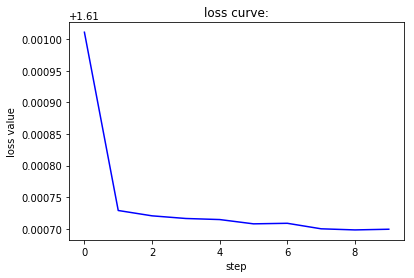

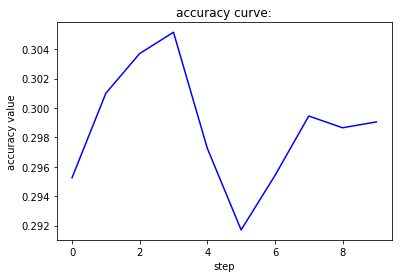

In [54]:
classifier_net = train(classifier_net, trainloader, df_train, device, lr, optimizer)

In [60]:
for parameters in classifier_net.parameters():
    print(parameters)

Parameter containing:
tensor([[-0.3574, -0.6545, -0.6100,  ..., -0.4404, -0.5575, -0.5853],
        [-0.5219, -0.3637, -0.6106,  ..., -0.6108, -0.6863, -0.4711],
        [-0.6223, -0.5310, -0.4871,  ..., -0.5467, -0.4555, -0.4192],
        ...,
        [-0.8006, -0.6071, -0.5944,  ..., -0.6193, -0.5181, -0.4576],
        [-0.5060, -0.7041, -0.7436,  ..., -0.4418, -0.6517, -0.6329],
        [-0.4919, -0.6297, -0.6702,  ..., -0.5448, -0.5800, -0.6554]],
       device='cuda:0', requires_grad=True)
Parameter containing:
tensor([-0.5513, -0.5248, -0.7560, -0.7356, -0.7909, -0.6806, -0.8225, -0.5897,
        -0.7311, -0.5106, -0.6309, -0.5120, -0.8615, -0.7562, -0.7832, -0.5334,
        -0.6108, -0.5723, -0.5278, -0.7827, -0.7936, -0.7378, -0.7447, -0.5563,
        -0.7947, -0.7492, -0.5666, -0.4840, -0.5301, -0.7228, -0.5533, -0.4620,
        -0.7195, -0.6769, -0.6868, -0.5166, -0.7448, -0.5902, -0.5947, -0.7817,
        -0.5918, -0.4671, -0.5231, -0.7449, -0.7588, -0.6344, -0.6841, -0.6849

In [47]:
torch.save(classifier_net, './rnn.pt')